<a href="https://colab.research.google.com/github/GabrielVillagran/NonLinearDataCodes/blob/fourier/Fourier_VillagranSaucedoGabriel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Homework: linear, polynomial and splines regression on nonlinear data
Villagran Saucedo Gabriel Aldair 

Undergraduate, 2017 generation, 267572, 201702370947

Dr. Cuevas Tello Juan Carlos

Aprendizaje Automatico (Machine Learning) 

14/02/2022                                     

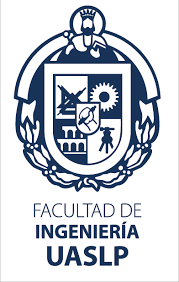

# Abstract
In this homework we are going to compare the different regressions using the nonlinear data, the regressions that were calculated was

- Polynomial
- Splines
- Linear
- Fourier

The code was developed in python using a jupyter notebook, the regressions are calculated for the first 100 levels, plotting the best one which was calculated based on the MSE.
# Introduction
In this code I'm going to show you yhe way that I used to calculate the Fourier Regression using the nonlinear data provided by the teacher.
The codes of the other regressions can be found here:

https://github.com/GabrielVillagran/NonLinearDataCodes


# Fourier Regression

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
DS-5-1-G-0-N-0_error_bars_0-106.eps    DS-5-1-GAP-1-1-N-1_v2.dat
DS-5-1-G-5-1-N-0_error_bars_0-466.eps  DS-5-1-GAP-5-1-N-3_v2.csv
DS-5-1-GAP-0-1-N-0_v2.csv	       DS-5-1-GAP-5-1-N-3_v2.dat
DS-5-1-GAP-0-1-N-0_v2.dat	       underlying_DS-5-1.jpg
DS-5-1-GAP-1-1-N-1_v2.csv


Text(0.5, 1.0, 'dataset: /content/drive/MyDrive/Colab Notebooks/MachineLearning/ArtificialData/')

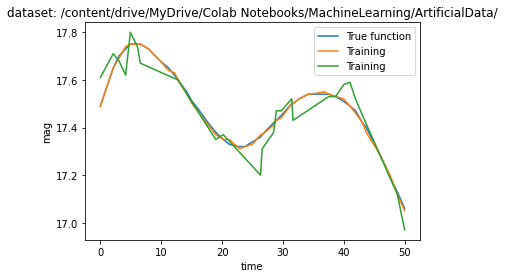

In [157]:
#Loading data from Drive
from google.colab import  drive
drive.mount('/content/drive/')
!ls "/content/drive/MyDrive/Colab Notebooks/MachineLearning/ArtificialData"

import pandas as pd
import matplotlib.pyplot as plt

DATA_PATH = '/content/drive/MyDrive/Colab Notebooks/MachineLearning/ArtificialData/'
FILE1_csv = 'DS-5-1-GAP-0-1-N-0_v2.csv'
FILE2_csv = 'DS-5-1-GAP-1-1-N-1_v2.csv'
FILE3_csv= 'DS-5-1-GAP-5-1-N-3_v2.csv'
#Saving the FILE1 into d variable
d1 = pd.read_csv(DATA_PATH + FILE1_csv, header=None) #Truth
d2 = pd.read_csv(DATA_PATH + FILE2_csv, header=None) #Noise1
d3 = pd.read_csv(DATA_PATH + FILE3_csv, header=None) #Noise2
#plotting the datasets
plt.plot(d1[0], d1[1], label="True function")
plt.plot(d2[0], d2[1], label="Training")
plt.plot(d3[0], d3[1], label="Training")
plt.xlabel("time")
plt.ylabel("mag")
plt.legend(loc="best")
plt.title("dataset: "+ DATA_PATH)

#Fourier Regression function 
Here I'm going to show you the way that I calculated the Fourier regression, I'm using the symfit packages wich help us to calculate the regression

In [158]:
%pip install symfit
# Importing the libraries that are necessaries
#Metrics
from sklearn.metrics import mean_squared_error
#Polynomial interpolation
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
import numpy as np
from symfit import parameters, variables, sin, cos, Fit
import numpy as np
import matplotlib.pyplot as plt

# Performing regression
def fourier_series(x, f, n=0):
    """
    Returns a symbolic fourier series of order `n`.

    :param n: Order of the fourier series.
    :param x: Independent variable
    :param f: Frequency of the fourier series
    """
    # Make the parameter objects for all the terms
    a0, *cos_a = parameters(','.join(['a{}'.format(i) for i in range(0, n + 1)]))
    sin_b = parameters(','.join(['b{}'.format(i) for i in range(1, n + 1)]))
    # Construct the series
    series = a0 + sum(ai * cos(i * f * x) + bi * sin(i * f * x)
                     for i, (ai, bi) in enumerate(zip(cos_a, sin_b), start=1))
    return series





#Noise data 1
In this block of code you can find how I train and plot the model that is calculated, I'm using a for instruction to calculate each regression.

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.652518e-14 9.491410e-16
a1        -2.319121e-14 1.328963e-15
a2        9.846564e-15 1.328627e-15
a3        1.982785e-14 1.341520e-15
b1        2.676585e-14 1.357591e-15
b2        -3.749932e-14 1.356291e-15
b3        -2.028169e-14 1.365658e-15
w         1.378691e+00 2.749146e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef4d3f90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef251e250>

Goodness of fit qualifiers:
chi_squared            4.535670071803871e-24
objective_value        2.2678350359019357e-24
r_squared              -inf


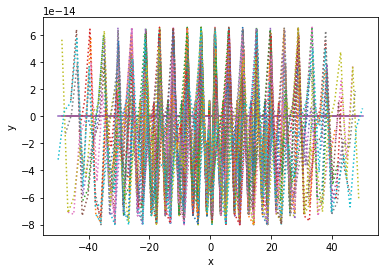

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.461663e-14 3.250089e-15
a1        1.285784e-13 4.634152e-15
a2        -1.326158e-13 4.733748e-15
a3        8.583626e-14 4.622230e-15
b1        -2.123314e-14 4.567160e-15
b2        5.077841e-15 4.504739e-15
b3        -7.093216e-14 4.591197e-15
w         2.085699e+00 2.398833e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef5a1310>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef749b50>

Goodness of fit qualifiers:
chi_squared            5.320726347126135e-23
objective_value        2.6603631735630674e-23
r_squared              -inf


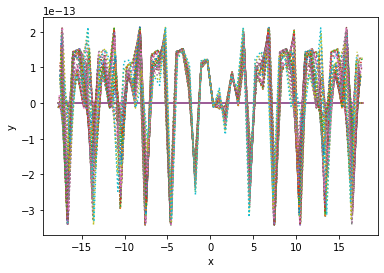

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -8.587626e-15 3.123004e-16
a1        1.239796e-14 4.401589e-16
a2        7.407358e-15 4.347439e-16
a3        7.976276e-15 4.416497e-16
b1        3.355801e-16 4.400360e-16
b2        2.626381e-15 4.493630e-16
b3        1.703226e-15 4.431349e-16
w         2.050261e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef3fcdd0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef118490>

Goodness of fit qualifiers:
chi_squared            4.931984105259354e-25
objective_value        2.465992052629677e-25
r_squared              -inf


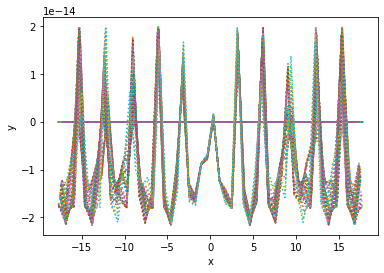

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.416023e-13 1.307369e-14
a1        -3.123699e-13 1.824156e-14
a2        4.492271e-13 1.866661e-14
a3        4.833688e-13 1.805751e-14
b1        3.702145e-13 1.836476e-14
b2        2.026296e-13 1.804316e-14
b3        -5.839637e-14 1.821396e-14
w         2.077977e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeeeb0450>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeee99f50>

Goodness of fit qualifiers:
chi_squared            8.63448859197477e-22
objective_value        4.317244295987385e-22
r_squared              -inf


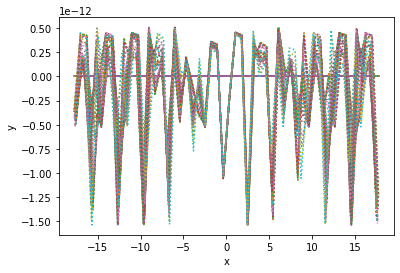

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        4.878516e-14 2.500635e-15
a1        6.412092e-14 3.512799e-15
a2        -6.322827e-14 3.548650e-15
a3        -5.156594e-14 3.424119e-15
b1        4.567938e-14 3.418153e-15
b2        -8.551362e-14 3.442870e-15
b3        -5.329207e-14 3.505145e-15
w         2.074037e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeef0aed0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef4fbcf90>

Goodness of fit qualifiers:
chi_squared            3.163314417136277e-23
objective_value        1.5816572085681385e-23
r_squared              -inf


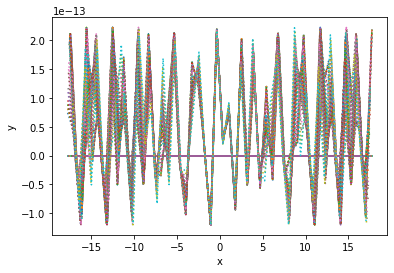

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.534691e-14 1.395878e-15
a1        -5.772250e-14 2.020021e-15
a2        6.082798e-14 2.279705e-15
a3        -1.752967e-14 2.326865e-15
b1        1.470856e-14 1.978229e-15
b2        -1.121308e-14 1.951611e-15
b3        2.180224e-14 1.986225e-15
w         2.075869e+00 6.959318e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeff35890>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefc12590>

Goodness of fit qualifiers:
chi_squared            9.794363543635248e-24
objective_value        4.897181771817624e-24
r_squared              -inf


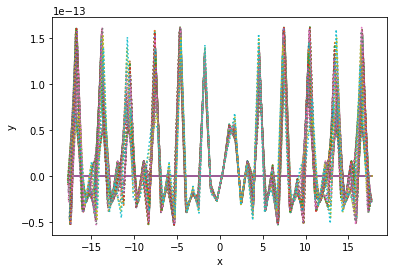

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        6.906094e-14 3.024414e-15
a1        6.287109e-14 4.253194e-15
a2        -2.660796e-14 4.332971e-15
a3        -6.579001e-14 4.227811e-15
b1        5.139282e-14 4.098873e-15
b2        -1.080297e-13 4.169678e-15
b3        -8.895156e-14 4.247585e-15
w         2.075572e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef02fa790>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef2663290>

Goodness of fit qualifiers:
chi_squared            4.621901856293833e-23
objective_value        2.3109509281469164e-23
r_squared              -inf


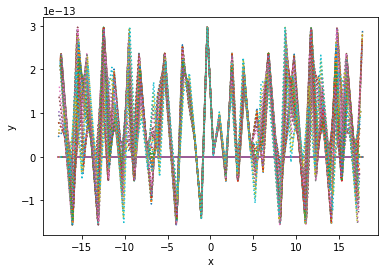

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        5.085025e-15 1.094401e-15
a1        3.321792e-14 1.539197e-15
a2        -2.472895e-14 1.574161e-15
a3        -4.764947e-14 1.531975e-15
b1        1.976368e-14 1.537524e-15
b2        -2.499165e-14 1.521752e-15
b3        1.274228e-14 1.541502e-15
w         2.078251e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef661a50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef769a50>

Goodness of fit qualifiers:
chi_squared            6.0518839186027144e-24
objective_value        3.0259419593013572e-24
r_squared              -inf


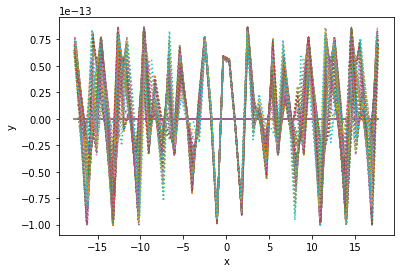

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.581309e-14 6.751312e-15
a1        -2.082644e-13 9.662046e-15
a2        3.833256e-13 1.036530e-14
a3        -7.039798e-14 1.005880e-14
b1        2.798546e-14 9.487647e-15
b2        -2.235672e-14 9.414150e-15
b3        7.120971e-14 9.534022e-15
w         2.077402e+00 3.963054e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef4893a50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefff6610>

Goodness of fit qualifiers:
chi_squared            2.2958024260626265e-22
objective_value        1.1479012130313132e-22
r_squared              -inf


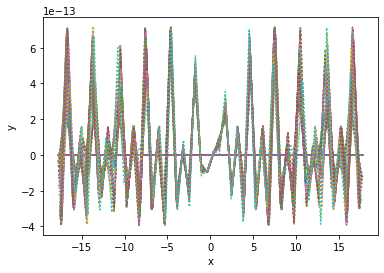

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.770640e-14 1.666457e-15
a1        7.013294e-14 2.372982e-15
a2        5.516714e-15 2.401330e-15
a3        -2.481738e-14 2.340014e-15
b1        5.189565e-14 2.342738e-15
b2        -5.551405e-14 2.312213e-15
b3        1.701300e-14 2.332220e-15
w         2.079665e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0530e50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeffd6bd0>

Goodness of fit qualifiers:
chi_squared            1.4044173740425568e-23
objective_value        7.022086870212784e-24
r_squared              -inf


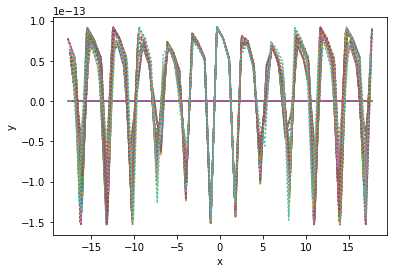

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.287617e-14 1.358063e-15
a1        -3.286034e-14 1.930404e-15
a2        -1.791660e-14 1.890466e-15
a3        -3.592222e-15 1.917412e-15
b1        -6.276212e-14 1.908857e-15
b2        -1.291819e-14 1.950599e-15
b3        4.602907e-14 1.923347e-15
w         2.048079e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0530bd0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef6648d0>

Goodness of fit qualifiers:
chi_squared            9.288468960003721e-24
objective_value        4.644234480001861e-24
r_squared              -inf


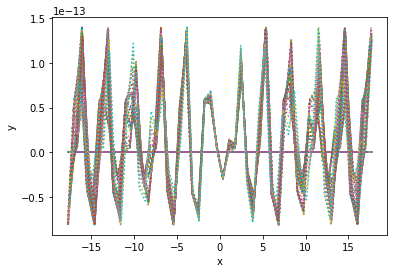

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.669200e-13 6.702388e-15
a1        1.003164e-14 9.908883e-15
a2        -5.232421e-14 9.393303e-15
a3        -1.823927e-13 9.497810e-15
b1        1.132076e-13 1.012904e-14
b2        2.925003e-13 1.138946e-14
b3        1.038488e-13 9.763580e-15
w         2.064594e+00 7.017870e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef123490>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef1abd10>

Goodness of fit qualifiers:
chi_squared            2.2142277614630697e-22
objective_value        1.1071138807315348e-22
r_squared              -inf


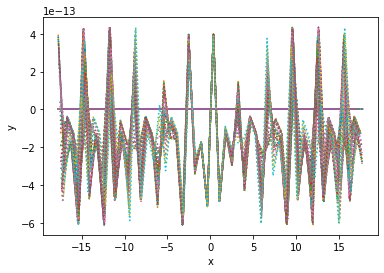

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.578811e-14 1.836525e-15
a1        -1.001726e-13 3.837159e-15
a2        1.198304e-13 4.952367e-15
a3        -9.235651e-14 3.850611e-15
b1        -9.890782e-14 3.753007e-15
b2        -1.350657e-14 1.990982e-15
b3        7.934504e-14 3.754712e-15
w         2.195995e+00 6.567538e-04
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeef15650>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef0bbed0>

Goodness of fit qualifiers:
chi_squared            1.6980334196709362e-23
objective_value        8.490167098354681e-24
r_squared              -inf


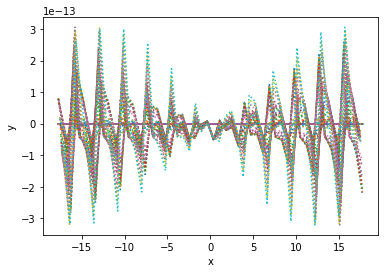

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        5.799461e-16 1.468398e-16
a1        1.969019e-15 2.093207e-16
a2        -7.496041e-15 1.974439e-16
a3        6.671964e-16 2.060044e-16
b1        -6.152941e-16 2.033309e-16
b2        -2.185873e-15 2.083177e-16
b3        5.301453e-15 2.077117e-16
w         2.061962e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeecdd450>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeecdddd0>

Goodness of fit qualifiers:
chi_squared            1.0874902716800843e-25
objective_value        5.437451358400422e-26
r_squared              -inf


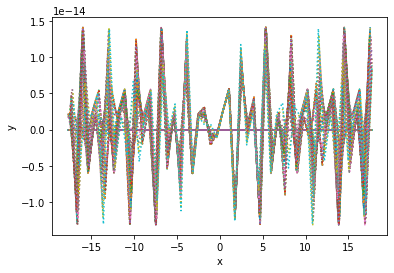

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.192832e-14 6.542716e-16
a1        2.265472e-15 9.321022e-16
a2        -2.764144e-15 9.176282e-16
a3        -3.397013e-15 9.252846e-16
b1        1.397510e-14 9.212778e-16
b2        -2.606656e-14 9.357919e-16
b3        2.700172e-14 9.267944e-16
w         2.058815e+00 2.541142e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef89f550>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeebccc10>

Goodness of fit qualifiers:
chi_squared            2.1554573487555734e-24
objective_value        1.0777286743777867e-24
r_squared              -inf


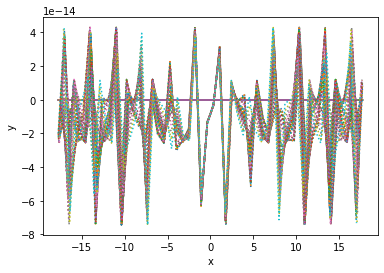

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.182995e-13 2.035133e-14
a1        -5.187078e-13 2.887971e-14
a2        -2.102163e-13 2.926983e-14
a3        3.396023e-14 2.881403e-14
b1        5.348770e-13 3.000987e-14
b2        6.184710e-13 2.973330e-14
b3        -8.625522e-13 2.950011e-14
w         2.082475e+00 7.767281e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef1cdb7d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee9f8390>

Goodness of fit qualifiers:
chi_squared            2.0649906754429446e-21
objective_value        1.0324953377214723e-21
r_squared              -inf


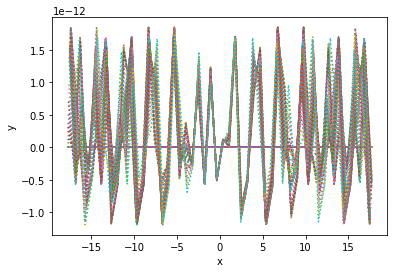

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        8.565937e-16 1.631917e-15
a1        5.314450e-14 2.314654e-15
a2        9.400207e-15 2.351769e-15
a3        1.303638e-14 2.303483e-15
b1        8.477731e-14 2.297293e-15
b2        -3.888265e-14 2.247753e-15
b3        -9.516817e-16 2.414262e-15
w         2.084651e+00 6.800103e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeeba9290>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee84f810>

Goodness of fit qualifiers:
chi_squared            1.325765959042185e-23
objective_value        6.628829795210925e-24
r_squared              -inf


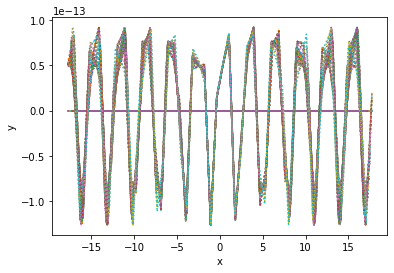

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        8.041613e-14 8.433333e-15
a1        -2.417976e-13 1.202272e-14
a2        -3.342024e-14 1.217314e-14
a3        3.742748e-13 1.194763e-14
b1        -9.587807e-14 1.185041e-14
b2        -2.850463e-13 1.167622e-14
b3        -6.275339e-14 1.192253e-14
w         2.087658e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef29d8d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef0b26d0>

Goodness of fit qualifiers:
chi_squared            3.584665830421102e-22
objective_value        1.792332915210551e-22
r_squared              -inf


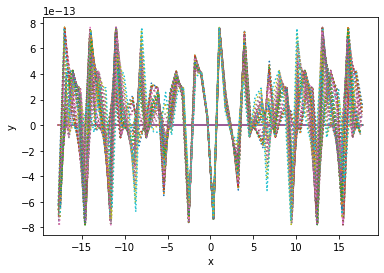

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        9.989227e-15 8.387538e-16
a1        8.041790e-15 1.196678e-15
a2        -2.333687e-15 1.211512e-15
a3        -1.266372e-15 1.188720e-15
b1        -1.768500e-14 1.200975e-15
b2        -1.125719e-14 1.166265e-15
b3        4.956144e-14 1.191050e-15
w         2.084541e+00 3.750062e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefdcef50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefdcead0>

Goodness of fit qualifiers:
chi_squared            3.543719702390506e-24
objective_value        1.771859851195253e-24
r_squared              -inf


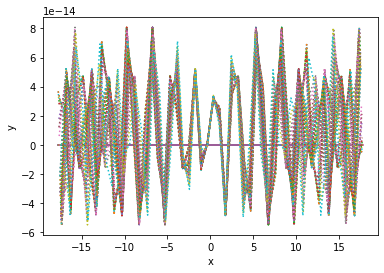

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.345311e-14 1.474943e-14
a1        3.893384e-13 2.096705e-14
a2        -2.771527e-13 2.118597e-14
a3        1.002055e-13 2.097541e-14
b1        5.201261e-13 2.089021e-14
b2        -5.191125e-14 2.054650e-14
b3        -6.898089e-13 2.095963e-14
w         2.098195e+00 2.164870e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefc26f90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef18688d0>

Goodness of fit qualifiers:
chi_squared            1.0965392689609704e-21
objective_value        5.482696344804852e-22
r_squared              -inf


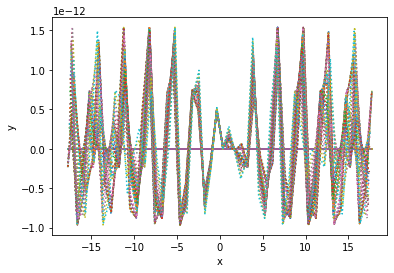

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.277182e-14 1.362423e-15
a1        7.603839e-14 1.945076e-15
a2        -5.519229e-15 1.985645e-15
a3        1.626259e-14 1.965920e-15
b1        8.278245e-16 1.900149e-15
b2        3.219922e-14 1.874609e-15
b3        -2.958308e-14 1.910362e-15
w         2.091973e+00 4.514005e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef82dad0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef82d950>

Goodness of fit qualifiers:
chi_squared            9.185612552765935e-24
objective_value        4.592806276382967e-24
r_squared              -inf


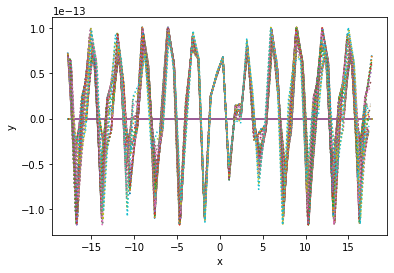

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -6.731382e-14 2.593021e-15
a1        -3.206339e-15 3.731312e-15
a2        -1.706322e-14 3.743772e-15
a3        5.049679e-14 3.674111e-15
b1        1.239186e-13 3.674948e-15
b2        -1.112969e-14 3.602974e-15
b3        -5.182894e-14 3.763160e-15
w         2.082963e+00 4.219396e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef62f750>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeffa7d10>

Goodness of fit qualifiers:
chi_squared            3.3865006395649997e-23
objective_value        1.6932503197824998e-23
r_squared              -inf


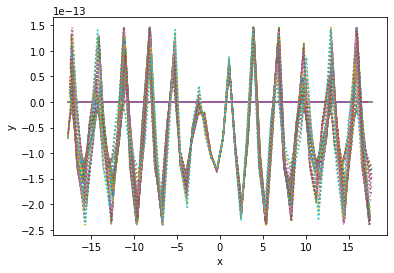

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.840297e-13 1.683320e-14
a1        2.410222e-13 2.405354e-14
a2        -8.371762e-13 2.510274e-14
a3        2.799561e-13 2.426040e-14
b1        -4.083177e-14 2.371276e-14
b2        -5.829257e-13 2.354862e-14
b3        -1.530439e-13 2.376705e-14
w         2.082727e+00 4.071436e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef50dc10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef096bd0>

Goodness of fit qualifiers:
chi_squared            1.4263012510978521e-21
objective_value        7.131506255489261e-22
r_squared              -inf


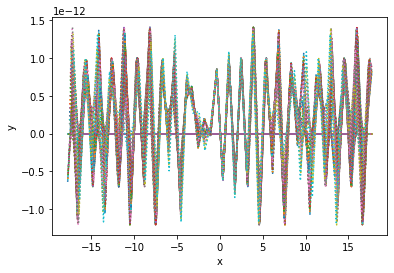

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.064502e-15 1.211727e-15
a1        -7.002576e-15 2.599601e-15
a2        3.213649e-14 4.962362e-15
a3        4.403232e-15 1.912328e-15
b1        -3.730927e-14 2.356906e-15
b2        3.884394e-14 5.347259e-15
b3        1.705939e-14 6.771147e-15
w         2.107660e+00 4.058972e-02
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef776990>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef776c50>

Goodness of fit qualifiers:
chi_squared            4.838009470362059e-24
objective_value        2.4190047351810294e-24
r_squared              -inf


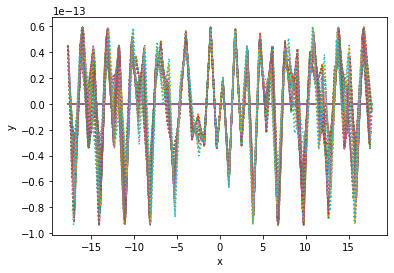

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        7.695697e-14 5.600050e-15
a1        2.119019e-13 1.146305e-14
a2        -2.591306e-13 1.499518e-14
a3        3.694969e-13 1.146843e-14
b1        -1.455066e-13 1.128502e-14
b2        -9.119471e-14 6.045679e-15
b3        -3.629227e-14 1.128944e-14
w         2.204228e+00 8.605620e-04
Status message         Optimization terminated successfully.
Number of iterations   26
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef870d90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef1d0290>

Goodness of fit qualifiers:
chi_squared            1.5787658960645092e-22
objective_value        7.893829480322546e-23
r_squared              -inf


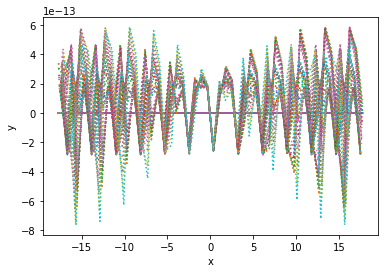

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.362687e-14 2.085057e-15
a1        -6.251864e-14 2.980756e-15
a2        1.085239e-13 3.091866e-15
a3        -3.873370e-14 3.017124e-15
b1        -2.372981e-14 2.930245e-15
b2        -2.192256e-14 2.902398e-15
b3        3.169188e-14 2.947302e-15
w         2.080458e+00 2.894069e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef2adfe90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef45d210>

Goodness of fit qualifiers:
chi_squared            2.189919537984485e-23
objective_value        1.0949597689922426e-23
r_squared              -inf


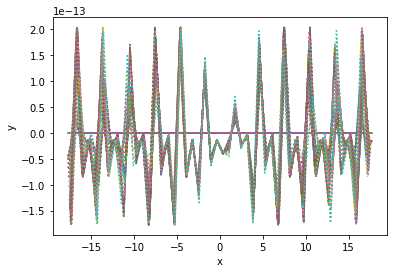

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        4.578101e-14 1.520663e-15
a1        -2.899308e-14 2.156996e-15
a2        -2.283068e-14 2.141467e-15
a3        4.471234e-15 2.139308e-15
b1        -1.168706e-14 2.146162e-15
b2        6.687132e-14 1.917314e-15
b3        -1.313375e-14 2.127054e-15
w         2.107079e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef192a10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef007190>

Goodness of fit qualifiers:
chi_squared            1.1702130454974408e-23
objective_value        5.851065227487204e-24
r_squared              -inf


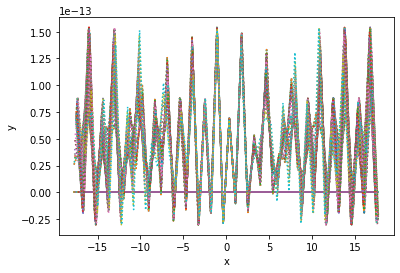

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.455163e-14 7.552075e-16
a1        1.833463e-14 1.079045e-15
a2        -3.136302e-14 1.091610e-15
a3        -7.015812e-15 1.077755e-15
b1        2.439025e-14 1.062907e-15
b2        -8.865700e-15 1.046217e-15
b3        -1.068594e-14 1.070583e-15
w         2.085904e+00 3.118552e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef473350>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeec97810>

Goodness of fit qualifiers:
chi_squared            2.873289725823725e-24
objective_value        1.4366448629118625e-24
r_squared              -inf


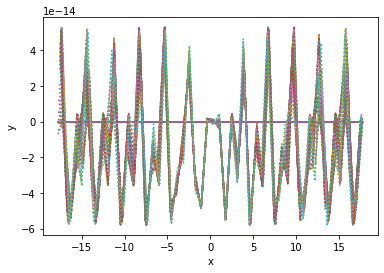

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.487890e-14 1.416970e-15
a1        -3.358603e-14 2.038623e-15
a2        -2.740272e-14 1.401005e-15
a3        2.172677e-15 1.460809e-15
b1        4.367335e-14 nan
b2        7.099541e-15 2.046912e-15
b3        7.301218e-14 1.324579e-15
w         2.112743e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeedd8650>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeedd8a90>

Goodness of fit qualifiers:
chi_squared            1.0673156955610388e-23
objective_value        5.336578477805194e-24
r_squared              -inf


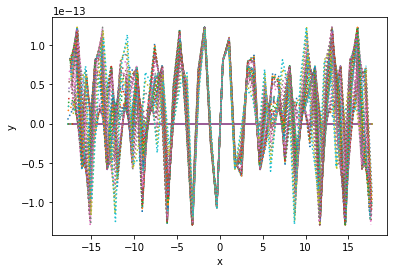

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.398545e-14 1.408479e-15
a1        5.276841e-14 1.979693e-15
a2        -3.256692e-14 1.990104e-15
a3        -2.160584e-14 1.783147e-15
b1        -7.288807e-15 1.981162e-15
b2        -5.032133e-14 1.862529e-15
b3        2.888860e-14 1.999586e-15
w         2.070625e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeedeb610>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeafd250>

Goodness of fit qualifiers:
chi_squared            1.0116657017611075e-23
objective_value        5.058328508805538e-24
r_squared              -inf


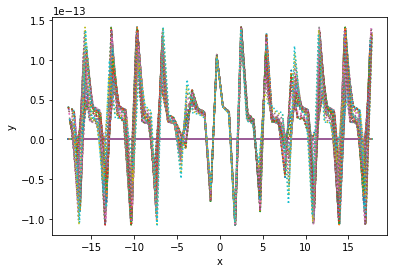

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.597704e-14 4.240731e-15
a1        1.450041e-14 5.891971e-15
a2        1.603142e-15 5.990641e-15
a3        -9.255512e-14 5.961921e-15
b1        -1.367718e-13 5.383095e-15
b2        -9.052175e-14 5.954683e-15
b3        -1.843702e-13 5.850996e-15
w         2.108571e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee765a90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef2587290>

Goodness of fit qualifiers:
chi_squared            9.096460825920241e-23
objective_value        4.5482304129601205e-23
r_squared              -inf


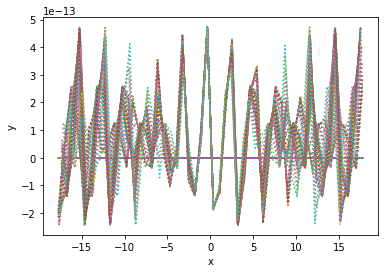

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -4.778191e-15 6.890761e-16
a1        1.945518e-14 9.779176e-16
a2        4.998892e-15 9.819304e-16
a3        -1.285750e-14 9.637560e-16
b1        -2.955368e-14 9.633749e-16
b2        -2.020332e-14 9.010946e-16
b3        1.461755e-14 9.120827e-16
w         2.073888e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   18
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef259c210>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef638310>

Goodness of fit qualifiers:
chi_squared            2.409857063916609e-24
objective_value        1.2049285319583045e-24
r_squared              -inf


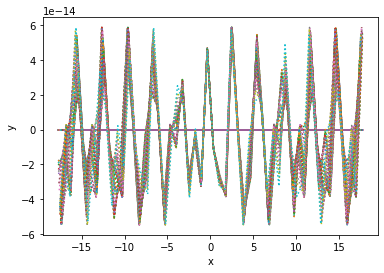

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.243200e-14 1.259040e-15
a1        2.452683e-14 1.790002e-15
a2        5.563885e-14 1.847910e-15
a3        -3.533964e-14 1.814568e-15
b1        -9.656933e-15 1.769598e-15
b2        -1.483514e-14 1.741090e-15
b3        -3.003244e-14 1.776423e-15
w         2.093839e+00 4.115641e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef29d9310>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef084db10>

Goodness of fit qualifiers:
chi_squared            7.94233031312884e-24
objective_value        3.97116515656442e-24
r_squared              -inf


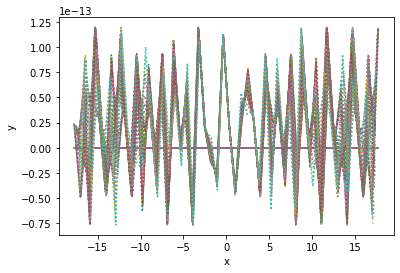

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.761844e-14 6.119387e-15
a1        9.028767e-14 8.752487e-15
a2        -1.087248e-13 8.640247e-15
a3        2.575268e-13 8.676333e-15
b1        1.794606e-13 8.646249e-15
b2        2.224287e-13 8.884319e-15
b3        3.978737e-14 8.876205e-15
w         2.026404e+00 3.908993e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0824850>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef21dc650>

Goodness of fit qualifiers:
chi_squared            1.8823236786943842e-22
objective_value        9.411618393471921e-23
r_squared              -inf


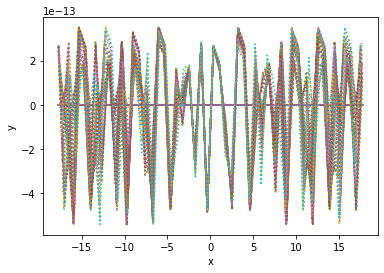

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.095333e-14 8.037364e-16
a1        -9.859506e-15 1.145357e-15
a2        -6.203391e-15 1.128096e-15
a3        9.290727e-15 1.137183e-15
b1        -4.685752e-14 1.128356e-15
b2        -1.229880e-14 1.096456e-15
b3        6.917677e-15 1.044351e-15
w         2.060427e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   18
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef274e50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef274810>

Goodness of fit qualifiers:
chi_squared            3.260750030231835e-24
objective_value        1.6303750151159176e-24
r_squared              -inf


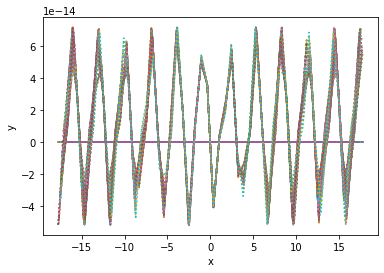

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.330822e-15 1.652267e-15
a1        -5.567944e-14 3.414446e-15
a2        8.244643e-14 4.447944e-15
a3        -1.212422e-13 3.410833e-15
b1        -4.782212e-14 3.344154e-15
b2        2.717669e-14 1.782879e-15
b3        1.340300e-14 3.346491e-15
w         2.204790e+00 8.051720e-04
Status message         Optimization terminated successfully.
Number of iterations   26
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef533c10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef28e2c50>

Goodness of fit qualifiers:
chi_squared            1.374295933213148e-23
objective_value        6.87147966606574e-24
r_squared              -inf


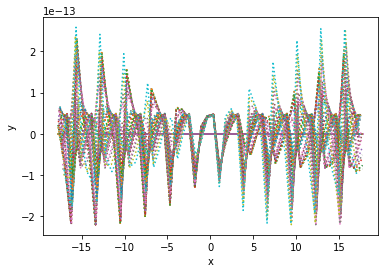

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        9.388010e-14 6.741143e-15
a1        1.676157e-13 8.244578e-15
a2        1.107094e-13 9.330481e-15
a3        -3.461687e-13 9.455104e-15
b1        -1.148078e-13 9.635715e-15
b2        -1.447241e-13 9.348339e-15
b3        -4.685880e-15 9.581023e-15
w         2.066242e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef1b42750>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeff3190>

Goodness of fit qualifiers:
chi_squared            2.398283176612582e-22
objective_value        1.199141588306291e-22
r_squared              -inf


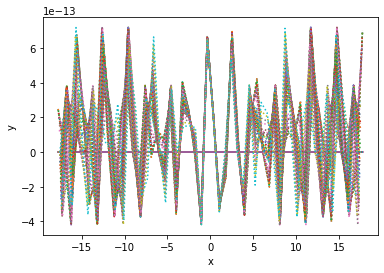

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.523704e-14 1.445878e-15
a1        -1.309081e-15 2.475614e-15
a2        2.041939e-14 3.113064e-15
a3        -1.529093e-14 2.509968e-15
b1        6.268916e-14 nan
b2        -4.753320e-14 1.534094e-15
b3        -8.807202e-14 nan
w         2.185017e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   23
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef330b10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef6aed50>

Goodness of fit qualifiers:
chi_squared            1.0528109871425326e-23
objective_value        5.264054935712663e-24
r_squared              -inf


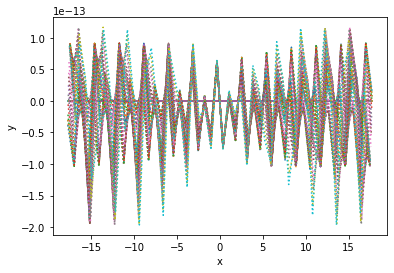

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.449494e-14 1.118507e-15
a1        -4.766078e-14 1.362096e-15
a2        -2.112065e-15 1.596733e-15
a3        1.617989e-14 nan
b1        -2.767692e-14 nan
b2        -1.885692e-14 nan
b3        -4.546730e-14 nan
w         2.065486e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef649890>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef522790>

Goodness of fit qualifiers:
chi_squared            7.595480010295177e-24
objective_value        3.797740005147589e-24
r_squared              -inf


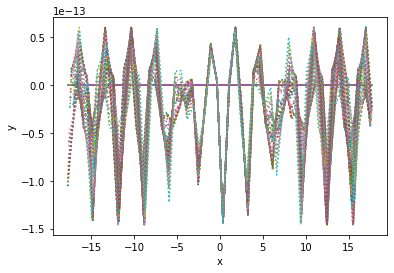

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.517876e-13 1.140607e-14
a1        4.874880e-13 1.632799e-14
a2        2.080614e-13 1.653934e-14
a3        -3.296833e-14 1.623093e-14
b1        1.342412e-13 1.605877e-14
b2        -3.048567e-13 1.584897e-14
b3        3.759420e-13 1.618224e-14
w         2.085140e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef347490>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeb57c50>

Goodness of fit qualifiers:
chi_squared            6.61299104453099e-22
objective_value        3.306495522265495e-22
r_squared              -inf


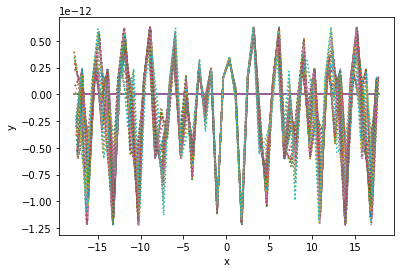

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -3.837670e-16 3.810033e-16
a1        -1.197921e-14 5.438840e-16
a2        -1.657857e-14 5.516213e-16
a3        -7.846872e-15 5.396677e-16
b1        3.103718e-15 5.347533e-16
b2        -1.376720e-14 5.350469e-16
b3        1.494825e-16 5.382135e-16
w         2.078339e+00 2.943201e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef3476d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef173f10>

Goodness of fit qualifiers:
chi_squared            7.299981721740592e-25
objective_value        3.649990860870296e-25
r_squared              -inf


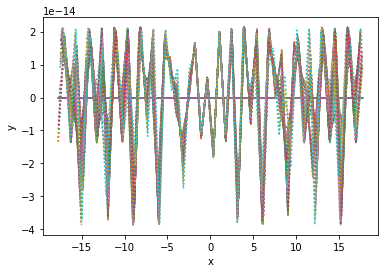

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -6.721443e-14 2.797565e-15
a1        -9.150860e-14 4.251005e-15
a2        4.582352e-14 4.097288e-15
a3        -1.224934e-13 4.420302e-15
b1        2.287000e-14 3.934926e-15
b2        9.256697e-15 3.930077e-15
b3        2.528374e-14 3.957133e-15
w         2.070518e+00 5.488114e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef1b42bd0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeed86050>

Goodness of fit qualifiers:
chi_squared            3.923793840522053e-23
objective_value        1.9618969202610266e-23
r_squared              -inf


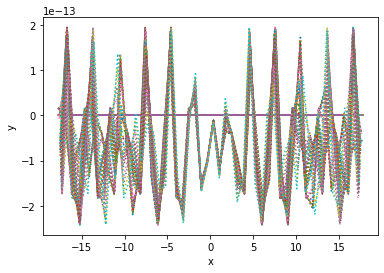

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.202047e-14 1.898957e-15
a1        2.796571e-14 3.592091e-15
a2        -2.051066e-14 2.485949e-15
a3        -8.494345e-14 2.698054e-15
b1        -2.735518e-14 2.790053e-15
b2        5.581503e-16 2.524818e-15
b3        -5.184435e-14 2.614305e-15
w         2.064327e+00 1.001376e-02
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee6fd450>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee6fd7d0>

Goodness of fit qualifiers:
chi_squared            1.5606441816986248e-23
objective_value        7.803220908493124e-24
r_squared              -inf


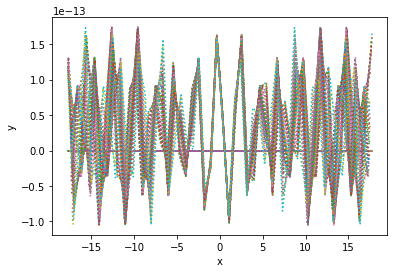

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -7.424090e-14 5.536687e-15
a1        1.661265e-13 7.946949e-15
a2        -1.812939e-13 8.066836e-15
a3        -5.078257e-14 7.908197e-15
b1        -1.886503e-13 7.839162e-15
b2        -6.371736e-14 7.767583e-15
b3        1.546590e-13 7.925412e-15
w         2.099347e+00 3.473141e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef6b6ed0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef6b6290>

Goodness of fit qualifiers:
chi_squared            1.544808760270667e-22
objective_value        7.724043801353335e-23
r_squared              -inf


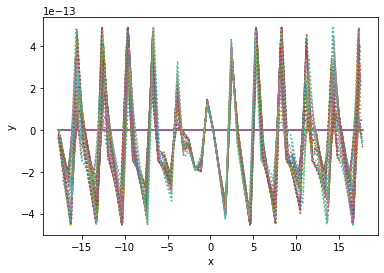

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.934835e-16 1.514568e-16
a1        -6.591791e-15 2.332199e-16
a2        -5.446806e-15 2.272909e-16
a3        -5.219549e-15 2.325782e-16
b1        1.329362e-15 2.132425e-16
b2        2.192020e-15 2.169514e-16
b3        9.158092e-16 2.144532e-16
w         2.066075e+00 5.240716e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef779e90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef779650>

Goodness of fit qualifiers:
chi_squared            1.148951357752671e-25
objective_value        5.744756788763355e-26
r_squared              -inf


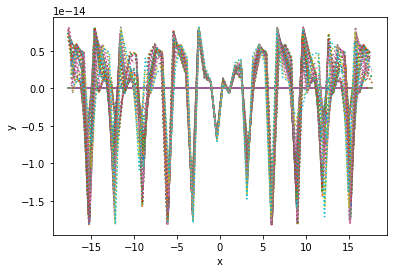

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -8.843718e-17 6.186610e-15
a1        1.857641e-13 8.665090e-15
a2        -2.970966e-13 8.185243e-15
a3        -1.160240e-13 8.401919e-15
b1        -1.713976e-13 8.748536e-15
b2        6.814172e-14 8.885088e-15
b3        5.353694e-14 8.640970e-15
w         2.063584e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef247ed0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef247250>

Goodness of fit qualifiers:
chi_squared            1.9770593058794525e-22
objective_value        9.885296529397262e-23
r_squared              -inf


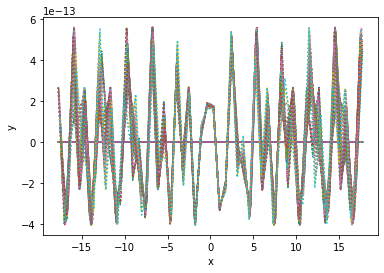

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -7.622355e-15 4.256577e-16
a1        4.927565e-15 5.323816e-16
a2        1.905314e-14 1.968586e-16
a3        3.940646e-15 6.076882e-16
b1        3.390874e-15 5.994522e-16
b2        -1.639189e-14 4.120983e-16
b3        4.609227e-15 6.058391e-16
w         2.063027e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef148b50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef187f9d0>

Goodness of fit qualifiers:
chi_squared            9.305148573832583e-25
objective_value        4.6525742869162915e-25
r_squared              -inf


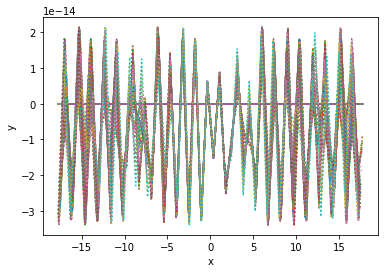

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.004274e-14 3.712726e-16
a1        5.153606e-15 5.448027e-16
a2        7.060620e-15 5.300068e-16
a3        1.269922e-14 5.333486e-16
b1        -5.170189e-15 5.341344e-16
b2        -1.172660e-14 5.460321e-16
b3        -6.136247e-15 5.277169e-16
w         2.071176e+00 4.760753e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefd28cd0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef148310>

Goodness of fit qualifiers:
chi_squared            6.9151981725073965e-25
objective_value        3.4575990862536982e-25
r_squared              -inf


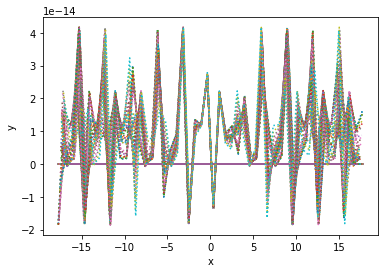

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.421483e-13 9.770997e-15
a1        -1.817685e-13 1.396798e-14
a2        -3.405579e-13 1.465414e-14
a3        -8.092726e-14 1.421444e-14
b1        -7.468945e-14 1.370317e-14
b2        -3.706636e-13 1.475084e-14
b3        1.601250e-13 1.384695e-14
w         2.066204e+00 4.967936e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef32d15d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef0044310>

Goodness of fit qualifiers:
chi_squared            4.806546564300818e-22
objective_value        2.403273282150409e-22
r_squared              -inf


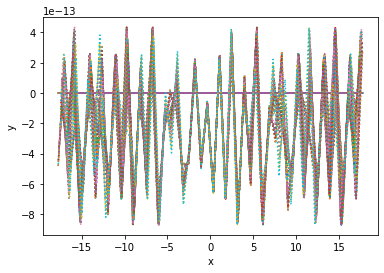

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        4.819627e-14 2.357157e-15
a1        3.227271e-14 3.450085e-15
a2        -4.705478e-16 3.310144e-15
a3        -7.022363e-14 3.357143e-15
b1        -7.238104e-14 3.308575e-15
b2        7.048894e-14 3.345466e-15
b3        -6.083292e-14 3.382724e-15
w         2.063444e+00 3.868642e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef476750>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef476450>

Goodness of fit qualifiers:
chi_squared            2.770234472104945e-23
objective_value        1.3851172360524726e-23
r_squared              -inf


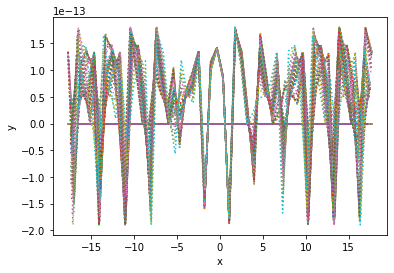

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -5.650929e-15 4.792872e-16
a1        -1.412233e-14 7.315158e-16
a2        -5.197619e-15 6.806613e-16
a3        1.748991e-14 7.051343e-16
b1        -1.948390e-15 6.924970e-16
b2        8.670676e-15 6.715622e-16
b3        -1.758444e-14 6.646453e-16
w         2.064596e+00 6.234812e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefa0f290>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef0157310>

Goodness of fit qualifiers:
chi_squared            1.1082317099264102e-24
objective_value        5.541158549632051e-25
r_squared              -inf


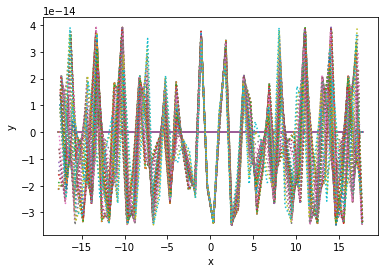

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.348302e-14 2.742193e-15
a1        -6.509300e-15 3.902124e-15
a2        5.654460e-14 3.951026e-15
a3        -5.513568e-14 3.877305e-15
b1        1.328998e-14 3.835530e-15
b2        1.077941e-13 3.775265e-15
b3        1.203345e-13 3.879768e-15
w         2.093375e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeef9b110>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeefa4c90>

Goodness of fit qualifiers:
chi_squared            3.7903639575914917e-23
objective_value        1.8951819787957458e-23
r_squared              -inf


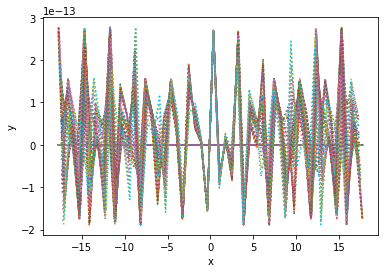

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.585338e-14 2.962895e-15
a1        4.584469e-14 3.750173e-15
a2        -1.114362e-13 3.276141e-15
a3        -3.532151e-14 3.160696e-15
b1        -1.391915e-14 3.969893e-15
b2        7.694326e-14 3.867093e-15
b3        -8.546085e-14 4.268956e-15
w         2.063585e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   18
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee6fdb10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeb38f10>

Goodness of fit qualifiers:
chi_squared            4.6403955350253315e-23
objective_value        2.3201977675126657e-23
r_squared              -inf


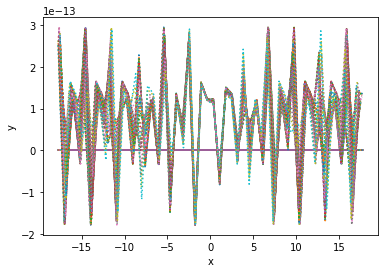

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.116149e-13 1.476596e-14
a1        -1.180782e-13 2.105558e-14
a2        -4.058618e-14 2.059987e-14
a3        -3.444398e-13 2.086431e-14
b1        -2.631423e-13 2.082640e-14
b2        8.622779e-13 2.125427e-14
b3        -9.433092e-14 2.091532e-14
w         2.052948e+00 2.814500e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee6fd650>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee976dd0>

Goodness of fit qualifiers:
chi_squared            1.0954770375186344e-21
objective_value        5.477385187593172e-22
r_squared              -inf


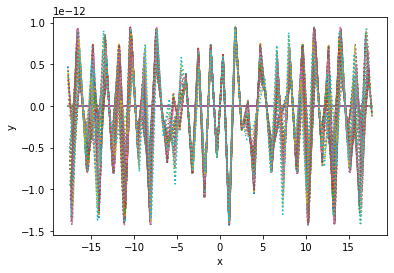

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.406382e-14 1.001388e-14
a1        -1.836051e-13 1.408146e-14
a2        2.331054e-13 1.435778e-14
a3        -2.405138e-13 1.410137e-14
b1        -9.554330e-14 1.763834e-14
b2        -9.582424e-14 1.471434e-14
b3        -5.209235e-13 1.428012e-14
w         2.019664e+00 8.102460e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee95a290>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeede8450>

Goodness of fit qualifiers:
chi_squared            4.942640591742954e-22
objective_value        2.471320295871477e-22
r_squared              -inf


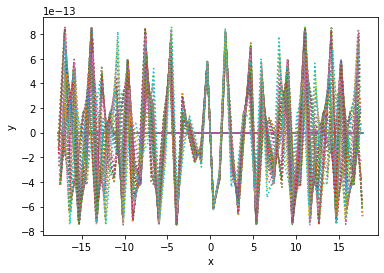

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.749724e-13 9.636967e-15
a1        -1.757230e-13 1.381107e-14
a2        2.879398e-13 1.396070e-14
a3        1.459919e-14 1.380950e-14
b1        1.827918e-13 1.372081e-14
b2        -2.720551e-13 1.340047e-14
b3        -2.142880e-13 1.371438e-14
w         2.082900e+00 4.455887e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee673d10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee673e10>

Goodness of fit qualifiers:
chi_squared            4.678593014042951e-22
objective_value        2.3392965070214753e-22
r_squared              -inf


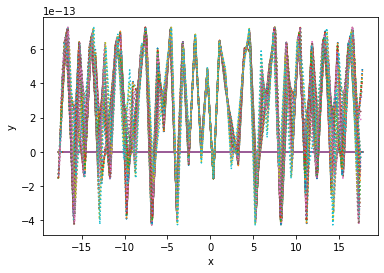

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.048533e-14 8.430082e-16
a1        -9.118803e-15 1.201651e-15
a2        5.823971e-15 1.165050e-15
a3        1.327969e-14 1.195130e-15
b1        4.456737e-14 1.216601e-15
b2        1.829130e-14 1.227955e-15
b3        2.162389e-14 1.219594e-15
w         2.120491e+00 2.450835e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeefb3550>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee9392d0>

Goodness of fit qualifiers:
chi_squared            3.582594144030816e-24
objective_value        1.791297072015408e-24
r_squared              -inf


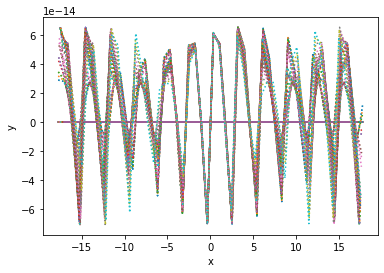

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.256385e-14 1.280411e-15
a1        4.432838e-14 1.821848e-15
a2        1.403747e-14 1.856277e-15
a3        4.430949e-14 1.810141e-15
b1        -1.680229e-14 1.794382e-15
b2        -5.014976e-14 1.777444e-15
b3        1.787834e-14 1.805882e-15
w         2.085169e+00 3.308478e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0339250>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefe56a10>

Goodness of fit qualifiers:
chi_squared            8.222686053354689e-24
objective_value        4.111343026677344e-24
r_squared              -inf


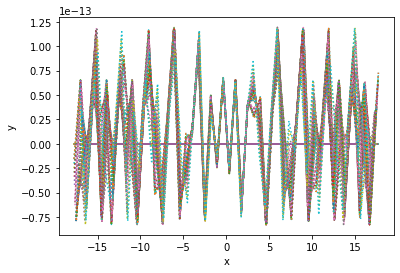

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.024323e-15 1.112147e-16
a1        -3.983061e-15 1.596318e-16
a2        -1.225089e-15 1.602193e-16
a3        -9.168161e-16 1.774264e-16
b1        -1.952399e-15 1.560070e-16
b2        -5.379447e-15 1.925791e-16
b3        1.803996e-15 1.617767e-16
w         2.066381e+00 6.904130e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee820210>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee8203d0>

Goodness of fit qualifiers:
chi_squared            6.223967858129293e-26
objective_value        3.1119839290646467e-26
r_squared              -inf


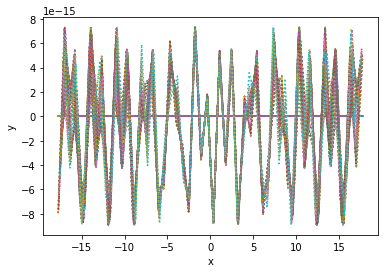

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.601499e-14 2.259925e-15
a1        -9.567086e-14 3.325950e-15
a2        9.882175e-14 3.733614e-15
a3        -4.858587e-14 3.795945e-15
b1        2.666143e-14 3.171385e-15
b2        1.338206e-14 3.177494e-15
b3        5.131277e-15 3.219969e-15
w         2.074677e+00 6.596566e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef2937310>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef029e390>

Goodness of fit qualifiers:
chi_squared            2.571053580984938e-23
objective_value        1.285526790492469e-23
r_squared              -inf


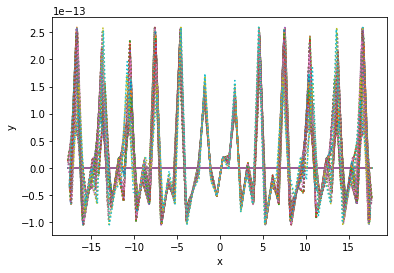

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -8.836525e-15 5.672828e-16
a1        -2.740754e-14 8.092624e-16
a2        1.337432e-14 8.298804e-16
a3        -9.870233e-15 8.336332e-16
b1        1.322643e-14 7.985841e-16
b2        -8.406263e-15 7.888671e-16
b3        -6.143574e-15 8.072667e-16
w         2.079053e+00 3.463611e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef1cfef50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef000b190>

Goodness of fit qualifiers:
chi_squared            1.6185236514381697e-24
objective_value        8.0926182571908485e-25
r_squared              -inf


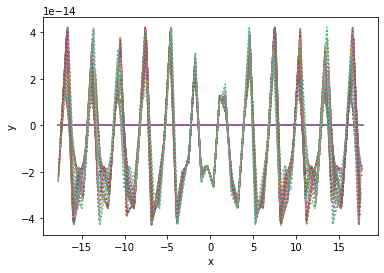

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.558997e-13 1.009738e-14
a1        -3.123732e-15 1.489084e-14
a2        4.554304e-13 1.542064e-14
a3        1.331472e-13 1.429290e-14
b1        3.988053e-13 1.414627e-14
b2        1.420214e-13 1.400029e-14
b3        5.391261e-14 1.443539e-14
w         2.098078e+00 4.404640e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef397150>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef81a210>

Goodness of fit qualifiers:
chi_squared            5.052387539989055e-22
objective_value        2.5261937699945273e-22
r_squared              -inf


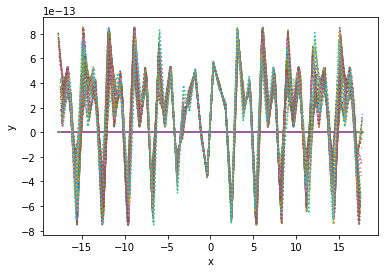

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.585328e-14 4.851700e-15
a1        -2.456027e-13 4.841475e-15
a2        4.252350e-14 7.097335e-15
a3        -1.808948e-13 3.292497e-15
b1        4.998011e-14 7.135070e-15
b2        1.114589e-13 6.500442e-15
b3        -4.141953e-14 7.155351e-15
w         2.110901e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef6ba750>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef6ba650>

Goodness of fit qualifiers:
chi_squared            1.293106463126858e-22
objective_value        6.46553231563429e-23
r_squared              -inf


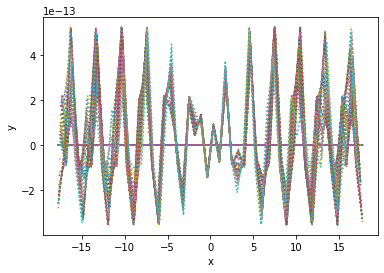

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -8.700679e-15 9.898837e-16
a1        1.083571e-14 1.410722e-15
a2        3.560952e-15 1.430348e-15
a3        -1.131215e-14 1.402275e-15
b1        4.390547e-14 1.394131e-15
b2        -5.991082e-15 1.371279e-15
b3        -4.589138e-14 1.401494e-15
w         2.088333e+00 2.204342e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef07ca90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeb6d590>

Goodness of fit qualifiers:
chi_squared            4.937252574383707e-24
objective_value        2.4686262871918533e-24
r_squared              -inf


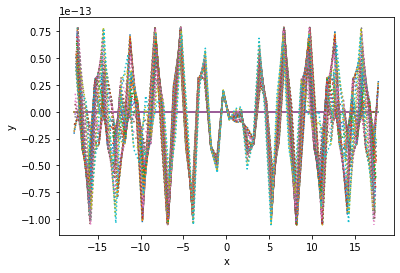

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        6.088829e-14 3.673438e-15
a1        4.136947e-14 5.247199e-15
a2        -1.711763e-13 5.477955e-15
a3        6.340481e-14 5.281593e-15
b1        -1.282081e-13 5.162756e-15
b2        3.262885e-14 5.107830e-15
b3        2.175888e-14 5.269220e-15
w         2.079555e+00 3.450133e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee7d8110>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee7d87d0>

Goodness of fit qualifiers:
chi_squared            6.793271704712326e-23
objective_value        3.396635852356163e-23
r_squared              -inf


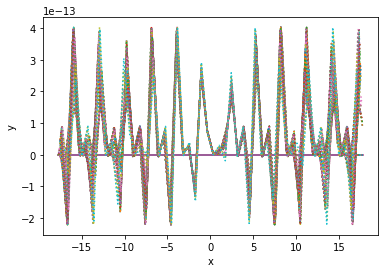

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        8.215032e-14 2.941021e-15
a1        1.196181e-13 4.047640e-15
a2        -4.058606e-14 4.094136e-15
a3        2.952852e-14 2.613365e-15
b1        3.874375e-14 3.879995e-15
b2        8.836415e-15 4.242990e-15
b3        8.463012e-14 4.146149e-15
w         2.116311e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeee29350>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeee29ed0>

Goodness of fit qualifiers:
chi_squared            4.4061530755505096e-23
objective_value        2.2030765377752548e-23
r_squared              -inf


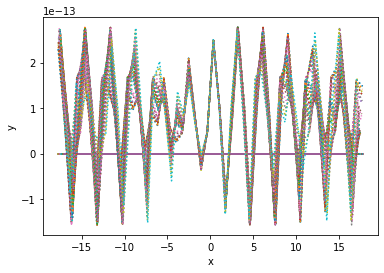

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.165719e-14 4.070591e-15
a1        -1.403619e-14 5.794090e-15
a2        -1.762546e-14 5.865583e-15
a3        -1.450425e-13 5.767250e-15
b1        -1.375695e-13 5.689245e-15
b2        -6.439815e-14 5.637267e-15
b3        -1.623429e-13 5.737691e-15
w         2.083727e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeefca450>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeefca2d0>

Goodness of fit qualifiers:
chi_squared            8.347981665232601e-23
objective_value        4.1739908326163005e-23
r_squared              -inf


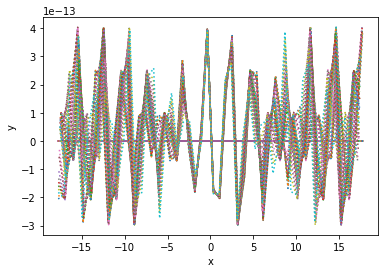

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.758283e-14 3.172910e-15
a1        3.881264e-14 4.490615e-15
a2        1.637841e-13 4.395800e-15
a3        1.154812e-13 4.499213e-15
b1        -2.434278e-15 4.494711e-15
b2        7.227060e-15 4.530598e-15
b3        -3.840508e-14 4.502755e-15
w         2.027767e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee81cd50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef2f1310>

Goodness of fit qualifiers:
chi_squared            5.1132435728608244e-23
objective_value        2.5566217864304122e-23
r_squared              -inf


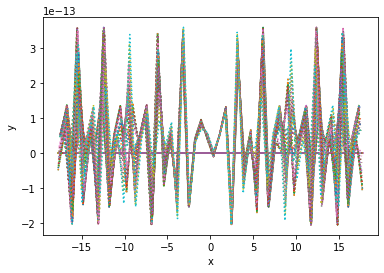

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.754898e-15 5.174290e-16
a1        -4.941628e-15 7.379461e-16
a2        -1.953221e-15 7.456437e-16
a3        3.163281e-15 7.332805e-16
b1        1.732580e-14 7.468485e-16
b2        -1.126526e-14 7.183829e-16
b3        -2.687430e-14 7.392137e-16
w         2.081762e+00 3.092908e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef413ed0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee5d5ad0>

Goodness of fit qualifiers:
chi_squared            1.3483688430563686e-24
objective_value        6.741844215281843e-25
r_squared              -inf


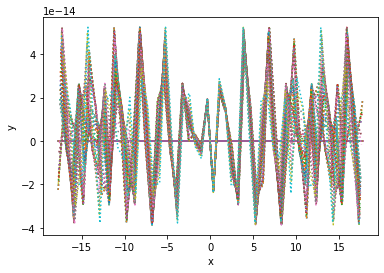

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.464334e-15 1.120245e-15
a1        3.974799e-14 1.641292e-15
a2        -1.992911e-14 1.561480e-15
a3        -4.474952e-14 1.604539e-15
b1        -6.599126e-15 1.565031e-15
b2        2.123946e-14 1.575989e-15
b3        -3.134062e-14 1.565086e-15
w         2.063360e+00 3.651297e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef798b10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef798210>

Goodness of fit qualifiers:
chi_squared            6.165245601687651e-24
objective_value        3.0826228008438254e-24
r_squared              -inf


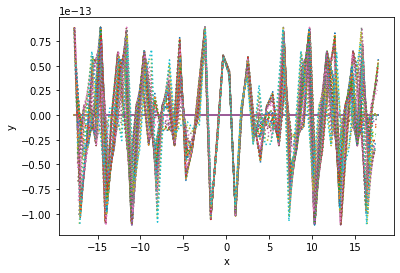

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.313224e-14 1.332886e-15
a1        5.827641e-14 1.879444e-15
a2        2.029781e-14 1.912593e-15
a3        -5.790450e-14 1.862514e-15
b1        7.920310e-15 1.876329e-15
b2        2.720546e-15 1.854974e-15
b3        1.350129e-14 1.886189e-15
w         2.097543e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee5def50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef3b7d10>

Goodness of fit qualifiers:
chi_squared            8.95955447620585e-24
objective_value        4.479777238102925e-24
r_squared              -inf


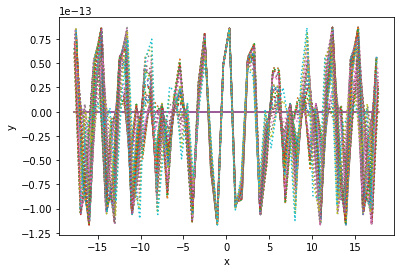

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.363725e-15 1.600340e-15
a1        -5.561004e-14 2.288129e-15
a2        7.481944e-14 2.404310e-15
a3        7.879667e-15 2.432507e-15
b1        2.290885e-14 2.277879e-15
b2        3.157176e-16 2.217370e-15
b3        4.556194e-14 2.265341e-15
w         2.084823e+00 7.638331e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee7ded90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefa3ab90>

Goodness of fit qualifiers:
chi_squared            1.2901955164831288e-23
objective_value        6.450977582415644e-24
r_squared              -inf


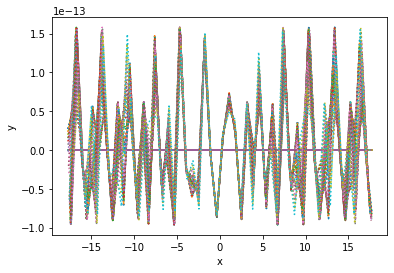

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        4.946902e-15 6.975250e-15
a1        1.957775e-13 1.386501e-14
a2        -2.470984e-13 1.821886e-14
a3        1.454291e-13 1.396328e-14
b1        -5.798884e-13 1.594141e-14
b2        5.283463e-14 7.601717e-15
b3        4.266122e-13 1.620320e-14
w         2.193251e+00 8.048865e-04
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef22f390>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef22f990>

Goodness of fit qualifiers:
chi_squared            2.450154870786878e-22
objective_value        1.225077435393439e-22
r_squared              -inf


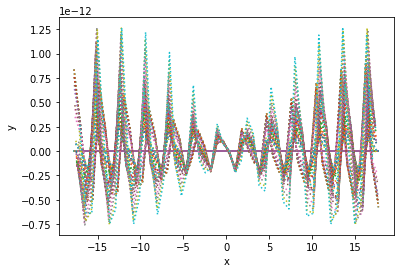

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.662678e-15 1.903380e-15
a1        -6.389864e-16 2.702000e-15
a2        3.839777e-14 2.656335e-15
a3        1.820347e-14 2.690943e-15
b1        -1.025851e-13 2.651296e-15
b2        3.480939e-15 2.729189e-15
b3        5.864892e-14 2.648953e-15
w         2.036350e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef20afe90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef20af250>

Goodness of fit qualifiers:
chi_squared            1.8268076235358146e-23
objective_value        9.134038117679073e-24
r_squared              -inf


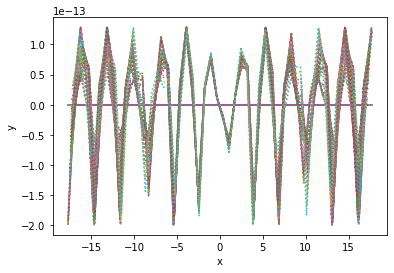

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -6.149587e-15 1.191126e-15
a1        2.381193e-14 1.688330e-15
a2        6.281652e-14 1.461526e-15
a3        3.152798e-15 1.678780e-15
b1        2.701898e-14 1.621848e-15
b2        -2.851868e-15 1.681645e-15
b3        -3.246544e-14 1.655263e-15
w         2.066282e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef267cc90>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefc1c210>

Goodness of fit qualifiers:
chi_squared            7.146096031428224e-24
objective_value        3.573048015714112e-24
r_squared              -inf


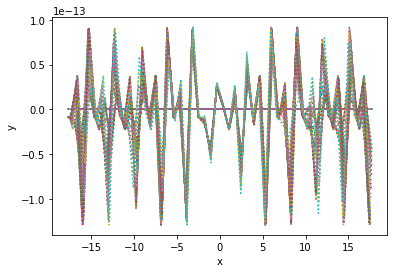

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.462980e-15 1.385379e-16
a1        -3.061537e-15 1.974363e-16
a2        1.552622e-15 1.959366e-16
a3        -2.392228e-16 2.059815e-16
b1        -4.001715e-15 2.124049e-16
b2        1.036896e-15 1.967841e-16
b3        -6.741314e-15 2.054031e-16
w         2.064988e+00 5.445411e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0161690>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeefd3fd0>

Goodness of fit qualifiers:
chi_squared            9.652450595725114e-26
objective_value        4.826225297862557e-26
r_squared              -inf


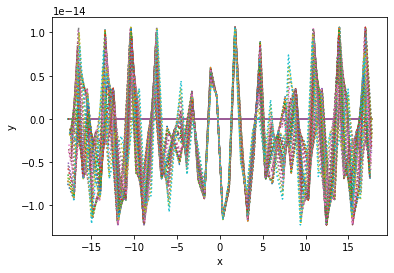

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.479125e-14 9.558786e-16
a1        -2.259268e-14 1.363815e-15
a2        -3.629436e-14 1.403569e-15
a3        -1.220769e-14 1.351032e-15
b1        -2.194767e-14 1.339384e-15
b2        3.399860e-14 1.349762e-15
b3        -5.931571e-15 1.373140e-15
w         2.079676e+00 5.398783e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeef9b050>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeef9b750>

Goodness of fit qualifiers:
chi_squared            4.5764079627639965e-24
objective_value        2.2882039813819983e-24
r_squared              -inf


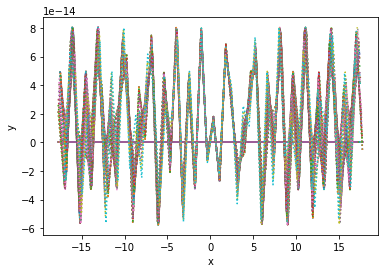

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -8.383542e-14 7.942150e-15
a1        2.270392e-15 1.133106e-14
a2        -1.816108e-13 1.147403e-14
a3        -1.716674e-14 1.126399e-14
b1        2.464255e-13 1.124388e-14
b2        4.956629e-14 1.101252e-14
b3        -4.220199e-13 1.126554e-14
w         2.084713e+00 2.466877e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeec76790>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef1bb80d0>

Goodness of fit qualifiers:
chi_squared            3.177021757070908e-22
objective_value        1.588510878535454e-22
r_squared              -inf


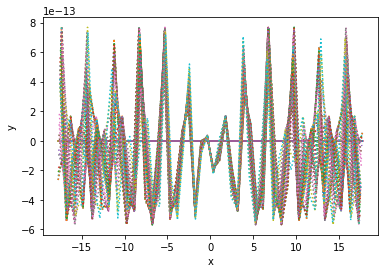

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -6.414800e-14 1.166293e-14
a1        1.018064e-13 1.551857e-14
a2        4.246606e-14 1.643364e-14
a3        -3.310900e-13 1.642657e-14
b1        4.688798e-13 1.444738e-14
b2        1.185245e-13 1.658180e-14
b3        5.039044e-13 1.549857e-14
w         2.110139e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee788410>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee788790>

Goodness of fit qualifiers:
chi_squared            6.88471997660616e-22
objective_value        3.44235998830308e-22
r_squared              -inf


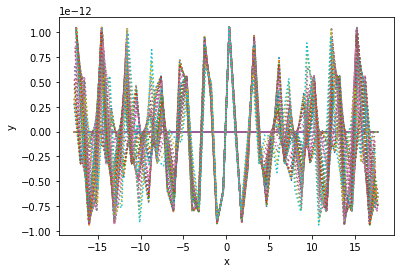

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.077148e-14 2.813579e-15
a1        -3.165606e-14 4.011476e-15
a2        -6.613572e-14 4.085282e-15
a3        9.770576e-15 3.984027e-15
b1        1.115800e-13 4.148005e-15
b2        -3.114357e-14 3.925138e-15
b3        -1.216245e-13 4.116603e-15
w         2.076363e+00 3.974759e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeedea550>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef31e7d0>

Goodness of fit qualifiers:
chi_squared            3.9835581583329e-23
objective_value        1.99177907916645e-23
r_squared              -inf


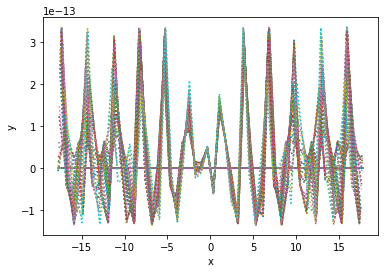

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.687036e-13 1.149198e-14
a1        -3.329478e-13 1.562914e-14
a2        -1.577109e-13 1.603768e-14
a3        -3.302173e-13 1.601919e-14
b1        4.072772e-13 1.610103e-14
b2        3.548186e-13 1.540680e-14
b3        -6.704939e-14 1.559866e-14
w         2.059121e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee885290>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee994190>

Goodness of fit qualifiers:
chi_squared            6.704438786262275e-22
objective_value        3.3522193931311374e-22
r_squared              -inf


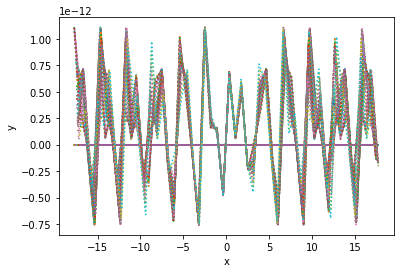

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -8.008675e-14 3.147193e-15
a1        2.232463e-14 4.488022e-15
a2        1.478835e-13 4.611967e-15
a3        2.730453e-14 4.485531e-15
b1        6.028785e-15 4.439411e-15
b2        3.496853e-14 4.373206e-15
b3        -8.485140e-14 4.440732e-15
w         2.081346e+00 3.829345e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee51d790>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee51d310>

Goodness of fit qualifiers:
chi_squared            4.9791396711960154e-23
objective_value        2.4895698355980077e-23
r_squared              -inf


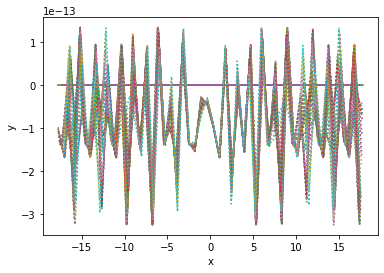

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        5.518712e-15 1.262160e-15
a1        1.379557e-14 1.799838e-15
a2        -9.701562e-15 1.805199e-15
a3        8.030294e-15 1.781838e-15
b1        3.164684e-14 1.769905e-15
b2        -7.185789e-14 1.691454e-15
b3        1.857278e-14 1.755140e-15
w         2.076119e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee7a3ad0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee7a3d50>

Goodness of fit qualifiers:
chi_squared            8.02400908533933e-24
objective_value        4.012004542669665e-24
r_squared              -inf


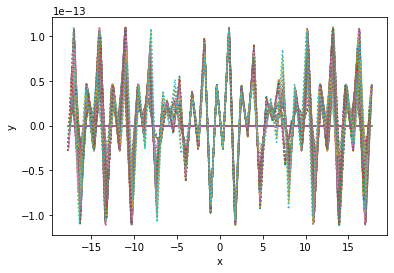

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -3.136307e-14 1.258989e-15
a1        5.630040e-16 1.796157e-15
a2        -1.419955e-15 1.857289e-15
a3        -5.588484e-14 1.785386e-15
b1        4.431854e-14 1.768975e-15
b2        1.071591e-14 1.751179e-15
b3        -2.078998e-15 1.800825e-15
w         2.084447e+00 4.982001e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefc20c10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefc20750>

Goodness of fit qualifiers:
chi_squared            7.985255353433124e-24
objective_value        3.992627676716562e-24
r_squared              -inf


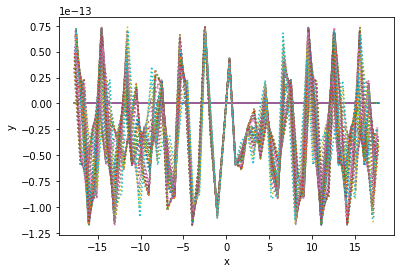

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -3.442152e-13 1.672232e-14
a1        -6.216701e-13 2.384622e-14
a2        7.531498e-13 2.448539e-14
a3        -2.641418e-13 2.388305e-14
b1        -4.788818e-14 2.348373e-14
b2        5.451471e-14 2.316841e-14
b3        -6.562477e-14 2.362488e-14
w         2.084730e+00 2.648715e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef8ca190>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefccc5d0>

Goodness of fit qualifiers:
chi_squared            1.4086879812780872e-21
objective_value        7.043439906390436e-22
r_squared              -inf


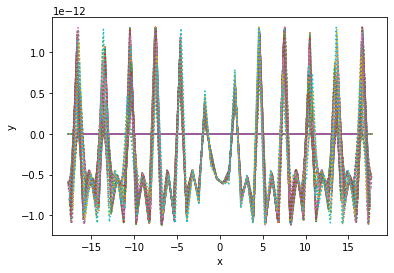

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.167616e-14 2.023298e-15
a1        -5.191422e-14 2.709722e-15
a2        5.840700e-14 2.750237e-15
a3        7.376418e-14 2.854733e-15
b1        2.175256e-14 2.863664e-15
b2        -7.821487e-14 2.642609e-15
b3        -1.364657e-14 2.860933e-15
w         2.027747e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeeaa68d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef1ced190>

Goodness of fit qualifiers:
chi_squared            2.0936195666086673e-23
objective_value        1.0468097833043337e-23
r_squared              -inf


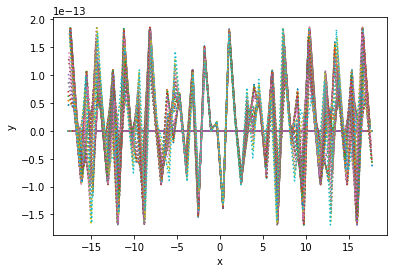

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -3.309149e-15 4.668653e-16
a1        -6.925534e-15 6.179148e-16
a2        -5.320778e-15 6.380739e-16
a3        -7.208614e-15 6.007983e-16
b1        -5.178877e-15 nan
b2        -3.471529e-15 6.100017e-16
b3        -2.851020e-14 6.060764e-16
w         2.065497e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef2d6f190>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef62ff10>

Goodness of fit qualifiers:
chi_squared            1.1073297694107962e-24
objective_value        5.536648847053981e-25
r_squared              -inf


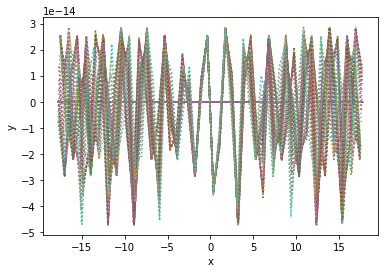

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.699746e-13 1.115173e-14
a1        -9.223528e-14 1.546767e-14
a2        -3.276500e-13 1.232226e-14
a3        9.215259e-14 1.558288e-14
b1        2.751379e-13 1.530150e-14
b2        3.925083e-13 7.918994e-15
b3        -2.505620e-13 1.396191e-14
w         2.070542e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef4e5310>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef358b10>

Goodness of fit qualifiers:
chi_squared            6.293182604104946e-22
objective_value        3.146591302052473e-22
r_squared              -inf


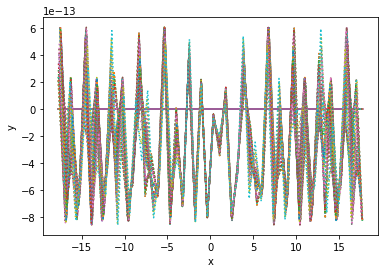

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.986708e-14 1.779752e-15
a1        -8.559909e-14 2.544865e-15
a2        1.285092e-14 2.544560e-15
a3        4.940740e-15 2.369743e-15
b1        2.982714e-14 2.420590e-15
b2        5.740661e-14 2.401752e-15
b3        4.114784e-14 2.497822e-15
w         2.072320e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef34f290>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeeebb250>

Goodness of fit qualifiers:
chi_squared            1.603414398314712e-23
objective_value        8.01707199157356e-24
r_squared              -inf


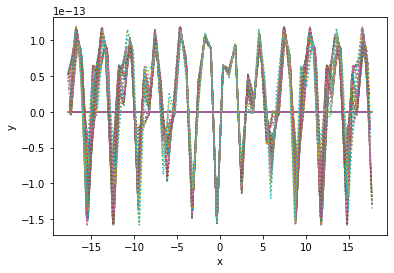

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.155182e-15 7.829763e-16
a1        -1.126177e-14 1.117334e-15
a2        1.989392e-14 1.132382e-15
a3        8.484755e-15 1.116692e-15
b1        -2.545945e-14 1.123086e-15
b2        -8.717318e-15 1.093219e-15
b3        3.748121e-14 1.119038e-15
w         2.081270e+00 3.413776e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef267c590>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefa0f110>

Goodness of fit qualifiers:
chi_squared            3.0881883620308165e-24
objective_value        1.5440941810154083e-24
r_squared              -inf


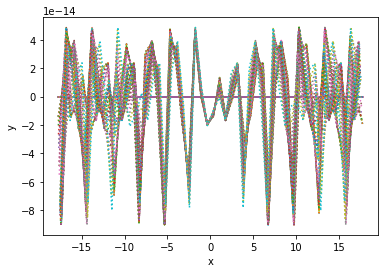

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        9.232122e-15 2.518697e-16
a1        -4.922947e-15 3.435305e-16
a2        2.443523e-15 3.604085e-16
a3        -5.391081e-15 3.532929e-16
b1        -2.169070e-15 3.536563e-16
b2        6.401692e-15 3.443558e-16
b3        -2.130113e-15 3.543036e-16
w         2.081910e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeeeb5d10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef0285a90>

Goodness of fit qualifiers:
chi_squared            3.1976467999545505e-25
objective_value        1.5988233999772752e-25
r_squared              -inf


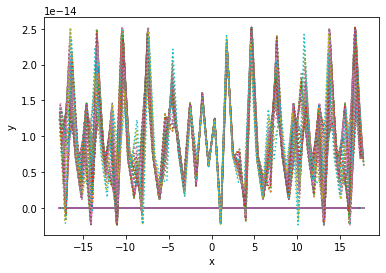

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.710397e-14 2.727307e-15
a1        -5.891349e-14 3.912004e-15
a2        1.641547e-13 4.485403e-15
a3        -3.009187e-14 4.117862e-15
b1        2.005862e-14 3.842277e-15
b2        -6.418141e-15 3.813475e-15
b3        3.098464e-14 3.859758e-15
w         2.074922e+00 5.202733e-03
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef56dbd0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeef798a50>

Goodness of fit qualifiers:
chi_squared            3.746336509377473e-23
objective_value        1.8731682546887364e-23
r_squared              -inf


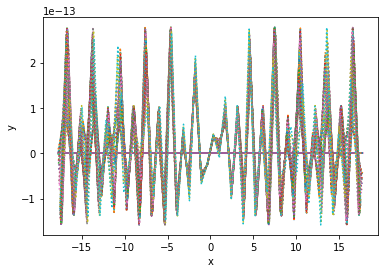

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.267104e-13 7.917053e-15
a1        1.829329e-13 1.127279e-14
a2        -1.397129e-13 1.144714e-14
a3        -6.698644e-14 1.120872e-14
b1        1.324467e-13 1.112968e-14
b2        -2.177551e-13 1.095650e-14
b3        3.428861e-13 1.119493e-14
w         2.089328e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee64e210>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee949810>

Goodness of fit qualifiers:
chi_squared            3.158702097479098e-22
objective_value        1.579351048739549e-22
r_squared              -inf


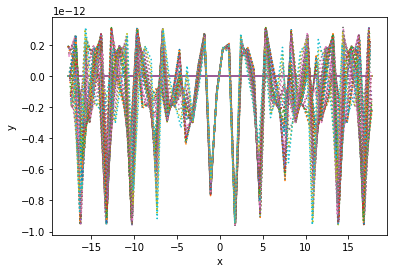

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.681448e-14 1.393674e-15
a1        -2.832694e-14 1.943363e-15
a2        4.390327e-14 1.938755e-15
a3        -5.752869e-14 1.964398e-15
b1        9.021676e-15 1.943528e-15
b2        -6.669146e-15 1.987690e-15
b3        4.186810e-14 1.972508e-15
w         2.060318e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   18
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef798ed0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeec53a10>

Goodness of fit qualifiers:
chi_squared            9.817337062081656e-24
objective_value        4.908668531040828e-24
r_squared              -inf


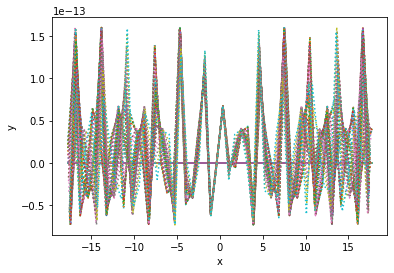

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -3.329221e-15 1.374058e-16
a1        -1.010254e-15 1.954225e-16
a2        -2.558719e-15 1.983707e-16
a3        -1.340345e-15 1.944631e-16
b1        -4.011663e-15 1.929553e-16
b2        -4.421344e-15 1.902724e-16
b3        -4.187555e-15 1.942470e-16
w         2.087425e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee4ffa10>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee4ff290>

Goodness of fit qualifiers:
chi_squared            9.524697156555459e-26
objective_value        4.7623485782777293e-26
r_squared              -inf


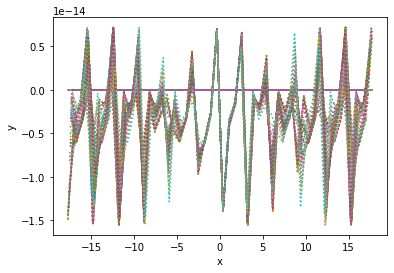

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -9.169857e-14 7.502761e-15
a1        2.434849e-14 1.053316e-14
a2        3.332440e-13 1.081868e-14
a3        4.067066e-14 1.066985e-14
b1        3.153649e-13 1.072454e-14
b2        3.174193e-14 1.056268e-14
b3        -1.762913e-13 1.071409e-14
w         1.987959e+00 3.128787e-03
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee609b50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee609150>

Goodness of fit qualifiers:
chi_squared            2.8352240220238394e-22
objective_value        1.4176120110119197e-22
r_squared              -inf


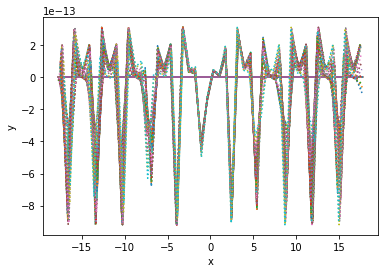

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.491127e-14 3.256280e-15
a1        1.559054e-14 4.645110e-15
a2        1.184216e-13 4.691643e-15
a3        -5.813084e-14 4.580090e-15
b1        3.620254e-14 4.562794e-15
b2        1.122332e-13 4.524831e-15
b3        1.226949e-13 4.618228e-15
w         2.088595e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   20
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeec53950>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeee64ed50>

Goodness of fit qualifiers:
chi_squared            5.381927652063901e-23
objective_value        2.6909638260319505e-23
r_squared              -inf


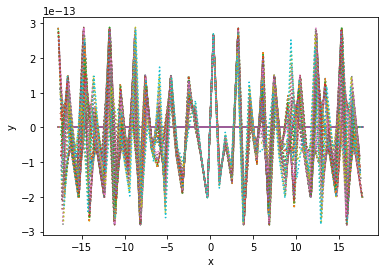

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        4.037721e-14 1.253756e-14
a1        4.656757e-13 1.776958e-14
a2        1.632984e-13 1.739890e-14
a3        -5.605245e-13 1.767039e-14
b1        -2.554075e-13 1.760998e-14
b2        2.716088e-13 1.799110e-14
b3        -1.017042e-13 1.773591e-14
w         2.044363e+00 2.687522e-03
Status message         Optimization terminated successfully.
Number of iterations   19
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee7d8e50>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef243ca50>

Goodness of fit qualifiers:
chi_squared            7.867752964453215e-22
objective_value        3.9338764822266075e-22
r_squared              -inf


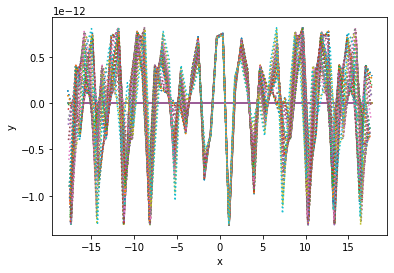

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.534331e-15 1.438128e-15
a1        8.306286e-14 2.044394e-15
a2        -1.658139e-14 2.021827e-15
a3        9.574874e-16 6.253062e-16
b1        3.925046e-15 1.868160e-15
b2        -2.704652e-15 2.043566e-15
b3        4.682809e-14 2.048511e-15
w         2.112163e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   21
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef40d8d0>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeeee8cf50>

Goodness of fit qualifiers:
chi_squared            1.0573377104319487e-23
objective_value        5.2866885521597435e-24
r_squared              -inf


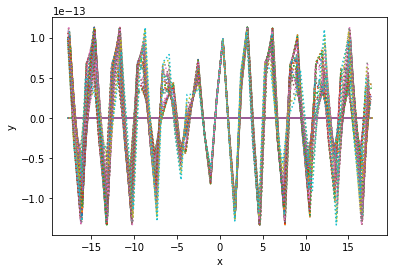

{y: a0 + a1*cos(w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + b1*sin(w*x) + b2*sin(2*w*x) + b3*sin(3*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.316496e-15 3.223293e-16
a1        -3.362525e-16 4.605986e-16
a2        -1.195470e-15 4.654840e-16
a3        8.505278e-15 4.567000e-16
b1        1.172221e-14 4.587420e-16
b2        -4.445077e-15 4.471581e-16
b3        -1.516231e-14 4.587541e-16
w         2.082820e+00 2.777213e-03
Status message         Optimization terminated successfully.
Number of iterations   22
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef02e7050>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feeefbe2f50>

Goodness of fit qualifiers:
chi_squared            5.233887987153471e-25
objective_value        2.6169439935767353e-25
r_squared              -inf


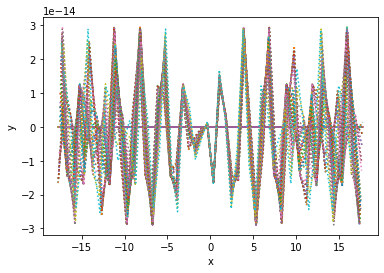

In [159]:
for i in range (0,100):
  x, y = variables('x, y')
  w, = parameters('w')
  model_dict = {y: fourier_series(x, f=w, n=3)} #n was calculated selecting the best one
  print(model_dict)

  # Make step function data
  xdata = np.linspace(-d2[i], d2[i])
  ydata = np.zeros_like(xdata)
  #ydata[xdata2 > 0] = 1
  # Define a Fit object for this model and data
  fit = Fit(model_dict, x=xdata, y=ydata)
  fit_result = fit.execute()
  print(fit_result)

  # Plot the result
  plt.plot(xdata, ydata)
  plt.plot(xdata, fit.model(x=xdata, **fit_result.params).y, ls=':')
  plt.xlabel('x')
  plt.ylabel('y')
  plt.show()

#Noise data 2

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.520097e-14 3.021152e-15
a1        1.366161e-14 4.203256e-15
a10       -2.275942e-14 4.255247e-15
a2        -5.351535e-14 4.215860e-15
a3        5.190235e-14 4.182668e-15
a4        -8.650176e-15 4.231072e-15
a5        -2.299885e-14 4.276592e-15
a6        -1.506421e-14 4.219115e-15
a7        3.838470e-14 4.274717e-15
a8        -2.538467e-14 4.410245e-15
a9        -6.154043e-15 4.178466e-15
b1        -3.463629e-15 4.342787e-15
b10       -6.741608e-15 4.603450e-15
b2        1.516106e-14 4.323134e-15
b3        -1.037056e-14 4.384256e-15
b4        1.565608e-15 4.320308e-15
b5        1.409428e-14 4.444401e-15
b6        3.764400e-14 4.500291e-15
b7        -1.740923e-14 4.298064e-15
b8        -3.813819e-14 4.421433e-15
b9        -5.278901e-14 5.129207e-15
w         1.635480e+00 1.112795e-03
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares obje

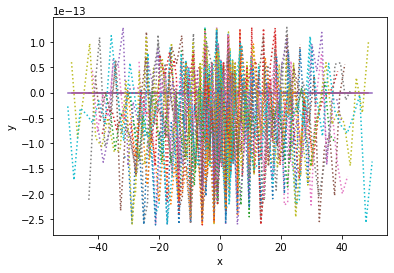

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.149384e-13 1.884916e-14
a1        -2.085172e-13 2.701343e-14
a10       -1.620096e-13 2.114464e-14
a2        3.025874e-13 2.114407e-14
a3        6.462529e-14 1.968170e-14
a4        9.971169e-14 2.082173e-14
a5        9.199880e-14 2.089730e-14
a6        5.687352e-14 1.953598e-14
a7        3.168910e-13 2.129623e-14
a8        -1.574143e-14 2.053069e-14
a9        2.868140e-13 2.229745e-14
b1        1.970684e-13 2.507316e-14
b10       2.279961e-13 2.043027e-14
b2        -2.090804e-13 2.046311e-14
b3        1.865311e-13 2.069864e-14
b4        -9.896234e-14 1.883767e-14
b5        2.704910e-14 1.878165e-14
b6        -2.712726e-13 2.072944e-14
b7        1.261283e-13 2.039369e-14
b8        -6.923278e-14 1.967051e-14
b9        1.414769e-13 1.882436e-14
w         9.797267e-01 5.170540e-04
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0

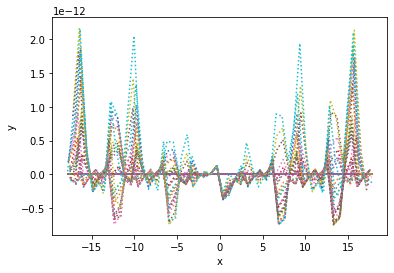

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.689253e-15 3.822260e-15
a1        -4.938357e-14 6.119616e-15
a10       -1.172044e-14 5.798552e-15
a2        -2.991493e-14 5.789416e-15
a3        -4.856629e-15 5.860694e-15
a4        -4.893967e-15 6.017425e-15
a5        -7.295556e-15 5.982409e-15
a6        -3.592023e-15 5.844706e-15
a7        1.669466e-15 5.799742e-15
a8        -1.023755e-14 5.820419e-15
a9        1.047627e-13 5.733966e-15
b1        7.249921e-14 5.343658e-15
b10       5.492349e-14 5.543371e-15
b2        9.452383e-14 5.241923e-15
b3        6.961368e-14 5.615838e-15
b4        3.596437e-14 5.663693e-15
b5        -6.476725e-15 5.615397e-15
b6        -3.941792e-14 5.471513e-15
b7        -1.018872e-13 5.303603e-15
b8        -3.567892e-14 5.601873e-15
b9        2.215785e-14 5.951096e-15
w         9.954612e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

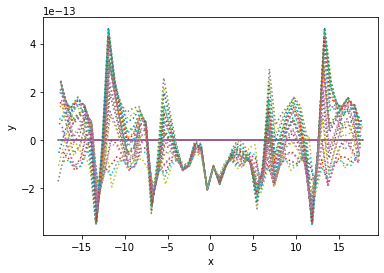

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.632684e-13 2.394475e-14
a1        7.089479e-13 3.764457e-14
a10       1.002103e-13 3.342765e-14
a2        4.029555e-14 3.725126e-14
a3        1.979806e-13 3.728693e-14
a4        3.096305e-13 3.774258e-14
a5        2.860886e-13 3.742941e-14
a6        1.886066e-13 3.706761e-14
a7        7.352312e-14 3.762701e-14
a8        1.720523e-13 3.377362e-14
a9        -5.511009e-13 3.584873e-14
b1        5.165801e-13 3.776332e-14
b10       -3.279634e-13 3.627692e-14
b2        5.450260e-14 3.787873e-14
b3        1.076534e-13 3.702494e-14
b4        -7.805400e-15 3.664952e-14
b5        3.817180e-15 3.681299e-14
b6        -2.533296e-13 3.755011e-14
b7        -1.869568e-13 3.787170e-14
b8        2.215187e-13 3.602135e-14
b9        2.951894e-14 3.688654e-14
w         9.954329e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef0318

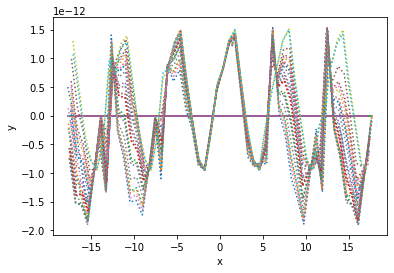

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -6.860004e-14 3.689721e-14
a1        -7.920828e-14 5.371913e-14
a10       -1.326102e-13 4.001194e-14
a2        9.003732e-14 4.274994e-14
a3        -4.021228e-13 3.605784e-14
a4        8.819303e-14 4.503558e-14
a5        7.324134e-14 4.519891e-14
a6        -2.754996e-13 3.374283e-14
a7        5.418165e-14 4.287569e-14
a8        2.132279e-13 4.359729e-14
a9        6.618437e-14 4.289504e-14
b1        1.446451e-13 4.865951e-14
b10       2.093866e-13 4.212166e-14
b2        7.543257e-13 nan
b3        -4.488507e-13 1.817825e-14
b4        7.432481e-13 nan
b5        -7.781655e-13 nan
b6        5.669233e-13 2.307314e-14
b7        -6.784240e-13 nan
b8        -4.539350e-14 4.256328e-14
b9        -7.898363e-14 4.290131e-14
w         9.827467e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef034a590>
Minimizer              <sym

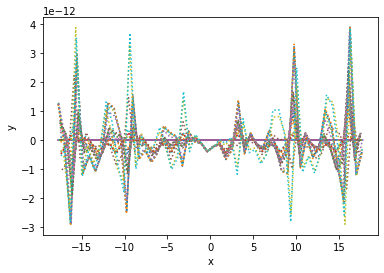

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -1.344400e-13 7.276173e-14
a1        3.288511e-13 8.314841e-14
a10       9.545701e-14 7.383975e-14
a2        3.659707e-13 1.042102e-13
a3        1.031923e-13 6.547916e-14
a4        -2.820218e-13 9.373843e-14
a5        -2.575533e-13 9.504392e-14
a6        1.012659e-13 6.445261e-14
a7        3.068389e-13 1.035275e-13
a8        -1.150158e-13 6.690612e-14
a9        -3.618603e-13 6.994513e-14
b1        -6.374209e-14 6.612171e-14
b10       -4.823092e-13 1.029941e-13
b2        1.284405e-12 2.606657e-13
b3        -5.550047e-13 1.712686e-13
b4        -2.567019e-13 8.823985e-14
b5        2.042120e-13 8.676508e-14
b6        7.121821e-13 1.682040e-13
b7        -1.163956e-12 2.611180e-13
b8        -2.841052e-13 1.089746e-13
b9        -6.224970e-13 1.235344e-13
w         9.803211e-01 4.497214e-03
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object

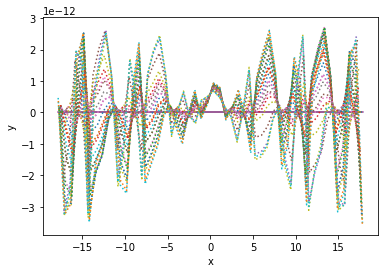

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.328899e-13 nan
a1        -6.340109e-14 1.254795e-13
a10       6.976223e-13 8.766044e-14
a2        4.779180e-13 nan
a3        1.701427e-12 nan
a4        -7.697605e-13 nan
a5        -6.671766e-13 nan
a6        1.694204e-12 nan
a7        4.101702e-13 nan
a8        -4.778927e-13 nan
a9        7.605656e-13 nan
b1        1.649652e-12 nan
b10       1.184076e-12 nan
b2        -1.155818e-12 nan
b3        -2.620171e-12 nan
b4        -7.535072e-13 nan
b5        4.792453e-13 nan
b6        2.477343e-12 nan
b7        1.049388e-12 nan
b8        -8.436114e-13 nan
b9        5.753128e-13 nan
w         9.803041e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef33b6950>
Minimizer              <symfit.core.minimizers.BFGS object at 0x7feef193a590>

Goodness of fit qualifiers:
chi_squared            5.857877493855101e-21
objective_va

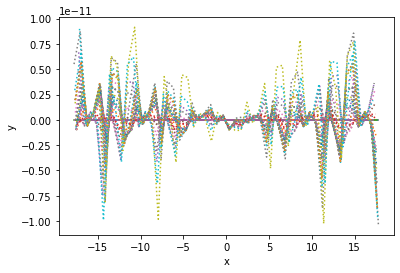

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.062946e-14 6.682203e-15
a1        -2.298436e-14 9.931396e-15
a10       1.029144e-14 8.069466e-15
a2        -9.709501e-14 9.994906e-15
a3        3.222592e-14 8.159328e-15
a4        3.930862e-14 8.501183e-15
a5        -2.684910e-15 8.656960e-15
a6        5.206986e-14 8.126608e-15
a7        -1.290311e-13 9.828273e-15
a8        -5.675894e-14 8.511181e-15
a9        -2.113162e-14 8.150167e-15
b1        -8.177595e-14 1.150917e-14
b10       -9.642320e-14 9.012649e-15
b2        2.378552e-14 8.237995e-15
b3        1.036600e-13 8.932541e-15
b4        5.141280e-14 8.169107e-15
b5        -4.374864e-14 8.053501e-15
b6        -4.813468e-14 9.313324e-15
b7        4.731429e-14 8.106148e-15
b8        9.772317e-15 8.804442e-15
b9        1.271294e-13 8.266537e-15
w         9.825870e-01 1.009427e-03
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object a

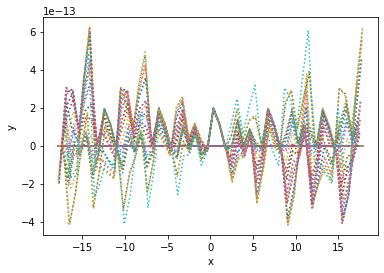

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.091607e-12 1.595290e-13
a1        3.998046e-13 1.398261e-13
a10       3.577415e-13 1.026379e-13
a2        1.183705e-12 1.399823e-13
a3        2.232828e-13 9.708470e-14
a4        -1.568775e-12 1.624793e-13
a5        -1.676397e-12 1.629604e-13
a6        1.237068e-14 9.658859e-14
a7        1.115335e-12 1.393151e-13
a8        4.457329e-14 1.181776e-13
a9        1.296672e-12 2.054119e-13
b1        1.414874e-12 2.455891e-13
b10       7.682450e-13 1.575662e-13
b2        4.592803e-13 1.015686e-13
b3        -1.241633e-12 1.439843e-13
b4        -3.643628e-13 1.047168e-13
b5        3.996742e-13 9.947597e-14
b6        1.346404e-12 1.461032e-13
b7        -1.238564e-13 9.908818e-14
b8        -1.123046e-12 1.700048e-13
b9        7.305674e-14 1.024672e-13
w         9.808683e-01 1.999999e-03
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x

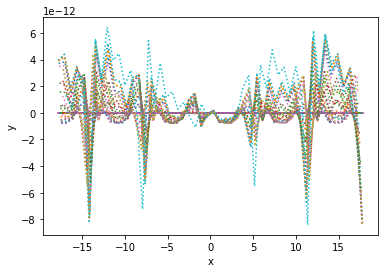

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        6.376933e-14 1.433144e-14
a1        1.420984e-13 1.728558e-14
a10       4.651119e-14 1.254209e-14
a2        1.076907e-13 1.275778e-14
a3        -1.642649e-13 1.562942e-14
a4        -3.109377e-14 1.126006e-14
a5        -1.370747e-14 1.135757e-14
a6        -1.186630e-13 1.641946e-14
a7        7.346758e-14 1.335476e-14
a8        5.489775e-14 1.318311e-14
a9        1.778264e-13 1.343285e-14
b1        -1.878640e-14 1.228029e-14
b10       -6.627526e-14 1.159208e-14
b2        5.808168e-14 1.244639e-14
b3        7.752964e-14 1.367068e-14
b4        -1.043348e-13 1.201401e-14
b5        5.833674e-14 1.272694e-14
b6        -1.102099e-13 1.349687e-14
b7        -8.482543e-14 1.232477e-14
b8        -7.549384e-14 1.078121e-14
b9        8.847725e-14 1.149421e-14
w         9.810206e-01 1.626518e-03
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object a

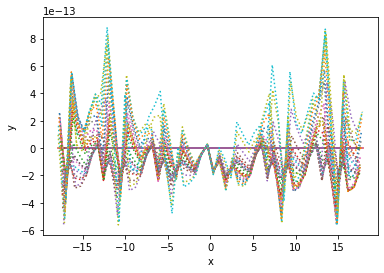

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        5.889365e-14 9.741781e-15
a1        6.261822e-14 1.364117e-14
a10       -7.194263e-14 1.353941e-14
a2        -2.776702e-14 1.314731e-14
a3        -1.751937e-14 1.352450e-14
a4        7.513504e-16 1.379646e-14
a5        8.853440e-15 1.380369e-14
a6        5.275641e-14 1.350923e-14
a7        -1.196903e-13 1.348330e-14
a8        -9.945803e-14 1.373807e-14
a9        -2.023699e-14 1.333215e-14
b1        -7.052101e-14 1.333685e-14
b10       -2.116307e-14 1.330421e-14
b2        1.560287e-13 1.172898e-14
b3        1.269536e-13 1.163911e-14
b4        -8.466054e-15 1.295225e-14
b5        -1.317251e-13 1.324514e-14
b6        -2.554024e-13 1.269526e-14
b7        -2.627243e-13 1.263471e-14
b8        6.335397e-14 1.313116e-14
b9        8.335696e-14 1.344988e-14
w         9.989510e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

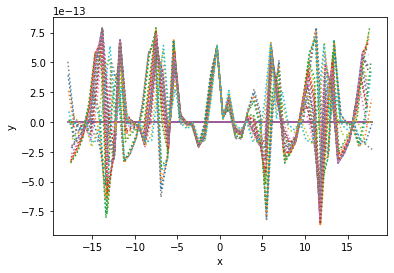

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        4.173605e-13 1.617748e-14
a1        1.285943e-13 4.285129e-14
a10       1.353470e-13 3.669274e-14
a2        2.552207e-13 3.479587e-14
a3        -4.443003e-13 3.087589e-14
a4        -2.362250e-13 3.661420e-14
a5        -2.061846e-13 3.663166e-14
a6        -3.920490e-13 3.011054e-14
a7        2.232195e-13 3.502527e-14
a8        2.033819e-13 3.702381e-14
a9        5.404592e-13 2.829054e-14
b1        -4.807754e-13 2.838343e-14
b10       -2.353340e-14 3.517875e-14
b2        -2.545951e-13 3.675780e-14
b3        1.029013e-13 3.302317e-14
b4        3.469286e-13 2.488657e-14
b5        -5.783918e-13 2.775332e-14
b6        -4.106476e-13 3.474043e-14
b7        -1.305494e-14 3.588934e-14
b8        4.465500e-13 2.542306e-14
b9        2.867143e-13 3.268091e-14
w         9.856683e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef

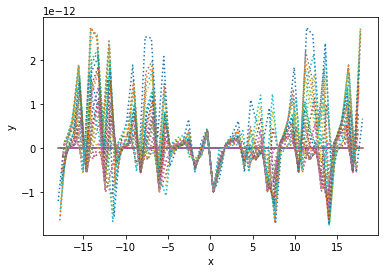

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.031929e-12 5.685773e-14
a1        3.918287e-13 1.175471e-13
a10       1.001757e-12 8.328391e-14
a2        3.737237e-13 9.152222e-14
a3        -2.396689e-13 9.269222e-14
a4        -1.341498e-12 7.777959e-14
a5        -1.182650e-12 7.662226e-14
a6        -2.212092e-13 9.181610e-14
a7        2.924266e-13 9.211188e-14
a8        -5.881817e-13 9.490505e-14
a9        1.221391e-12 8.167513e-14
b1        -6.236957e-13 1.051728e-13
b10       -7.602380e-13 8.760311e-14
b2        1.336045e-12 6.111980e-14
b3        -5.231366e-13 9.199314e-14
b4        5.508029e-13 8.566479e-14
b5        -4.622213e-13 8.499753e-14
b6        4.331471e-13 9.254007e-14
b7        -1.652571e-12 6.336842e-14
b8        -4.645679e-15 9.241608e-14
b9        1.000968e-12 7.805198e-14
w         9.837119e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

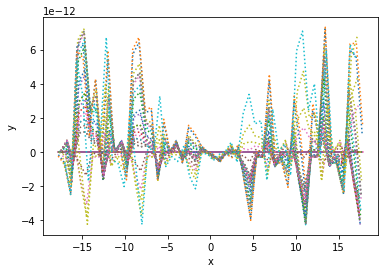

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -8.116838e-14 2.993818e-14
a1        -1.926453e-13 4.122208e-14
a10       -6.451034e-13 3.398850e-14
a2        1.260943e-13 3.323038e-14
a3        2.303534e-13 3.333254e-14
a4        1.293185e-13 3.635087e-14
a5        6.578508e-14 3.638756e-14
a6        2.479328e-13 3.284510e-14
a7        2.293434e-13 3.404427e-14
a8        -1.224789e-13 3.567802e-14
a9        -7.529382e-14 3.855658e-14
b1        2.830451e-14 4.046173e-14
b10       -4.012244e-13 3.496899e-14
b2        5.718913e-16 3.454932e-14
b3        -3.251604e-13 3.348771e-14
b4        -3.513408e-13 3.127942e-14
b5        2.333510e-13 3.100704e-14
b6        2.371820e-13 3.331293e-14
b7        -2.697458e-13 3.477621e-14
b8        1.202360e-13 3.351670e-14
b9        3.534199e-13 3.004028e-14
w         9.849678e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   51
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef

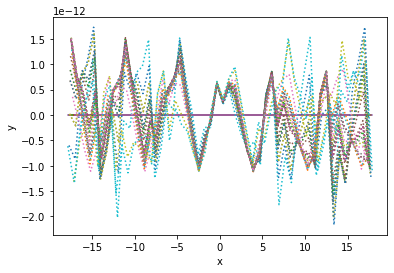

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.129443e-15 1.452231e-15
a1        -5.524811e-14 nan
a10       -8.048815e-14 3.158040e-16
a2        -1.457252e-14 2.639872e-15
a3        1.266391e-14 2.625945e-15
a4        2.362159e-14 2.794471e-15
a5        1.404310e-14 2.815341e-15
a6        4.797189e-15 2.645338e-15
a7        4.842058e-16 2.487776e-15
a8        -1.149672e-14 nan
a9        5.641276e-15 1.100696e-15
b1        6.590320e-15 2.796521e-15
b10       6.569063e-15 2.316540e-15
b2        -1.398109e-14 2.648916e-15
b3        9.196105e-16 2.723143e-15
b4        -5.468111e-15 2.579470e-15
b5        -3.344645e-15 2.574080e-15
b6        5.046239e-15 2.733139e-15
b7        1.422223e-14 2.629257e-15
b8        -6.681956e-15 2.567933e-15
b9        1.278207e-14 2.580405e-15
w         9.772856e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeefc26890>
Minimizer  

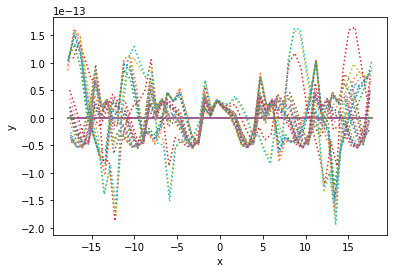

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.240269e-14 9.237798e-15
a1        -1.866517e-13 9.657859e-15
a10       -1.125508e-13 9.928790e-15
a2        4.892568e-14 1.119283e-14
a3        -2.240390e-14 1.138529e-14
a4        -2.543831e-14 1.189378e-14
a5        -6.620172e-15 1.189199e-14
a6        -2.930171e-14 1.130306e-14
a7        4.249663e-14 1.126773e-14
a8        -8.778320e-14 1.068548e-14
a9        6.811689e-14 1.177373e-14
b1        2.478997e-14 1.265773e-14
b10       1.461206e-15 1.129912e-14
b2        -1.873168e-13 6.742908e-15
b3        7.557419e-14 1.125024e-14
b4        8.321519e-14 1.054068e-14
b5        -6.523978e-14 1.049585e-14
b6        -4.872227e-14 1.121321e-14
b7        2.442809e-13 7.648609e-15
b8        -7.121910e-14 1.126395e-14
b9        -1.467325e-13 1.016002e-14
w         9.849325e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

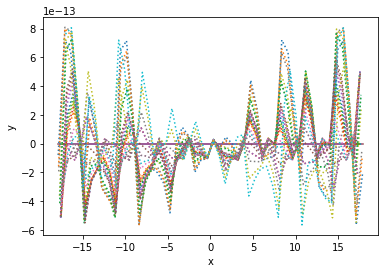

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.686008e-13 8.134352e-14
a1        1.366544e-12 1.083948e-13
a10       3.168016e-13 1.040356e-13
a2        1.342191e-12 9.818790e-14
a3        -3.870149e-13 1.078715e-13
a4        -1.416297e-15 1.120315e-13
a5        -7.131889e-14 1.119148e-13
a6        -4.561566e-13 1.073307e-13
a7        1.217850e-12 9.855715e-14
a8        9.418506e-13 9.996650e-14
a9        5.607849e-13 1.072312e-13
b1        -1.835212e-12 9.068244e-14
b10       -1.003189e-12 9.810697e-14
b2        -1.273138e-12 9.920938e-14
b3        -1.690647e-12 9.419394e-14
b4        -1.835870e-12 9.539442e-14
b5        1.114696e-12 9.135474e-14
b6        1.351918e-12 9.158054e-14
b7        1.156775e-12 9.686334e-14
b8        9.891463e-13 9.908097e-14
b9        -2.660392e-13 1.066371e-13
w         9.881861e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   46
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

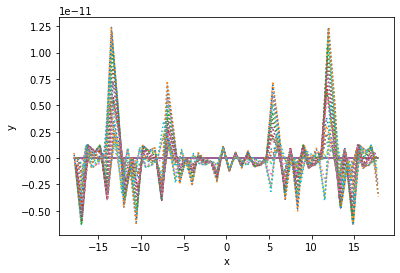

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        6.238759e-15 1.705685e-15
a1        -2.255304e-14 2.640415e-15
a10       -4.318618e-15 1.630724e-15
a2        -1.826597e-14 2.203843e-15
a3        -3.396305e-15 1.392158e-15
a4        6.810240e-15 1.609342e-15
a5        8.031279e-15 1.629508e-15
a6        -3.038078e-15 1.361269e-15
a7        -2.041203e-14 2.151851e-15
a8        -1.140090e-14 2.158739e-15
a9        9.977082e-15 2.010363e-15
b1        -1.695220e-15 1.676727e-15
b10       -1.070161e-14 1.430930e-15
b2        7.976688e-15 1.376330e-15
b3        -1.170133e-15 1.537814e-15
b4        7.598193e-15 1.275035e-15
b5        5.174956e-15 1.274104e-15
b6        1.506172e-14 1.476087e-15
b7        2.721989e-15 1.392665e-15
b8        -6.752108e-16 1.315167e-15
b9        -1.667839e-14 1.335410e-15
w         9.818292e-01 1.556387e-03
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object

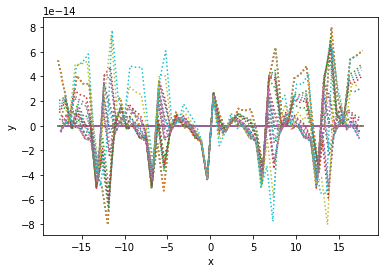

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -8.123301e-15 4.617785e-15
a1        -1.380330e-15 4.796319e-15
a10       5.023323e-14 5.906771e-15
a2        1.774897e-14 5.675099e-15
a3        -3.878306e-14 5.640962e-15
a4        8.040044e-15 6.106611e-15
a5        5.020206e-17 6.110097e-15
a6        -1.843262e-14 5.417522e-15
a7        -3.372621e-14 5.849770e-15
a8        9.681405e-14 6.016932e-15
a9        -2.165241e-14 6.348447e-15
b1        -1.537522e-14 5.957229e-15
b10       3.528743e-14 5.699830e-15
b2        -2.394539e-14 4.656331e-15
b3        4.525685e-14 5.691519e-15
b4        3.696429e-14 5.508587e-15
b5        -6.571276e-15 5.401854e-15
b6        -1.764487e-14 5.478246e-15
b7        7.434816e-14 5.446651e-15
b8        -5.782398e-14 5.789100e-15
b9        1.924162e-14 5.381366e-15
w         9.891295e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

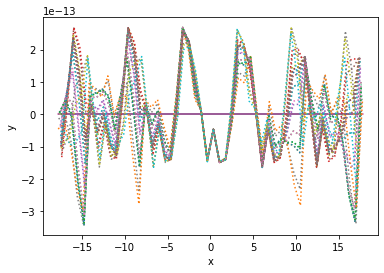

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.968847e-13 2.762481e-14
a1        2.078333e-13 3.991547e-14
a10       -9.065129e-14 3.543550e-14
a2        -1.623458e-13 3.407941e-14
a3        1.032900e-13 3.528471e-14
a4        -2.508824e-13 3.562596e-14
a5        -2.905441e-13 3.577522e-14
a6        1.243432e-13 3.496494e-14
a7        -3.343928e-13 3.486534e-14
a8        3.667858e-13 3.514833e-14
a9        9.194741e-14 3.649370e-14
b1        -6.992510e-13 3.150864e-14
b10       -6.935423e-13 2.666975e-14
b2        -2.876136e-14 3.584193e-14
b3        3.485670e-13 3.440462e-14
b4        -1.525134e-13 3.385159e-14
b5        1.809525e-13 3.380128e-14
b6        -2.527509e-13 3.423098e-14
b7        1.201517e-14 3.537632e-14
b8        -1.604151e-13 3.443109e-14
b9        1.288753e-13 3.342120e-14
w         9.894271e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

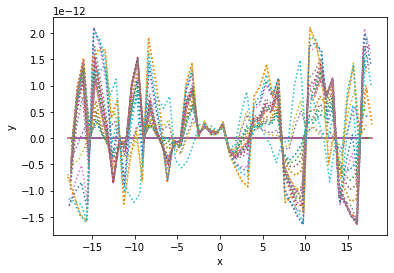

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.939045e-13 1.719598e-14
a1        5.157930e-13 3.625937e-14
a10       3.263274e-13 3.010473e-14
a2        -3.766913e-13 3.444672e-14
a3        -4.378148e-13 3.300754e-14
a4        8.834173e-14 3.909982e-14
a5        5.801699e-14 3.902201e-14
a6        -3.658246e-13 3.295210e-14
a7        -2.501931e-13 3.397741e-14
a8        5.114652e-14 3.685983e-14
a9        5.101160e-13 2.836230e-14
b1        2.187706e-13 4.018476e-14
b10       1.390714e-13 3.674510e-14
b2        3.591193e-13 2.954353e-14
b3        1.834895e-13 3.581159e-14
b4        1.058770e-13 3.428583e-14
b5        -3.128719e-13 3.490399e-14
b6        -2.672782e-13 3.621609e-14
b7        -6.307040e-13 3.136221e-14
b8        -1.697262e-13 3.666284e-14
b9        5.665587e-13 3.185711e-14
w         9.843276e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeed

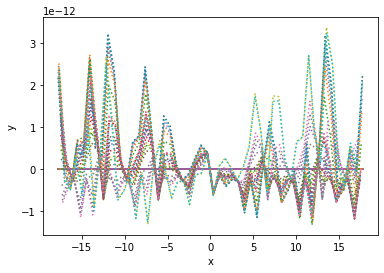

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.208664e-13 1.857649e-14
a1        -4.187869e-13 1.992751e-14
a10       -2.112912e-13 2.541910e-14
a2        -2.055812e-13 2.620637e-14
a3        1.212933e-13 2.815396e-14
a4        3.264318e-13 2.616424e-14
a5        3.147716e-13 2.621034e-14
a6        8.711318e-14 2.791371e-14
a7        -2.511807e-13 2.674348e-14
a8        -3.385726e-13 2.368231e-14
a9        -2.424496e-13 2.607523e-14
b1        -1.711918e-13 3.034212e-14
b10       1.107502e-13 2.811372e-14
b2        -1.269715e-13 2.810680e-14
b3        -1.874068e-13 2.834607e-14
b4        -3.260472e-13 2.731549e-14
b5        -9.509222e-14 2.646080e-14
b6        -1.683336e-13 2.848761e-14
b7        -3.286501e-13 2.847193e-14
b8        1.225976e-13 2.730921e-14
b9        2.413599e-13 2.664121e-14
w         9.897764e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7

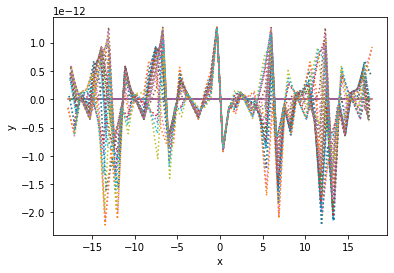

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.047402e-15 2.041673e-14
a1        -1.456662e-13 3.516606e-14
a10       3.951157e-13 2.633213e-14
a2        3.609678e-14 2.610735e-14
a3        -2.085904e-14 2.623790e-14
a4        -1.380601e-14 2.672582e-14
a5        -2.395759e-14 2.658573e-14
a6        -1.004540e-14 2.627220e-14
a7        2.867948e-14 2.624644e-14
a8        4.827275e-13 2.656564e-14
a9        -3.256706e-13 2.674919e-14
b1        -2.075413e-13 2.632214e-14
b10       -5.254264e-14 2.723849e-14
b2        3.732515e-14 2.648651e-14
b3        -8.955350e-14 2.657794e-14
b4        -1.995432e-13 2.671145e-14
b5        -2.698507e-13 2.650193e-14
b6        -1.561506e-13 2.640542e-14
b7        2.336829e-14 2.632839e-14
b8        -2.159170e-13 2.652541e-14
b9        -1.260186e-13 2.588820e-14
w         1.000123e+00 9.399264e-04
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares obje

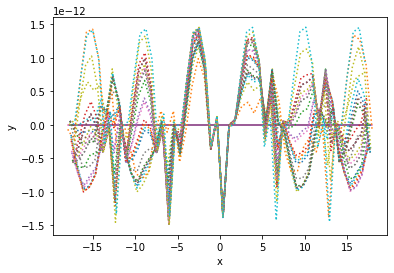

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.584617e-13 9.595757e-15
a1        8.564320e-14 1.756482e-14
a10       -1.103877e-14 1.468748e-14
a2        1.135693e-13 1.394436e-14
a3        -2.302628e-13 1.144825e-14
a4        -8.039719e-14 1.494299e-14
a5        -8.363086e-14 1.501963e-14
a6        -2.212974e-13 1.121181e-14
a7        8.931029e-14 1.397514e-14
a8        6.152624e-14 1.449975e-14
a9        1.976171e-13 1.315190e-14
b1        1.778349e-13 1.461763e-14
b10       1.819020e-14 1.443332e-14
b2        2.115489e-13 1.239357e-14
b3        1.908233e-13 1.245657e-14
b4        -1.130676e-13 1.306033e-14
b5        1.311838e-13 1.313496e-14
b6        -1.914739e-13 1.265318e-14
b7        -1.879071e-13 1.206485e-14
b8        -1.576435e-13 1.282539e-14
b9        -4.435553e-14 1.434002e-14
w         9.839403e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   48
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

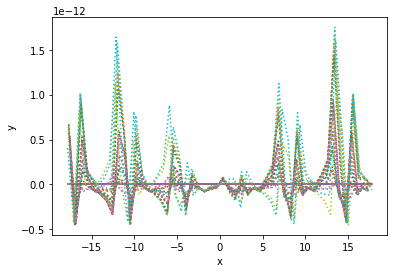

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -8.115940e-13 9.187926e-14
a1        1.678805e-12 1.188165e-13
a10       1.085148e-12 1.164331e-13
a2        1.065791e-12 1.156649e-13
a3        1.479684e-12 1.122669e-13
a4        1.486125e-12 1.174109e-13
a5        1.478795e-12 1.175458e-13
a6        1.456928e-12 1.119418e-13
a7        1.069236e-12 1.167008e-13
a8        1.226567e-12 1.162268e-13
a9        -1.058244e-12 1.178973e-13
b1        -1.930004e-12 9.862391e-14
b10       -1.518656e-12 1.111673e-13
b2        6.400207e-13 1.244807e-13
b3        1.368803e-12 1.187458e-13
b4        4.600392e-13 1.181394e-13
b5        1.255132e-13 1.179362e-13
b6        -8.873195e-13 1.175076e-13
b7        -2.261157e-13 1.227111e-13
b8        1.160685e-12 1.125299e-13
b9        -3.209677e-14 1.229432e-13
w         9.883560e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef058

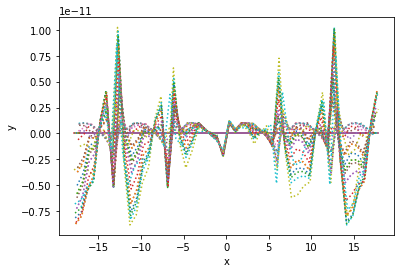

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.837759e-13 5.279797e-14
a1        5.157843e-13 8.126386e-14
a10       -5.746906e-13 6.430232e-14
a2        7.857689e-13 7.544880e-14
a3        2.818557e-14 6.005765e-14
a4        -6.485283e-13 7.439947e-14
a5        -7.306311e-13 7.511492e-14
a6        -1.044283e-13 5.959249e-14
a7        7.925658e-13 7.573520e-14
a8        1.050433e-12 7.873498e-14
a9        8.770984e-14 6.393829e-14
b1        2.265315e-14 7.090604e-14
b10       -5.913472e-13 6.185061e-14
b2        8.461449e-13 7.256691e-14
b3        5.266084e-14 6.072841e-14
b4        -3.624989e-13 6.076490e-14
b5        4.711380e-13 6.013627e-14
b6        2.764713e-14 6.113220e-14
b7        -8.038664e-13 7.209764e-14
b8        -4.627478e-13 6.350317e-14
b9        -1.084688e-14 5.752050e-14
w         9.823497e-01 8.735215e-04
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object at

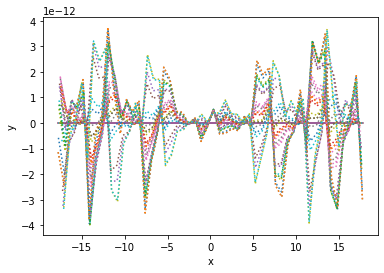

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        9.755899e-14 4.416833e-14
a1        -4.330981e-13 6.783478e-14
a10       -2.363814e-13 5.253944e-14
a2        -1.038672e-13 5.053610e-14
a3        1.447222e-14 5.049780e-14
a4        2.256204e-13 5.363717e-14
a5        2.360487e-13 5.377128e-14
a6        3.787583e-14 5.023228e-14
a7        -1.405473e-13 5.074963e-14
a8        -3.796950e-13 5.378910e-14
a9        8.534741e-14 5.343950e-14
b1        -3.718306e-14 5.936616e-14
b10       8.870808e-13 4.985697e-14
b2        2.230808e-14 5.132585e-14
b3        -2.558065e-13 5.140923e-14
b4        -7.715356e-14 4.818484e-14
b5        1.244577e-13 4.802739e-14
b6        2.162386e-13 5.166221e-14
b7        -1.356376e-14 5.102226e-14
b8        1.082094e-12 4.980280e-14
b9        -6.303619e-13 4.846083e-14
w         9.813260e-01 5.193445e-04
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object a

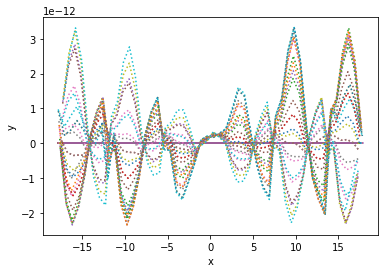

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.179733e-13 4.750544e-14
a1        -6.464852e-13 4.583780e-14
a10       -1.342863e-12 6.919815e-14
a2        -3.857977e-13 6.893369e-14
a3        4.074135e-13 6.962589e-14
a4        9.390975e-13 6.742246e-14
a5        8.671268e-13 6.655328e-14
a6        3.118849e-13 6.928139e-14
a7        -2.492934e-13 6.940118e-14
a8        -1.228983e-12 6.916726e-14
a9        -6.702892e-13 6.722646e-14
b1        -3.200519e-13 6.968884e-14
b10       -5.841748e-13 6.928139e-14
b2        -4.761609e-13 6.994241e-14
b3        -3.709083e-13 6.988733e-14
b4        -2.641918e-13 6.858006e-14
b5        -4.902952e-14 6.864149e-14
b6        8.166261e-14 6.939734e-14
b7        4.114780e-13 6.944281e-14
b8        -2.206261e-13 6.993046e-14
b9        -4.169945e-13 7.198117e-14
w         9.971314e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x

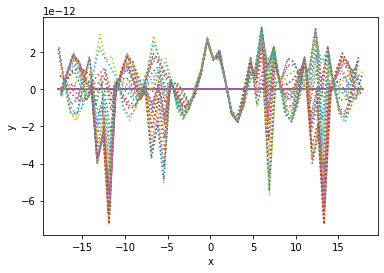

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.015176e-14 5.021732e-15
a1        5.972140e-15 6.858246e-15
a10       2.720916e-14 5.273537e-15
a2        -5.916090e-14 5.179852e-15
a3        -4.806440e-14 5.037356e-15
a4        -4.928106e-14 5.321828e-15
a5        -4.598016e-14 5.346455e-15
a6        -4.562031e-14 5.019705e-15
a7        -7.055546e-14 5.200651e-15
a8        2.911635e-14 5.263279e-15
a9        -5.797808e-14 6.153170e-15
b1        3.590074e-14 6.316577e-15
b10       -7.686852e-15 5.155197e-15
b2        -1.511624e-14 5.065254e-15
b3        9.424630e-15 5.035973e-15
b4        2.424954e-14 4.718980e-15
b5        3.012619e-14 4.684721e-15
b6        3.122267e-14 5.056623e-15
b7        6.530696e-14 5.013129e-15
b8        -2.318047e-14 5.007277e-15
b9        1.039906e-14 4.627174e-15
w         9.800828e-01 7.533170e-04
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object 

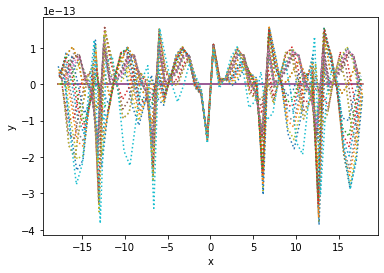

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.419131e-14 2.768061e-14
a1        -2.479626e-13 3.873251e-14
a10       -1.763859e-13 2.936490e-14
a2        -1.645919e-13 2.973816e-14
a3        3.820704e-13 2.684417e-14
a4        -2.020967e-14 3.389956e-14
a5        1.085177e-13 3.413868e-14
a6        4.008075e-13 2.663052e-14
a7        -3.202264e-13 3.097489e-14
a8        9.847509e-14 3.318335e-14
a9        3.339780e-14 3.437057e-14
b1        2.479391e-13 3.611200e-14
b10       2.359451e-13 3.056568e-14
b2        -2.409335e-13 3.115474e-14
b3        -1.720195e-14 3.205388e-14
b4        6.876038e-13 1.233983e-14
b5        -5.442817e-13 8.724154e-15
b6        2.296595e-13 3.277605e-14
b7        2.240702e-13 3.057962e-14
b8        -4.678385e-15 3.229565e-14
b9        3.292164e-14 3.092177e-14
w         9.840973e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef

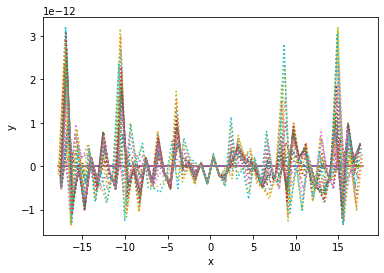

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.699246e-14 1.343058e-14
a1        -2.553908e-13 3.219454e-14
a10       -1.643183e-13 1.643511e-14
a2        -1.182206e-13 1.226180e-14
a3        -5.456202e-14 1.093761e-14
a4        -8.139041e-14 1.167342e-14
a5        -7.174591e-14 1.171112e-14
a6        -5.800158e-14 1.083942e-14
a7        -9.900740e-14 1.227523e-14
a8        -2.080614e-13 2.059801e-14
a9        2.189016e-14 1.620834e-14
b1        -4.788902e-14 1.597308e-14
b10       1.212218e-14 1.092294e-14
b2        6.291313e-14 1.057794e-14
b3        2.016918e-14 1.021898e-14
b4        6.987115e-14 1.058845e-14
b5        -4.305109e-14 1.062702e-14
b6        1.010455e-14 1.029547e-14
b7        -2.897366e-14 1.066888e-14
b8        1.075468e-13 1.160406e-14
b9        -2.500398e-14 9.886142e-15
w         9.798775e-01 1.579680e-03
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares objec

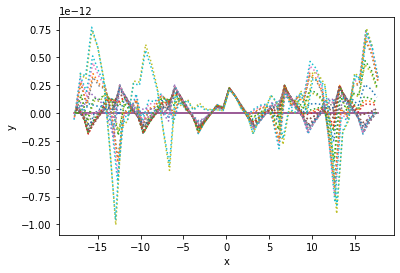

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.440588e-13 4.168263e-14
a1        9.544068e-14 3.768389e-14
a10       -5.215796e-13 5.904411e-14
a2        -4.248186e-13 5.717720e-14
a3        4.249464e-13 5.918755e-14
a4        3.258852e-13 6.037724e-14
a5        -1.255971e-13 5.890733e-14
a6        -9.768811e-14 5.703203e-14
a7        4.377214e-13 5.783550e-14
a8        -7.938615e-13 5.949445e-14
a9        3.251917e-13 5.742964e-14
b1        6.768637e-13 5.287560e-14
b10       -5.082431e-13 5.389713e-14
b2        -2.456477e-14 5.279360e-14
b3        -5.166765e-13 5.813915e-14
b4        -2.468845e-13 5.750319e-14
b5        8.299544e-14 5.773426e-14
b6        1.492295e-13 5.490722e-14
b7        7.781792e-13 5.890191e-14
b8        4.745930e-13 5.491223e-14
b9        5.985333e-14 6.022025e-14
w         9.982273e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

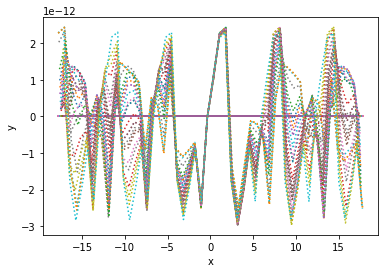

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.757564e-13 2.712499e-14
a1        -5.104271e-13 4.369396e-14
a10       -4.875154e-13 3.519024e-14
a2        -3.609140e-14 2.346380e-14
a3        2.320222e-13 2.784315e-14
a4        9.331585e-14 2.502213e-14
a5        7.101207e-14 2.520698e-14
a6        1.786971e-13 2.850313e-14
a7        -2.274285e-15 2.366429e-14
a8        -1.400522e-13 2.400051e-14
a9        -3.765734e-13 2.809095e-14
b1        3.984507e-13 3.943404e-14
b10       3.124563e-13 2.742674e-14
b2        3.663777e-14 2.390396e-14
b3        3.045140e-13 2.948410e-14
b4        -1.253880e-13 2.481035e-14
b5        1.500769e-13 2.474838e-14
b6        -2.569969e-13 3.003338e-14
b7        2.902596e-14 2.367112e-14
b8        -2.152909e-13 2.482077e-14
b9        -6.192118e-14 2.290754e-14
w         9.840985e-01 9.701260e-04
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object 

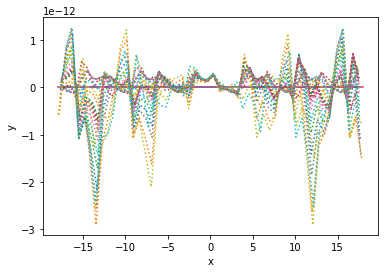

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.011268e-12 9.803088e-14
a1        -2.603693e-12 1.596062e-13
a10       -1.892084e-12 1.262317e-13
a2        2.518501e-13 1.111213e-13
a3        4.470217e-13 1.121841e-13
a4        7.142673e-13 1.182090e-13
a5        6.119192e-13 1.182717e-13
a6        4.099426e-13 1.116856e-13
a7        2.594965e-13 1.116726e-13
a8        -8.892054e-13 1.194878e-13
a9        1.202681e-12 1.164914e-13
b1        7.802481e-13 1.287143e-13
b10       3.741749e-13 1.121059e-13
b2        4.147750e-13 1.135845e-13
b3        2.229649e-12 1.262954e-13
b4        5.800933e-13 1.082187e-13
b5        -3.199417e-13 1.080325e-13
b6        -1.987052e-12 1.270880e-13
b7        -2.597681e-13 1.132386e-13
b8        -4.397112e-13 1.117739e-13
b9        8.457829e-14 1.132751e-13
w         9.819498e-01 6.956410e-04
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object at 0

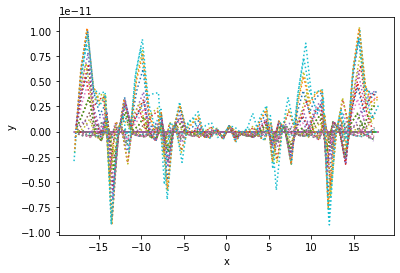

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -6.513103e-17 1.451347e-14
a1        4.491358e-14 2.069145e-14
a10       -2.571696e-14 1.561993e-14
a2        3.457111e-13 1.515995e-14
a3        1.713835e-13 1.441269e-14
a4        -5.026632e-14 1.525370e-14
a5        -5.675216e-14 1.536451e-14
a6        1.564343e-13 1.426570e-14
a7        3.573640e-13 1.527564e-14
a8        6.274021e-14 1.550595e-14
a9        7.913351e-15 1.802005e-14
b1        -2.561376e-13 2.037482e-14
b10       -1.159431e-13 1.528986e-14
b2        -1.573588e-13 1.452438e-14
b3        -1.709088e-14 1.458126e-14
b4        4.965970e-14 1.360633e-14
b5        -7.661960e-14 1.349198e-14
b6        -3.569818e-14 1.469229e-14
b7        1.119206e-13 1.436725e-14
b8        1.799841e-13 1.569546e-14
b9        7.838977e-14 1.252876e-14
w         9.796875e-01 4.295895e-04
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object a

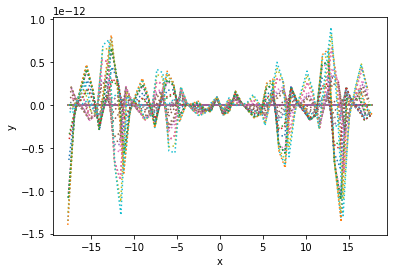

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -6.348307e-14 8.089178e-15
a1        1.192152e-13 1.293980e-14
a10       -2.423898e-14 8.349140e-15
a2        -2.265980e-14 8.151047e-15
a3        -5.482629e-14 8.288222e-15
a4        4.371434e-15 8.441811e-15
a5        2.346825e-14 8.411235e-15
a6        -4.361431e-14 8.374444e-15
a7        -3.850093e-14 8.112266e-15
a8        1.598260e-13 1.080270e-14
a9        -8.437917e-14 9.387641e-15
b1        1.070094e-13 1.044269e-14
b10       -4.961986e-14 8.368474e-15
b2        -2.321362e-14 8.251473e-15
b3        -1.833996e-14 8.223869e-15
b4        5.674486e-14 7.821140e-15
b5        -2.102803e-14 7.924776e-15
b6        3.573312e-14 8.267140e-15
b7        4.782850e-14 8.182226e-15
b8        -4.816199e-14 9.419401e-15
b9        7.558720e-15 8.025536e-15
w         9.819349e-01 9.440261e-04
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object

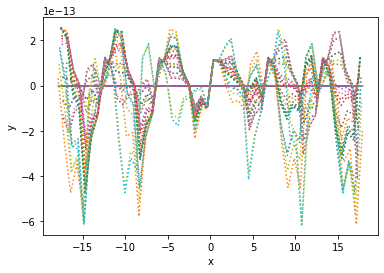

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.732765e-14 nan
a1        2.869624e-14 8.058062e-15
a10       2.226715e-14 7.142994e-15
a2        -4.134522e-14 6.182923e-15
a3        7.249329e-15 7.201285e-15
a4        6.342710e-14 6.033184e-15
a5        5.308303e-14 5.810522e-15
a6        1.329584e-14 7.150961e-15
a7        -4.467742e-14 6.266961e-15
a8        3.687251e-14 7.135182e-15
a9        7.508344e-14 nan
b1        -5.666321e-14 6.418477e-15
b10       -1.544014e-13 nan
b2        2.523748e-14 7.046542e-15
b3        -9.013996e-15 7.245949e-15
b4        9.694215e-14 nan
b5        -1.010807e-13 3.818897e-16
b6        6.872130e-15 7.289819e-15
b7        -3.536351e-14 7.044435e-15
b8        -7.050358e-14 6.301929e-15
b9        -4.851897e-15 6.874263e-15
w         9.845679e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee9396d0>
Minimizer              <symf

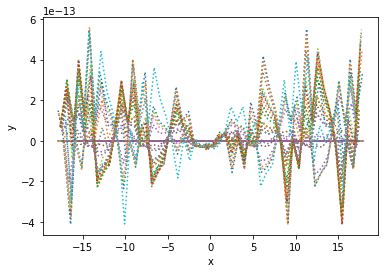

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.735890e-14 5.358339e-15
a1        -6.370670e-14 7.752608e-15
a10       -4.267430e-14 5.694769e-15
a2        -1.074521e-15 5.389899e-15
a3        1.167831e-14 5.411303e-15
a4        1.294707e-13 7.856552e-15
a5        1.296398e-13 7.864881e-15
a6        1.212055e-14 5.373886e-15
a7        7.429422e-15 5.429752e-15
a8        -2.962945e-14 5.797095e-15
a9        -5.058689e-14 6.266514e-15
b1        4.137004e-14 6.889431e-15
b10       1.610319e-14 5.494899e-15
b2        -1.551598e-14 5.511570e-15
b3        9.089701e-14 6.930954e-15
b4        3.429188e-14 5.401399e-15
b5        -3.560478e-14 5.359173e-15
b6        -1.010373e-13 6.901523e-15
b7        6.647344e-15 5.465282e-15
b8        -3.615279e-14 5.472897e-15
b9        2.407244e-14 5.173992e-15
w         9.803139e-01 6.310381e-04
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object a

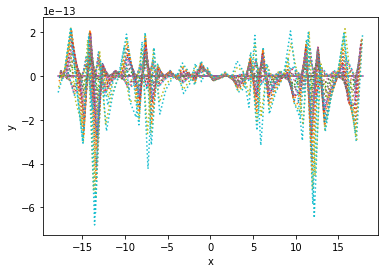

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        6.954747e-14 8.944026e-15
a1        3.930982e-14 1.200379e-14
a10       8.233434e-14 1.230545e-14
a2        5.338966e-14 1.206866e-14
a3        4.425975e-14 1.229179e-14
a4        7.826556e-14 1.257154e-14
a5        5.803765e-14 1.245044e-14
a6        5.634413e-14 1.227913e-14
a7        7.847080e-14 1.228527e-14
a8        9.503573e-14 1.234309e-14
a9        6.350304e-15 1.213571e-14
b1        2.696414e-13 1.127587e-14
b10       8.000970e-14 1.069847e-14
b2        9.879743e-14 1.199002e-14
b3        4.052645e-14 1.103272e-14
b4        -5.755040e-14 1.164710e-14
b5        -1.644212e-13 1.216495e-14
b6        -2.087665e-13 1.212382e-14
b7        -9.204123e-14 1.221742e-14
b8        -2.170795e-14 1.069970e-14
b9        1.716403e-14 1.236096e-14
w         9.980149e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef9288

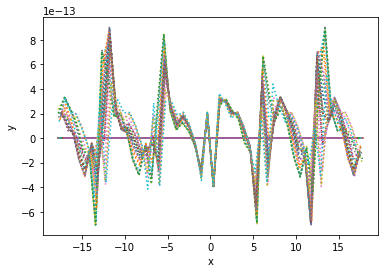

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.883365e-13 1.231220e-13
a1        -3.010238e-12 2.450708e-13
a10       -2.138922e-12 1.628865e-13
a2        -6.280134e-13 1.395199e-13
a3        -1.023360e-12 1.437538e-13
a4        3.818424e-13 1.441571e-13
a5        1.828076e-13 1.445498e-13
a6        -9.482179e-13 1.431262e-13
a7        -5.338894e-13 1.403747e-13
a8        -2.114895e-12 1.631571e-13
a9        7.052646e-13 1.445187e-13
b1        -8.499166e-13 1.696027e-13
b10       -9.167015e-13 1.406066e-13
b2        1.347549e-12 1.528613e-13
b3        8.741605e-13 1.481498e-13
b4        -1.814929e-12 1.522745e-13
b5        1.840215e-12 1.533637e-13
b6        -1.517360e-12 1.475248e-13
b7        -1.569201e-12 1.509456e-13
b8        4.648903e-13 1.370994e-13
b9        -4.691949e-13 1.367198e-13
w         9.818245e-01 8.417395e-04
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares objec

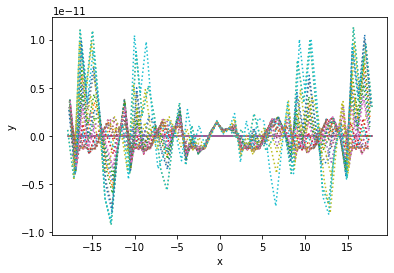

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        7.285777e-14 2.168058e-14
a1        6.276262e-14 3.077692e-14
a10       1.317645e-14 2.655918e-14
a2        -2.254528e-13 2.754958e-14
a3        2.701501e-13 2.808161e-14
a4        -6.902859e-14 2.771878e-14
a5        -9.794225e-14 2.756402e-14
a6        2.743830e-13 2.813252e-14
a7        -2.481154e-13 2.771080e-14
a8        -5.383980e-14 2.701292e-14
a9        8.917423e-14 2.538149e-14
b1        -1.048752e-13 2.975567e-14
b10       -5.563347e-14 2.702004e-14
b2        -6.523573e-13 3.633987e-14
b3        -3.679025e-13 3.054755e-14
b4        -2.247611e-13 2.684904e-14
b5        1.462025e-13 2.667473e-14
b6        3.349871e-13 3.103294e-14
b7        6.452071e-13 3.701786e-14
b8        4.285355e-14 2.672349e-14
b9        -6.315678e-14 2.851281e-14
w         9.835116e-01 7.644476e-04
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object 

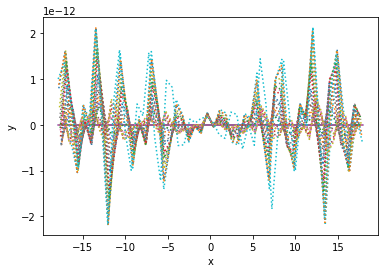

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.059191e-14 1.007832e-14
a1        -5.101021e-14 1.415709e-14
a10       -7.852077e-14 1.409444e-14
a2        4.503043e-15 1.391425e-14
a3        3.612279e-14 1.404490e-14
a4        3.521037e-14 1.429413e-14
a5        5.330418e-14 1.421535e-14
a6        -2.275835e-14 1.403826e-14
a7        1.675180e-14 1.398661e-14
a8        -8.612513e-14 1.410078e-14
a9        2.026320e-15 1.343592e-14
b1        3.080054e-13 1.235998e-14
b10       4.617206e-14 1.352983e-14
b2        -1.396095e-13 1.418727e-14
b3        -8.888966e-14 1.402556e-14
b4        -2.750044e-14 1.364648e-14
b5        -9.438402e-14 1.383870e-14
b6        -4.109573e-14 1.398466e-14
b7        -1.426215e-14 1.389029e-14
b8        -2.665208e-13 1.323423e-14
b9        -1.659325e-13 1.461296e-14
w         9.982631e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

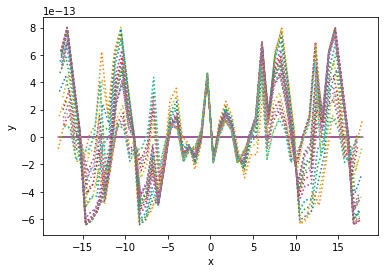

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.980628e-14 1.024120e-14
a1        4.507790e-14 1.376287e-14
a10       -1.144535e-13 1.446512e-14
a2        5.383552e-14 1.390938e-14
a3        1.399481e-13 1.429002e-14
a4        1.480017e-13 1.420533e-14
a5        8.758258e-14 1.356930e-14
a6        2.711798e-14 1.341807e-14
a7        9.495814e-14 1.392776e-14
a8        -7.265103e-14 1.458743e-14
a9        -5.287682e-14 1.427548e-14
b1        -1.921778e-13 1.436154e-14
b10       8.948508e-15 1.349320e-14
b2        -2.670760e-14 1.460225e-14
b3        1.668327e-13 1.426947e-14
b4        2.478788e-13 1.401639e-14
b5        1.137934e-13 1.268497e-14
b6        -7.721772e-14 1.344551e-14
b7        -3.508737e-14 1.449390e-14
b8        -7.454501e-14 1.383507e-14
b9        -9.760300e-14 1.444271e-14
w         9.992005e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeef

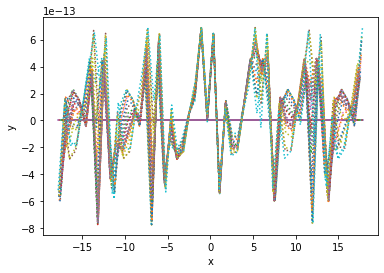

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.082638e-13 1.888178e-14
a1        4.139148e-13 2.947205e-14
a10       7.328036e-14 2.810643e-14
a2        -3.827436e-13 2.839545e-14
a3        -2.582966e-13 2.786568e-14
a4        -3.348190e-13 2.805984e-14
a5        -3.171044e-13 2.809064e-14
a6        -2.900471e-13 2.845823e-14
a7        -1.852799e-13 2.817857e-14
a8        -1.377423e-13 2.802618e-14
a9        3.904990e-13 2.708206e-14
b1        -9.447164e-14 2.785987e-14
b10       -1.802789e-13 2.862617e-14
b2        -1.177865e-14 2.901047e-14
b3        -2.449691e-13 2.885817e-14
b4        -2.323220e-13 2.824483e-14
b5        -1.655109e-13 2.815385e-14
b6        3.412059e-14 2.834304e-14
b7        9.221614e-14 2.895993e-14
b8        1.648070e-13 2.854735e-14
b9        8.203859e-14 2.932905e-14
w         1.001053e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

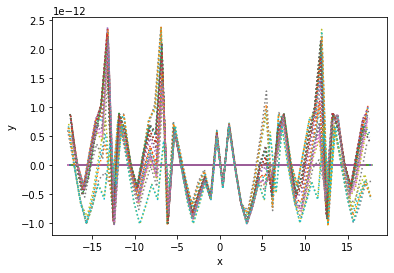

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        2.882057e-13 1.410718e-14
a1        -9.852113e-14 2.958733e-14
a10       -1.598669e-13 2.459893e-14
a2        -1.109801e-13 2.470461e-14
a3        3.847964e-14 2.517033e-14
a4        -2.805773e-13 2.351482e-14
a5        -2.175164e-13 2.305821e-14
a6        -6.581853e-15 2.488949e-14
a7        -6.624223e-14 2.483582e-14
a8        -4.765345e-13 2.575943e-14
a9        2.038577e-13 1.968804e-14
b1        -1.199517e-13 2.839424e-14
b10       -1.440856e-13 2.485531e-14
b2        -2.757297e-14 2.463868e-14
b3        -8.535500e-14 2.522718e-14
b4        -2.115592e-13 2.327535e-14
b5        6.848036e-14 2.270843e-14
b6        1.185024e-14 2.537002e-14
b7        -2.350052e-13 2.504928e-14
b8        2.602433e-14 2.507339e-14
b9        1.483369e-13 2.248471e-14
w         9.848944e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   51
Objective              <symfit.core.objectives.LeastSquares object at 0x7

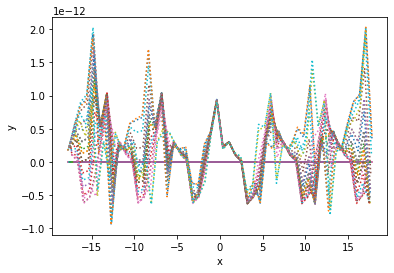

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -5.319515e-14 1.456867e-14
a1        1.919657e-14 2.064643e-14
a10       -5.900571e-15 1.607926e-14
a2        5.377671e-15 1.632659e-14
a3        4.996364e-14 1.610120e-14
a4        -5.076886e-14 1.802817e-14
a5        -1.199522e-13 1.789379e-14
a6        -4.115953e-15 1.600208e-14
a7        4.590183e-14 1.628568e-14
a8        1.535468e-13 1.782987e-14
a9        -4.531025e-14 1.688840e-14
b1        -1.904069e-13 1.883631e-14
b10       -3.801852e-14 1.630507e-14
b2        -5.771462e-14 1.660842e-14
b3        2.449683e-13 2.349816e-14
b4        2.026871e-13 1.897875e-14
b5        -8.990806e-14 1.959201e-14
b6        -1.799791e-13 2.373897e-14
b7        3.181710e-14 1.643933e-14
b8        -1.468759e-13 1.731697e-14
b9        -1.074817e-14 1.702633e-14
w         9.807196e-01 1.546467e-03
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares objec

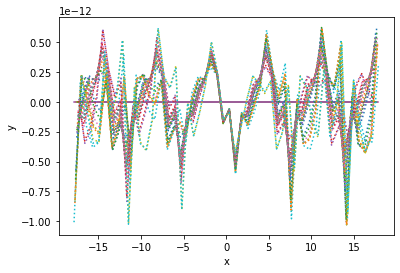

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        6.087498e-14 1.641132e-14
a1        5.540141e-14 2.420184e-14
a10       -5.820854e-14 2.092850e-14
a2        7.640886e-14 2.047573e-14
a3        -1.559836e-13 1.960279e-14
a4        -2.228951e-13 2.096209e-14
a5        -1.035255e-13 2.054256e-14
a6        -2.365611e-13 1.982932e-14
a7        7.369651e-14 2.067590e-14
a8        1.405708e-13 2.096599e-14
a9        1.016604e-13 2.164962e-14
b1        -4.111258e-13 1.349116e-14
b10       -3.631782e-13 1.612553e-14
b2        -1.139097e-13 1.925336e-14
b3        -1.296953e-13 1.841724e-14
b4        9.544327e-14 2.005696e-14
b5        8.294360e-14 2.005936e-14
b6        3.407375e-13 1.979385e-14
b7        2.838938e-13 1.991692e-14
b8        8.321819e-14 1.886013e-14
b9        1.304056e-13 1.988016e-14
w         9.887931e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee

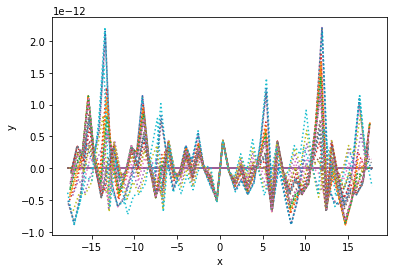

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.094021e-13 1.437183e-14
a1        2.809910e-13 2.010904e-14
a10       1.326381e-13 1.909545e-14
a2        2.056056e-13 2.132092e-14
a3        2.879547e-13 2.071556e-14
a4        2.649352e-13 2.112856e-14
a5        2.508568e-13 2.095914e-14
a6        2.573187e-13 2.043238e-14
a7        -4.378603e-14 2.100936e-14
a8        2.210484e-13 2.076046e-14
a9        2.330503e-13 1.998892e-14
b1        6.447036e-14 2.122797e-14
b10       9.498408e-15 2.133463e-14
b2        -1.100924e-13 2.132324e-14
b3        1.014615e-13 2.134769e-14
b4        1.158857e-14 2.109406e-14
b5        1.002301e-13 2.120335e-14
b6        -1.322395e-13 2.142485e-14
b7        -2.526111e-13 2.157251e-14
b8        1.164506e-13 2.124602e-14
b9        -3.823060e-14 2.157355e-14
w         1.000293e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeeb968

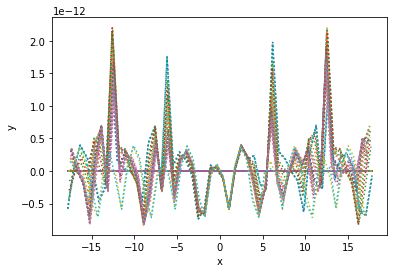

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.454543e-13 2.738236e-14
a1        -8.079441e-13 2.910810e-14
a10       -1.991403e-13 3.171553e-14
a2        2.455862e-13 3.884167e-14
a3        3.362944e-14 4.146756e-14
a4        6.393799e-14 4.388154e-14
a5        -1.149326e-13 4.405106e-14
a6        1.767733e-13 4.147492e-14
a7        4.146649e-13 3.971176e-14
a8        -3.128191e-13 3.325851e-14
a9        -4.223806e-13 3.758157e-14
b1        5.678661e-13 3.962727e-14
b10       2.780043e-13 3.632203e-14
b2        3.705918e-13 4.145357e-14
b3        -5.470310e-14 4.032392e-14
b4        6.530480e-13 3.606490e-14
b5        -3.146545e-13 3.370871e-14
b6        4.661038e-13 4.170857e-14
b7        -8.781973e-14 4.048015e-14
b8        -3.988173e-14 3.848303e-14
b9        9.122765e-14 4.067875e-14
w         9.840040e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7feef

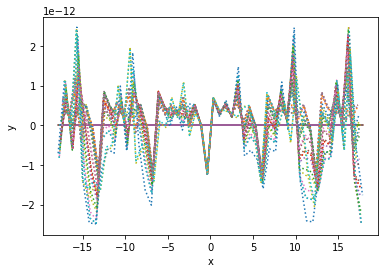

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.298277e-13 2.666043e-14
a1        -3.522650e-13 3.701384e-14
a10       2.192472e-14 3.345947e-14
a2        5.596000e-14 3.349981e-14
a3        -3.769339e-13 3.167830e-14
a4        -1.545146e-13 3.454801e-14
a5        -1.978451e-13 3.472344e-14
a6        -3.531454e-13 3.127475e-14
a7        5.544567e-14 3.380853e-14
a8        -3.516582e-13 3.210036e-14
a9        1.694114e-13 3.451561e-14
b1        2.033917e-13 3.709209e-14
b10       5.831099e-13 3.084260e-14
b2        2.071627e-13 3.358356e-14
b3        1.758478e-13 3.367717e-14
b4        1.046003e-13 3.248435e-14
b5        -6.612918e-14 3.236530e-14
b6        -1.099967e-13 3.386097e-14
b7        -2.233093e-13 3.337573e-14
b8        4.705205e-13 3.276534e-14
b9        -4.119584e-13 3.224122e-14
w         9.856387e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   46
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

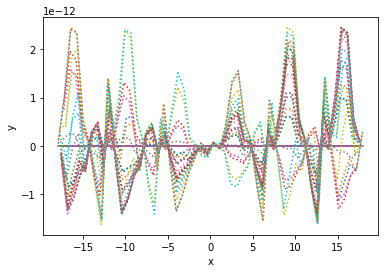

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.964759e-14 1.255894e-14
a1        -6.224612e-14 1.806111e-14
a10       -8.128225e-14 1.598961e-14
a2        -8.267636e-14 1.597716e-14
a3        2.395805e-13 1.432855e-14
a4        -2.133585e-13 1.547354e-14
a5        -2.203396e-13 1.535540e-14
a6        2.750081e-13 1.450932e-14
a7        -1.065996e-13 1.625892e-14
a8        5.723947e-14 1.652333e-14
a9        3.165450e-14 1.674311e-14
b1        8.283481e-14 1.707679e-14
b10       -1.666201e-13 1.607066e-14
b2        -4.688214e-14 1.665403e-14
b3        -1.312064e-13 1.597151e-14
b4        -1.462117e-14 1.594764e-14
b5        -1.545648e-15 1.597890e-14
b6        1.251694e-13 1.601473e-14
b7        -3.351486e-14 1.638142e-14
b8        1.030362e-13 1.584559e-14
b9        6.523759e-14 1.602458e-14
w         9.917505e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

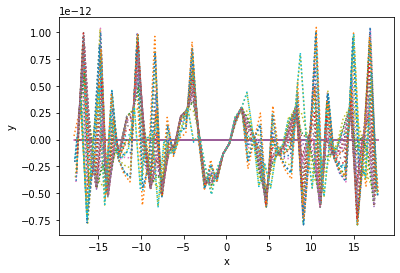

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.202837e-13 3.297056e-14
a1        -7.452484e-13 6.988949e-14
a10       -4.689267e-13 4.694429e-14
a2        -4.202931e-13 3.927064e-14
a3        6.049568e-13 3.978198e-14
a4        1.791281e-13 3.772271e-14
a5        1.234541e-13 3.773514e-14
a6        6.185260e-13 3.929789e-14
a7        -5.015468e-13 3.888782e-14
a8        -5.399790e-13 4.977318e-14
a9        -1.232493e-13 3.979072e-14
b1        -1.167536e-13 4.420875e-14
b10       -1.233230e-13 3.536904e-14
b2        -2.958510e-13 3.580407e-14
b3        -7.485457e-15 3.587081e-14
b4        -1.228972e-13 3.392494e-14
b5        3.459490e-14 3.385106e-14
b6        -7.256179e-14 3.600189e-14
b7        1.468681e-13 3.564233e-14
b8        -2.514704e-14 3.619957e-14
b9        -3.131811e-13 3.309457e-14
w         9.708970e-01 7.061705e-04
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares obj

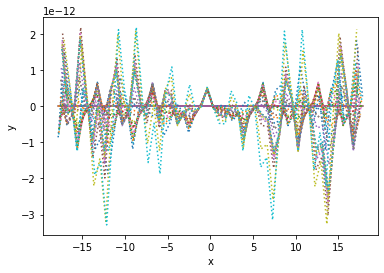

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        4.248940e-14 9.042743e-15
a1        4.417052e-14 1.492566e-14
a10       -9.246687e-14 1.327562e-14
a2        -7.904604e-14 1.260612e-14
a3        -9.171349e-14 1.264656e-14
a4        -3.582115e-14 1.360441e-14
a5        -4.978992e-14 1.363972e-14
a6        -1.166558e-13 1.269628e-14
a7        -1.133409e-13 1.275071e-14
a8        5.713706e-14 1.297891e-14
a9        2.033547e-13 1.381085e-14
b1        -1.872732e-13 1.393134e-14
b10       4.508938e-14 1.230079e-14
b2        1.370060e-13 1.333317e-14
b3        8.708975e-15 1.326071e-14
b4        1.358833e-13 1.248047e-14
b5        -6.537237e-14 1.226981e-14
b6        4.032639e-14 1.336451e-14
b7        -3.385341e-14 1.272703e-14
b8        -3.214258e-14 1.213981e-14
b9        1.280922e-13 1.222640e-14
w         9.911200e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

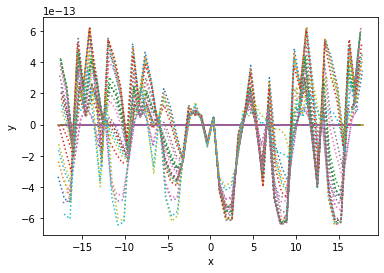

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -9.186984e-15 1.012145e-14
a1        6.142533e-14 8.592116e-15
a10       1.694131e-13 1.409239e-14
a2        1.436914e-14 1.445454e-14
a3        -1.394275e-14 1.478096e-14
a4        -1.524976e-14 1.522198e-14
a5        -1.326654e-14 1.513073e-14
a6        -3.644642e-14 1.478162e-14
a7        -8.645786e-14 1.477806e-14
a8        1.276309e-13 1.420807e-14
a9        7.568310e-14 1.507339e-14
b1        -3.096341e-13 1.302354e-14
b10       2.199343e-13 1.106940e-14
b2        -2.373250e-14 1.455395e-14
b3        8.488177e-14 1.470866e-14
b4        1.951879e-14 1.440969e-14
b5        8.394125e-15 1.450973e-14
b6        -2.743793e-14 1.446084e-14
b7        -1.242022e-13 1.488439e-14
b8        -5.875419e-14 1.136836e-14
b9        1.189457e-14 1.445404e-14
w         9.961830e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

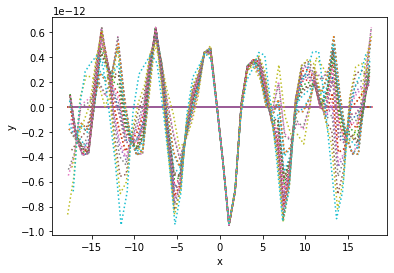

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.749275e-14 1.791341e-14
a1        -2.181400e-13 2.716504e-14
a10       -6.089053e-14 2.019691e-14
a2        -1.907177e-13 2.063490e-14
a3        -7.123435e-14 1.969664e-14
a4        1.551091e-13 2.127769e-14
a5        1.470974e-13 2.139053e-14
a6        -7.511857e-14 1.952645e-14
a7        -1.920316e-13 2.069730e-14
a8        -1.447201e-13 2.097552e-14
a9        -5.675109e-14 2.133095e-14
b1        -4.056595e-13 3.010554e-14
b10       3.071696e-14 1.990806e-14
b2        -3.201378e-14 2.009478e-14
b3        -1.126824e-14 1.979101e-14
b4        7.177365e-15 1.855502e-14
b5        8.595494e-14 1.848237e-14
b6        8.395693e-14 1.990282e-14
b7        8.687839e-14 1.981304e-14
b8        5.133911e-13 2.451198e-14
b9        2.787024e-13 1.923287e-14
w         9.812111e-01 5.607198e-04
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object

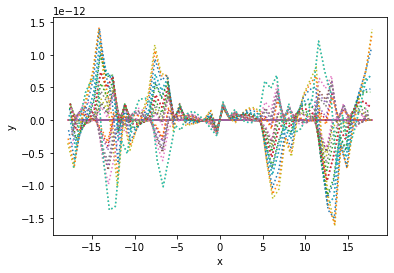

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.028947e-13 1.517837e-14
a1        1.325984e-14 2.142189e-14
a10       -1.464606e-13 1.784968e-14
a2        -1.156508e-13 1.793108e-14
a3        -5.897151e-14 1.779955e-14
a4        -2.875513e-14 1.857616e-14
a5        -6.631838e-15 1.859703e-14
a6        -4.018083e-14 1.774353e-14
a7        -1.218511e-13 1.801497e-14
a8        1.978039e-14 1.805115e-14
a9        1.716326e-13 1.809776e-14
b1        2.025746e-13 2.107874e-14
b10       1.971862e-13 1.773043e-14
b2        4.234146e-14 1.815418e-14
b3        2.457460e-13 1.942163e-14
b4        1.898213e-13 1.808963e-14
b5        -2.711181e-13 1.770333e-14
b6        -2.783788e-13 1.946549e-14
b7        -6.794741e-14 1.819006e-14
b8        -1.773196e-13 1.789541e-14
b9        2.858654e-13 1.830090e-14
w         9.817912e-01 6.622632e-04
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object 

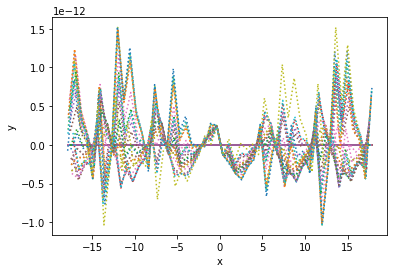

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.409875e-14 5.772005e-15
a1        2.721715e-14 7.948701e-15
a10       6.897631e-14 4.792136e-15
a2        -1.404984e-13 nan
a3        4.834496e-14 6.131059e-15
a4        -9.438816e-15 7.166292e-15
a5        5.521682e-15 7.187061e-15
a6        4.070906e-14 5.849141e-15
a7        -1.253096e-13 nan
a8        -2.998170e-14 6.547710e-15
a9        1.738347e-14 6.805006e-15
b1        4.470782e-14 6.710444e-15
b10       7.984109e-14 4.496458e-15
b2        -1.730766e-14 6.781730e-15
b3        8.207423e-14 nan
b4        -6.417871e-14 5.981392e-15
b5        1.885091e-14 5.479779e-15
b6        -9.699096e-14 nan
b7        2.078666e-14 6.753238e-15
b8        1.776966e-14 6.649550e-15
b9        1.545155e-14 6.642563e-15
w         9.831561e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeeea96250>
Minimizer              <symfi

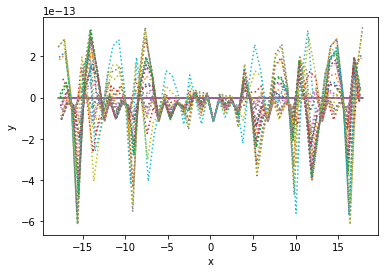

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.502853e-13 5.980336e-14
a1        7.031677e-13 8.922098e-14
a10       2.572723e-13 6.994156e-14
a2        1.108099e-12 7.144643e-14
a3        9.875259e-13 7.062187e-14
a4        7.853062e-13 7.293774e-14
a5        7.534282e-13 7.312541e-14
a6        9.786559e-13 7.022737e-14
a7        1.092015e-12 7.172781e-14
a8        2.841887e-13 7.189473e-14
a9        5.051265e-14 7.256345e-14
b1        -2.174887e-13 8.159432e-14
b10       2.815192e-13 6.782169e-14
b2        3.311314e-13 6.934588e-14
b3        6.292780e-13 7.136237e-14
b4        6.998440e-13 6.701155e-14
b5        -7.994414e-13 6.623169e-14
b6        -8.583299e-13 7.166269e-14
b7        -5.050737e-13 6.911398e-14
b8        4.537221e-13 6.798854e-14
b9        8.993607e-13 6.539369e-14
w         9.790090e-01 5.070286e-04
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

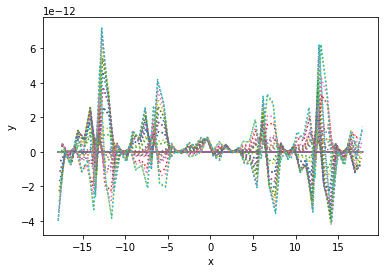

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -5.552176e-13 7.419117e-14
a1        -4.788413e-13 1.404042e-13
a10       4.080667e-13 1.127077e-13
a2        -1.913215e-12 nan
a3        -9.647597e-14 1.121599e-13
a4        -1.613485e-12 4.954916e-14
a5        -1.585288e-12 4.734413e-14
a6        -5.926717e-14 1.111611e-13
a7        -1.945393e-12 nan
a8        -5.784546e-13 1.130942e-13
a9        -6.597408e-13 9.681407e-14
b1        -2.724830e-13 1.210034e-13
b10       -4.792536e-13 1.109711e-13
b2        -1.354163e-12 5.446049e-14
b3        7.242207e-13 9.849169e-14
b4        1.475084e-12 nan
b5        -1.383995e-12 nan
b6        -5.485851e-13 9.592314e-14
b7        1.534252e-12 6.612182e-14
b8        9.213122e-14 1.069905e-13
b9        -3.612004e-13 1.055809e-13
w         9.820598e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee3c3cd0>
Minimizer            

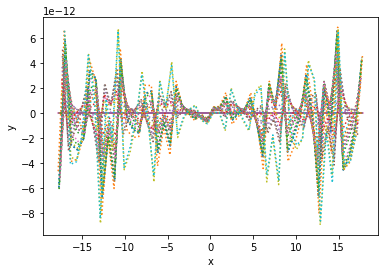

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -3.308957e-16 7.083380e-14
a1        7.746403e-13 1.049192e-13
a10       1.380005e-12 8.060998e-14
a2        9.259984e-14 8.033386e-14
a3        -2.037164e-13 8.018856e-14
a4        -7.398668e-13 8.476870e-14
a5        -9.784991e-13 8.475321e-14
a6        -3.648897e-13 7.981107e-14
a7        1.404102e-13 8.061921e-14
a8        -2.368466e-13 8.393844e-14
a9        2.671096e-13 8.272857e-14
b1        5.279344e-13 9.835694e-14
b10       1.549364e-12 8.048412e-14
b2        -2.725025e-13 8.099349e-14
b3        3.038159e-14 8.128032e-14
b4        -1.255720e-13 7.687982e-14
b5        -3.704972e-13 7.670539e-14
b6        -4.594759e-13 8.159748e-14
b7        -3.352706e-13 8.073177e-14
b8        7.042117e-13 8.105887e-14
b9        -3.349783e-13 7.908123e-14
w         9.776127e-01 4.403365e-04
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object

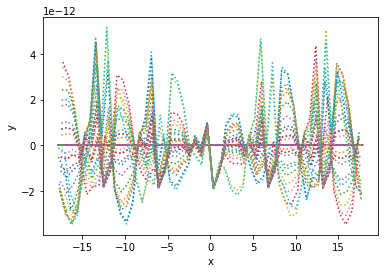

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.058064e-13 8.085643e-14
a1        -1.858402e-13 1.184739e-13
a10       -3.713250e-13 9.775636e-14
a2        -2.121426e-13 9.468433e-14
a3        -1.542564e-12 7.691027e-14
a4        1.236575e-14 1.008946e-13
a5        -1.344659e-13 1.013574e-13
a6        -1.553452e-12 7.633916e-14
a7        -4.013430e-13 9.574642e-14
a8        1.437091e-14 9.976861e-14
a9        -3.464470e-13 1.046139e-13
b1        6.669003e-13 1.084694e-13
b10       -1.169118e-13 9.562882e-14
b2        -7.202803e-13 8.873115e-14
b3        1.866103e-12 7.901149e-14
b4        7.924926e-14 9.125126e-14
b5        7.436270e-13 9.171723e-14
b6        -1.247772e-12 7.469226e-14
b7        1.439162e-12 9.066427e-14
b8        -2.507131e-13 9.388727e-14
b9        -1.894878e-14 9.021734e-14
w         9.854499e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   48
Objective              <symfit.core.objectives.LeastSquares object at 0x7

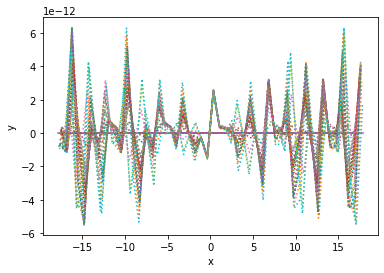

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.118761e-13 5.449716e-14
a1        8.399365e-13 8.876690e-14
a10       1.943644e-15 6.896194e-14
a2        1.038822e-13 6.469327e-14
a3        1.343793e-13 6.527410e-14
a4        4.668991e-13 6.993082e-14
a5        5.058112e-13 6.961343e-14
a6        9.321793e-14 6.494534e-14
a7        -7.828888e-14 6.503676e-14
a8        8.333603e-13 7.193344e-14
a9        -1.180990e-13 6.531001e-14
b1        8.066503e-13 8.998745e-14
b10       -1.969960e-13 6.970022e-14
b2        -3.800114e-15 6.601501e-14
b3        -1.115256e-12 7.478385e-14
b4        -8.399197e-13 6.655354e-14
b5        3.919187e-13 6.765923e-14
b6        7.660251e-13 7.594629e-14
b7        -2.325423e-13 6.550640e-14
b8        -1.027142e-12 7.203600e-14
b9        5.879056e-13 6.644633e-14
w         9.798507e-01 7.519810e-04
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at

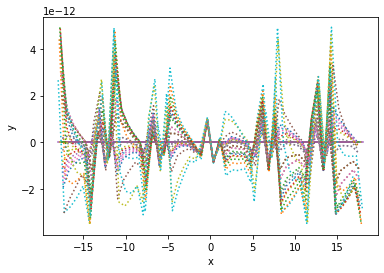

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -9.333213e-14 2.044611e-14
a1        3.613430e-13 2.658972e-14
a10       4.041258e-13 2.698624e-14
a2        -1.276736e-13 2.820325e-14
a3        -2.127361e-13 2.845360e-14
a4        3.055171e-14 2.903118e-14
a5        7.041790e-14 2.895417e-14
a6        -1.108879e-13 2.829927e-14
a7        -1.679770e-13 2.815761e-14
a8        3.093804e-13 2.721396e-14
a9        -7.280331e-14 2.850673e-14
b1        2.709185e-13 2.473271e-14
b10       3.578518e-13 2.659217e-14
b2        2.637063e-14 2.878316e-14
b3        -3.579112e-14 2.837038e-14
b4        -6.300010e-14 2.785393e-14
b5        1.961125e-13 2.808944e-14
b6        2.341493e-13 2.857480e-14
b7        7.508144e-14 2.855597e-14
b8        -4.919720e-13 2.667236e-14
b9        -9.471330e-14 2.813061e-14
w         1.000383e+00 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

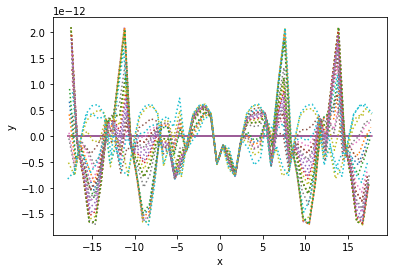

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.090061e-13 2.473529e-14
a1        -2.990409e-13 4.028567e-14
a10       -2.709611e-13 3.381126e-14
a2        1.552166e-13 3.466929e-14
a3        -4.013275e-13 3.265869e-14
a4        2.907613e-13 3.597483e-14
a5        2.090673e-13 3.564039e-14
a6        -4.032649e-13 3.245421e-14
a7        1.696401e-13 3.505069e-14
a8        1.011340e-13 3.593068e-14
a9        4.153657e-13 3.376062e-14
b1        5.326866e-13 3.233137e-14
b10       2.993608e-13 3.222916e-14
b2        -8.117903e-14 3.588621e-14
b3        -1.810699e-13 3.549729e-14
b4        3.634267e-13 2.937557e-14
b5        -5.985711e-13 3.061512e-14
b6        -3.718456e-14 3.563848e-14
b7        -9.721784e-14 3.552594e-14
b8        -2.035019e-13 3.299888e-14
b9        -1.087141e-13 3.409766e-14
w         9.842742e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

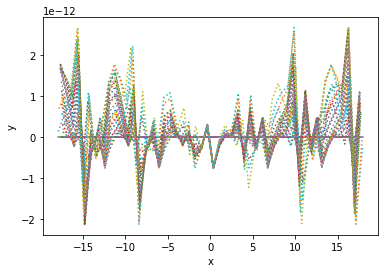

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        6.377308e-13 1.298013e-14
a1        -5.545304e-13 4.940005e-14
a10       -1.200925e-14 4.913006e-14
a2        3.661407e-13 4.578250e-14
a3        -3.622328e-13 4.516266e-14
a4        -1.862784e-13 5.018384e-14
a5        -1.827561e-13 5.042095e-14
a6        -3.161347e-13 4.447672e-14
a7        2.779961e-13 4.587262e-14
a8        -8.248055e-13 3.660906e-14
a9        6.914889e-13 3.092528e-14
b1        4.210000e-13 4.982158e-14
b10       -6.062536e-14 4.845854e-14
b2        -6.476189e-13 3.900056e-14
b3        -3.068208e-13 4.668369e-14
b4        7.182117e-14 4.494382e-14
b5        -3.407855e-13 4.537944e-14
b6        2.165617e-13 4.689889e-14
b7        5.511233e-13 3.697276e-14
b8        -5.287329e-13 3.938120e-14
b9        -1.510250e-13 4.503986e-14
w         9.837744e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

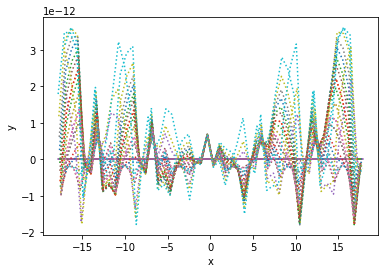

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.845169e-14 9.262199e-15
a1        1.414240e-13 1.319162e-14
a10       -4.410760e-14 1.136286e-14
a2        -1.504910e-14 1.159545e-14
a3        4.644957e-14 1.151148e-14
a4        2.572966e-14 1.221280e-14
a5        -1.006585e-14 1.218805e-14
a6        9.467507e-14 1.152604e-14
a7        -5.757582e-14 1.174989e-14
a8        -5.747413e-16 1.116635e-14
a9        -3.973288e-14 1.208661e-14
b1        -1.451147e-13 1.117574e-14
b10       -1.605034e-14 1.162345e-14
b2        -9.968586e-14 1.125971e-14
b3        9.177332e-14 1.157241e-14
b4        -1.645630e-13 9.462321e-15
b5        2.168586e-13 9.837978e-15
b6        -7.418731e-14 1.160769e-14
b7        1.102426e-13 1.123748e-14
b8        1.422802e-13 1.059364e-14
b9        -1.783900e-14 1.130512e-14
w         9.899114e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

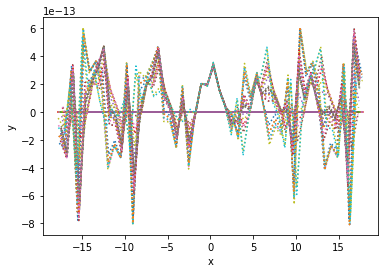

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.310722e-14 6.525456e-15
a1        2.737021e-14 9.177208e-15
a10       -6.631652e-14 9.130899e-15
a2        -3.188640e-14 9.060467e-15
a3        2.064018e-14 9.181684e-15
a4        1.826666e-14 9.417031e-15
a5        1.987475e-15 9.358876e-15
a6        -7.160412e-15 9.115334e-15
a7        -1.073710e-14 9.124271e-15
a8        -6.584634e-14 9.240483e-15
a9        -6.580344e-14 9.385630e-15
b1        1.340847e-13 9.122462e-15
b10       -5.121440e-14 8.375710e-15
b2        -1.328919e-13 8.805066e-15
b3        -1.491786e-13 8.378468e-15
b4        -6.978517e-14 8.771620e-15
b5        3.978591e-14 8.717149e-15
b6        1.014932e-13 7.829721e-15
b7        7.622683e-14 7.915736e-15
b8        5.809631e-14 8.613964e-15
b9        3.713609e-14 8.935273e-15
w         9.954456e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

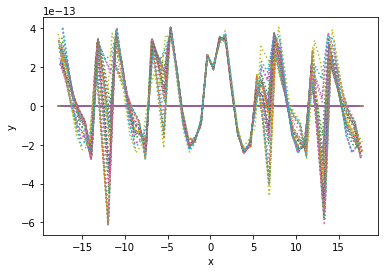

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -9.386769e-13 8.160189e-14
a1        -3.904728e-13 1.359191e-13
a10       1.042154e-12 1.162710e-13
a2        -1.529164e-12 9.769275e-14
a3        -5.975038e-13 1.149202e-13
a4        1.382685e-12 1.073822e-13
a5        1.429675e-12 1.075443e-13
a6        -5.289473e-13 1.139128e-13
a7        -1.526225e-12 9.906112e-14
a8        4.510823e-13 1.139707e-13
a9        -1.282386e-12 1.130506e-13
b1        3.212346e-13 1.277356e-13
b10       3.797578e-13 1.141633e-13
b2        1.291755e-12 1.106170e-13
b3        1.721867e-12 1.017210e-13
b4        -5.345142e-13 1.101247e-13
b5        6.827925e-13 1.105410e-13
b6        -1.297027e-12 1.000430e-13
b7        -9.298796e-13 1.076546e-13
b8        4.020100e-13 1.155291e-13
b9        5.601785e-13 1.124919e-13
w         9.881055e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   39
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

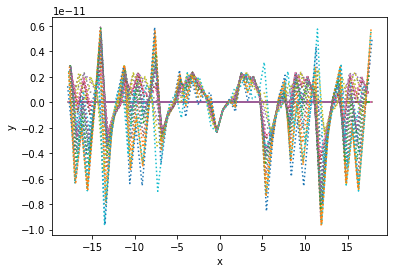

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -7.581980e-14 2.705054e-14
a1        7.927056e-14 3.833061e-14
a10       8.858206e-14 3.435043e-14
a2        3.148226e-13 3.119390e-14
a3        -2.364422e-13 3.375459e-14
a4        2.207467e-13 3.438046e-14
a5        2.470213e-13 3.442850e-14
a6        -2.060316e-13 3.343999e-14
a7        3.212997e-13 3.155083e-14
a8        1.271391e-13 3.451653e-14
a9        -1.615277e-15 3.418680e-14
b1        3.521418e-14 3.707129e-14
b10       -1.168475e-13 3.423216e-14
b2        6.657560e-13 2.425436e-14
b3        4.508121e-13 2.742036e-14
b4        6.030409e-13 2.371853e-14
b5        -4.571373e-13 2.202380e-14
b6        -3.328278e-13 2.551260e-14
b7        -4.752153e-13 1.875415e-14
b8        -8.146526e-14 3.410152e-14
b9        3.197218e-13 3.412892e-14
w         9.864232e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   46
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee

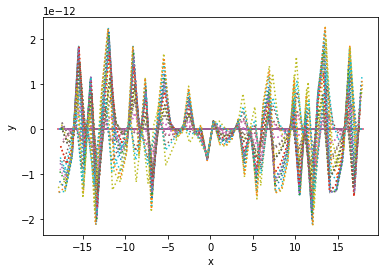

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -4.455843e-13 6.040012e-14
a1        1.049054e-12 9.486727e-14
a10       6.398394e-13 7.503764e-14
a2        -8.606135e-13 7.448196e-14
a3        -8.736982e-13 7.312933e-14
a4        7.603875e-13 7.598696e-14
a5        7.053046e-13 7.607778e-14
a6        -8.033429e-13 7.245747e-14
a7        -8.048970e-13 7.406149e-14
a8        3.485550e-13 7.273543e-14
a9        -6.210679e-13 6.930637e-14
b1        -8.428988e-13 8.694439e-14
b10       -1.203742e-13 7.106079e-14
b2        5.788849e-13 7.164071e-14
b3        -3.135954e-13 6.909018e-14
b4        -7.490784e-14 6.553467e-14
b5        -2.199518e-13 6.530730e-14
b6        5.627406e-14 6.930257e-14
b7        -7.998471e-13 7.160673e-14
b8        6.455004e-13 7.176099e-14
b9        2.801541e-13 7.202207e-14
w         9.804808e-01 6.636779e-04
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object

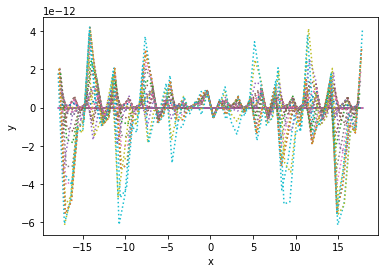

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        3.503421e-13 2.485267e-14
a1        -2.118203e-13 5.552521e-14
a10       -6.677644e-14 5.120389e-14
a2        -2.000400e-13 4.943740e-14
a3        4.967008e-14 5.121480e-14
a4        2.655281e-14 5.312370e-14
a5        -3.337341e-14 5.303755e-14
a6        -1.452314e-13 5.138358e-14
a7        -2.213993e-13 5.036170e-14
a8        -4.506772e-14 5.110329e-14
a9        -9.267335e-13 4.781306e-14
b1        1.466449e-16 9.950790e-15
b10       5.948055e-13 5.077564e-14
b2        -1.372635e-14 5.043387e-14
b3        -2.693853e-13 4.747582e-14
b4        -1.773179e-13 4.920311e-14
b5        1.320296e-13 4.887414e-14
b6        3.352704e-13 4.801470e-14
b7        2.766664e-13 5.135479e-14
b8        -6.324706e-13 5.034152e-14
b9        -1.316689e-13 5.068155e-14
w         9.927974e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

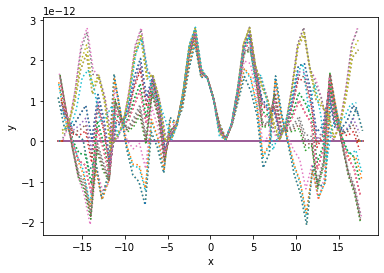

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.696152e-13 9.214288e-14
a1        -1.187758e-12 1.458418e-13
a10       -7.452339e-13 1.147036e-13
a2        5.159453e-13 1.095046e-13
a3        -2.363827e-13 1.079545e-13
a4        1.424603e-12 1.259704e-13
a5        1.404507e-12 1.262934e-13
a6        -1.851799e-14 1.073929e-13
a7        6.857039e-13 1.099614e-13
a8        -5.780585e-13 1.157201e-13
a9        -4.856987e-13 1.108380e-13
b1        -4.662297e-13 1.262173e-13
b10       -1.531934e-12 1.141319e-13
b2        1.446459e-12 1.172534e-13
b3        -1.473361e-12 1.287048e-13
b4        -5.259798e-13 1.076125e-13
b5        7.368202e-13 1.066143e-13
b6        1.710828e-12 1.284494e-13
b7        -8.224291e-13 1.191246e-13
b8        -5.925756e-13 1.064731e-13
b9        8.515399e-13 1.076422e-13
w         9.822191e-01 7.955459e-04
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares objec

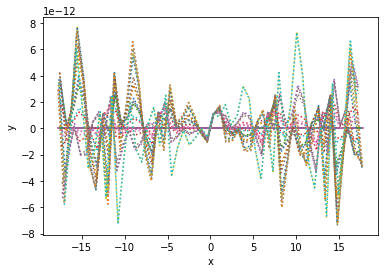

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.116349e-16 5.650069e-14
a1        -9.584777e-13 3.995869e-14
a10       -1.275715e-12 7.191030e-14
a2        -5.461382e-13 7.212249e-14
a3        5.075424e-13 7.182221e-14
a4        -3.312447e-13 7.410182e-14
a5        -4.339475e-13 7.451170e-14
a6        4.387787e-13 7.051868e-14
a7        -1.728743e-13 7.189072e-14
a8        -1.191987e-12 7.335912e-14
a9        -5.009065e-14 7.644785e-14
b1        -1.884656e-13 7.778935e-14
b10       8.293276e-13 7.144976e-14
b2        6.270414e-13 7.169293e-14
b3        -1.995419e-13 7.333573e-14
b4        3.390027e-13 7.078862e-14
b5        -2.390532e-13 7.022280e-14
b6        2.193770e-13 7.364649e-14
b7        -4.984224e-13 7.091270e-14
b8        7.123377e-13 6.585163e-14
b9        1.018790e-12 6.288869e-14
w         9.915226e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

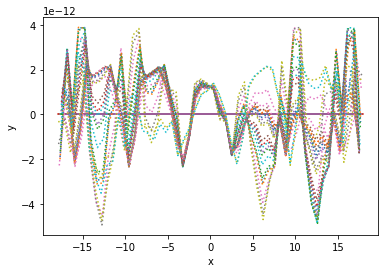

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -2.470956e-13 4.717147e-14
a1        -2.429391e-13 5.960610e-14
a10       3.991636e-13 4.546186e-14
a2        6.956107e-13 6.080182e-14
a3        4.340424e-13 5.388012e-14
a4        -3.143866e-13 5.435079e-14
a5        -3.227960e-13 5.418867e-14
a6        4.272508e-13 5.362556e-14
a7        4.419030e-13 6.248515e-14
a8        1.851440e-14 5.012293e-14
a9        -3.964474e-14 5.559576e-14
b1        5.921042e-13 7.428135e-14
b10       1.555196e-13 4.747250e-14
b2        4.440827e-13 5.255538e-14
b3        6.262593e-15 4.610508e-14
b4        -2.798872e-13 4.648503e-14
b5        2.139771e-13 4.663382e-14
b6        6.483286e-14 4.621256e-14
b7        -3.765441e-13 5.186286e-14
b8        -4.704311e-13 5.697061e-14
b9        -3.279816e-13 4.673771e-14
w         9.809827e-01 1.122030e-03
Status message         Optimization terminated successfully.
Number of iterations   37
Objective              <symfit.core.objectives.LeastSquares object at

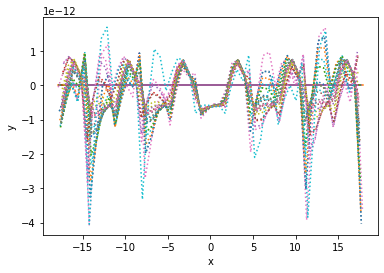

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -3.436293e-13 2.904207e-14
a1        -5.689567e-14 4.468571e-14
a10       -1.254322e-13 3.827506e-14
a2        -5.670835e-14 3.775803e-14
a3        1.553676e-13 3.771201e-14
a4        3.386370e-13 3.745416e-14
a5        3.700648e-13 3.768528e-14
a6        1.674121e-13 3.749858e-14
a7        -5.010902e-14 3.802610e-14
a8        4.176698e-14 3.899354e-14
a9        -8.368584e-14 3.593901e-14
b1        5.259700e-13 4.031569e-14
b10       -2.224230e-13 3.687033e-14
b2        -4.964549e-13 3.721140e-14
b3        4.260121e-13 3.415094e-14
b4        1.143577e-13 3.625416e-14
b5        -1.269896e-13 3.624388e-14
b6        -5.261489e-13 3.472128e-14
b7        3.449596e-13 3.601711e-14
b8        -2.798851e-13 3.449252e-14
b9        3.881455e-13 3.579577e-14
w         9.862595e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   49
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

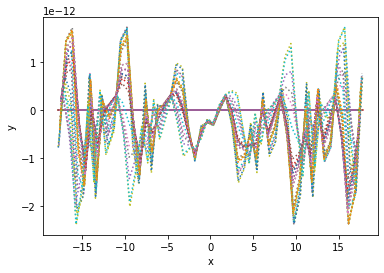

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        5.338636e-13 nan
a1        7.287327e-13 nan
a10       -8.460301e-14 3.061317e-14
a2        1.405493e-14 3.565347e-14
a3        1.751626e-14 3.562070e-14
a4        -1.428124e-13 3.479120e-14
a5        -2.011022e-13 3.544154e-14
a6        -9.072141e-14 3.572794e-14
a7        2.697538e-14 3.598742e-14
a8        7.049011e-13 nan
a9        5.339831e-13 nan
b1        1.328026e-13 3.737049e-14
b10       2.033735e-13 3.161852e-14
b2        -2.052412e-13 3.273978e-14
b3        8.226437e-14 3.617412e-14
b4        -3.919587e-13 nan
b5        4.948188e-13 nan
b6        -4.473398e-14 3.634408e-14
b7        2.089936e-13 3.235427e-14
b8        3.996415e-14 3.572032e-14
b9        3.607798e-13 2.841106e-14
w         9.847024e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee94b7d0>
Minimizer              <symfit.core.minimizers.B

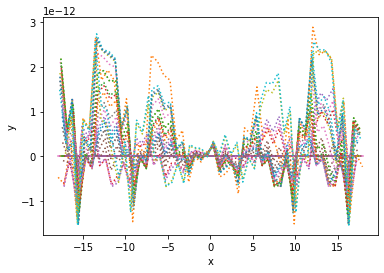

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.109406e-14 9.244714e-15
a1        -3.403634e-14 1.367522e-14
a10       5.841604e-14 1.320100e-14
a2        -5.083616e-14 1.307562e-14
a3        3.697813e-14 1.317250e-14
a4        1.255782e-13 1.305129e-14
a5        1.379366e-13 1.300845e-14
a6        4.849525e-14 1.316317e-14
a7        -3.744098e-14 1.310871e-14
a8        -1.053148e-14 1.314520e-14
a9        -1.340776e-13 1.274199e-14
b1        2.188457e-13 1.209208e-14
b10       6.006339e-14 1.227665e-14
b2        2.590024e-13 1.242321e-14
b3        1.321419e-13 1.292313e-14
b4        5.942181e-14 1.292417e-14
b5        -1.846257e-14 1.283080e-14
b6        -7.471885e-14 1.264514e-14
b7        -1.616826e-13 1.177948e-14
b8        -1.196119e-13 1.258752e-14
b9        -3.377075e-14 1.353107e-14
w         9.986376e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7feee

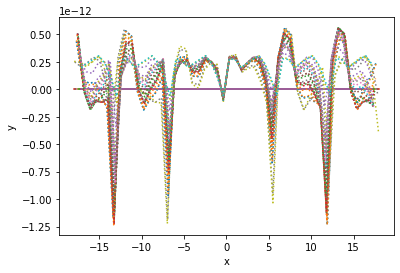

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        2.820980e-13 7.624894e-14
a1        1.274888e-13 7.142477e-14
a10       7.608092e-14 5.794046e-14
a2        -2.019474e-13 8.474065e-14
a3        -2.826381e-15 4.963232e-14
a4        -9.745246e-13 1.367545e-13
a5        -7.189518e-13 1.426617e-13
a6        1.501502e-13 4.879886e-14
a7        -7.059859e-13 7.439973e-14
a8        -2.624104e-14 5.144816e-14
a9        3.651960e-13 8.239430e-14
b1        2.927254e-13 8.230557e-14
b10       1.281457e-13 5.590470e-14
b2        1.918451e-13 6.393588e-14
b3        6.961126e-13 1.321171e-13
b4        6.255524e-13 8.115640e-14
b5        -2.707337e-13 8.737794e-14
b6        -7.763311e-13 1.287169e-13
b7        -2.221900e-13 6.424949e-14
b8        -2.741277e-13 5.946788e-14
b9        -2.639803e-13 5.004399e-14
w         9.806190e-01 2.096104e-03
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object 

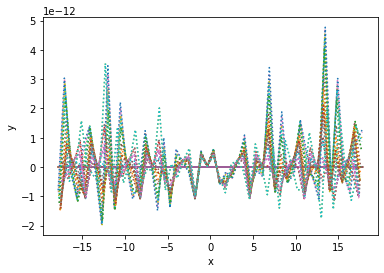

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        1.118500e-13 6.961966e-15
a1        1.084064e-13 1.064562e-14
a10       1.553506e-13 1.064365e-14
a2        -5.399836e-14 1.075552e-14
a3        1.250111e-13 1.027337e-14
a4        -1.030456e-13 1.204420e-14
a5        -3.255774e-14 1.184267e-14
a6        1.481680e-13 1.020907e-14
a7        -1.315855e-13 1.130213e-14
a8        7.909206e-14 1.171142e-14
a9        1.330560e-13 9.669077e-15
b1        9.571493e-15 1.290378e-14
b10       8.736907e-14 1.137346e-14
b2        -9.970013e-14 1.105995e-14
b3        -1.280885e-13 1.141363e-14
b4        -8.556476e-14 1.116448e-14
b5        -1.915336e-14 1.096300e-14
b6        1.685560e-14 1.102760e-14
b7        9.562282e-14 1.091459e-14
b8        6.071063e-14 1.143876e-14
b9        -5.988800e-14 1.141807e-14
w         9.851997e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee

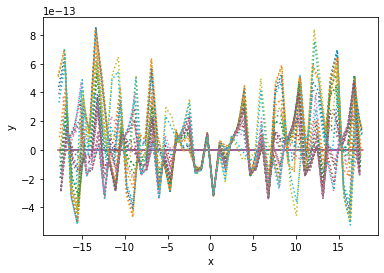

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.479637e-13 5.530031e-14
a1        5.117902e-13 8.968946e-14
a10       3.285550e-13 6.559675e-14
a2        6.015832e-13 7.283072e-14
a3        -4.091202e-13 6.476485e-14
a4        7.705533e-13 8.544676e-14
a5        7.477903e-13 8.596614e-14
a6        -3.422549e-13 6.437777e-14
a7        6.306085e-13 7.286457e-14
a8        1.510589e-13 6.404476e-14
a9        1.323451e-13 6.491108e-14
b1        -6.482559e-14 7.103207e-14
b10       -4.711461e-13 6.419428e-14
b2        -7.841109e-13 8.407706e-14
b3        5.366220e-13 7.107624e-14
b4        -6.070739e-13 6.742231e-14
b5        4.587623e-13 6.779297e-14
b6        -5.108680e-13 7.115119e-14
b7        8.271892e-13 8.405210e-14
b8        -4.264450e-13 6.213457e-14
b9        -6.732961e-13 6.880296e-14
w         9.820143e-01 9.904157e-04
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at

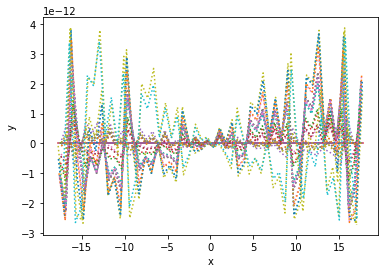

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -9.845850e-13 1.341785e-13
a1        -2.877960e-12 2.577088e-13
a10       -4.346394e-13 1.414883e-13
a2        6.148810e-14 1.384811e-13
a3        7.307072e-13 1.513313e-13
a4        2.428713e-12 2.542503e-13
a5        2.544960e-12 2.532975e-13
a6        7.916812e-13 1.505074e-13
a7        1.305772e-13 1.399170e-13
a8        -2.234525e-12 2.292643e-13
a9        -4.079760e-13 1.652416e-13
b1        -1.955862e-12 2.524065e-13
b10       -1.990404e-12 2.717182e-13
b2        -4.814903e-13 1.469676e-13
b3        6.849836e-13 1.707645e-13
b4        6.144761e-13 1.599251e-13
b5        -9.135196e-13 1.565736e-13
b6        -8.948020e-13 1.698216e-13
b7        3.269527e-13 1.463389e-13
b8        -4.451156e-13 1.413677e-13
b9        -1.004698e-12 1.698751e-13
w         9.828017e-01 1.378812e-03
Status message         Optimization terminated successfully.
Number of iterations   38
Objective              <symfit.core.objectives.LeastSquares object

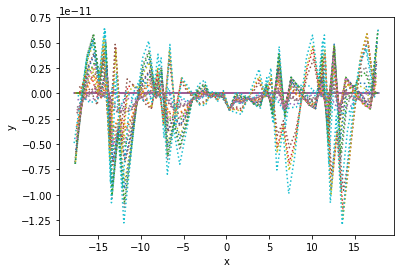

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -1.638749e-13 2.479463e-14
a1        -4.450918e-13 3.803388e-14
a10       1.130235e-13 3.374699e-14
a2        3.704374e-14 3.538984e-14
a3        4.376599e-14 3.585631e-14
a4        -1.789025e-13 3.629268e-14
a5        -2.580155e-13 3.628982e-14
a6        -5.347176e-14 3.565844e-14
a7        9.353890e-14 3.565317e-14
a8        5.176947e-14 3.437089e-14
a9        -2.517668e-13 3.546793e-14
b1        -3.315144e-13 3.537375e-14
b10       5.594702e-13 3.494368e-14
b2        -5.421633e-14 3.574293e-14
b3        -4.262482e-13 3.178959e-14
b4        -3.550473e-13 3.404597e-14
b5        1.563188e-13 3.323255e-14
b6        5.628637e-13 3.251720e-14
b7        1.923260e-13 3.576610e-14
b8        -2.500914e-15 3.425635e-14
b9        1.832592e-13 3.481658e-14
w         9.947503e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

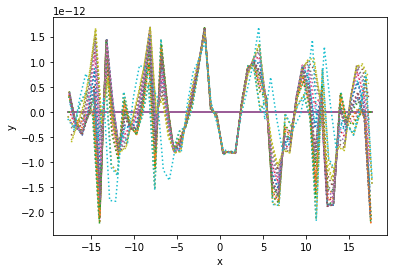

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        7.650780e-14 4.063727e-15
a1        -1.892432e-14 6.686739e-15
a10       3.911520e-14 6.329709e-15
a2        -5.859216e-14 6.257661e-15
a3        -9.048560e-14 5.808408e-15
a4        -6.994632e-14 6.442958e-15
a5        -1.511755e-14 6.309578e-15
a6        -7.414033e-14 5.798667e-15
a7        2.335281e-15 6.206894e-15
a8        6.447712e-14 6.452198e-15
a9        5.966805e-14 5.016837e-15
b1        -5.828551e-14 5.762933e-15
b10       -7.703327e-14 5.888694e-15
b2        -2.844970e-14 6.434144e-15
b3        -4.625010e-14 6.319058e-15
b4        1.077792e-14 6.092121e-15
b5        -1.830874e-14 6.104580e-15
b6        2.615377e-15 6.288764e-15
b7        -2.872032e-14 6.368196e-15
b8        2.346931e-14 6.024503e-15
b9        -2.063589e-14 6.229772e-15
w         9.892351e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   51
Objective              <symfit.core.objectives.LeastSquares object at 0x7f

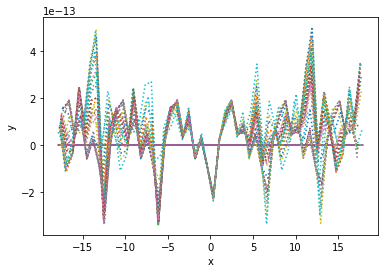

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -6.251585e-15 1.039643e-14
a1        1.091362e-13 1.494545e-14
a10       1.404165e-13 1.237539e-14
a2        1.437576e-13 1.260246e-14
a3        1.556945e-13 1.186470e-14
a4        -1.047178e-13 1.339885e-14
a5        -7.329959e-14 1.327026e-14
a6        1.924473e-13 1.205868e-14
a7        6.975087e-14 1.236960e-14
a8        -1.168645e-13 1.337096e-14
a9        -6.879928e-14 1.397138e-14
b1        3.200602e-14 1.402527e-14
b10       1.681401e-14 1.307948e-14
b2        5.385424e-14 1.250642e-14
b3        3.191262e-14 1.292716e-14
b4        1.336981e-13 1.220110e-14
b5        -8.549069e-14 1.202359e-14
b6        -7.030128e-14 1.308400e-14
b7        -1.811430e-13 1.276414e-14
b8        -9.107579e-14 1.291000e-14
b9        5.618264e-14 1.228367e-14
w         9.880817e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   50
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeee

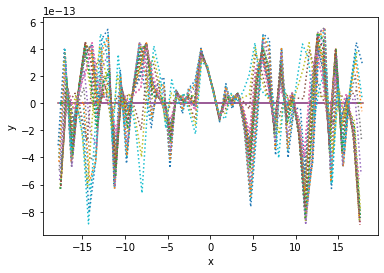

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.051007e-14 3.033696e-15
a1        -2.010964e-16 2.719757e-15
a10       2.979745e-15 2.062353e-15
a2        -3.056429e-15 1.940513e-15
a3        -7.867861e-15 1.988593e-15
a4        -2.196057e-14 2.189995e-15
a5        -2.128752e-14 2.187291e-15
a6        -9.508667e-15 1.976902e-15
a7        -1.005722e-14 1.946667e-15
a8        1.424699e-14 2.082157e-15
a9        4.174939e-14 3.723641e-15
b1        8.072800e-15 2.268461e-15
b10       -1.278321e-15 1.932554e-15
b2        1.349750e-14 1.968377e-15
b3        -3.856558e-15 2.037480e-15
b4        2.143702e-15 1.888252e-15
b5        1.465492e-14 1.861742e-15
b6        1.928316e-14 2.008663e-15
b7        7.675164e-15 1.963839e-15
b8        3.359285e-15 1.935545e-15
b9        1.434605e-14 1.946348e-15
w         9.802969e-01 1.273902e-03
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object at

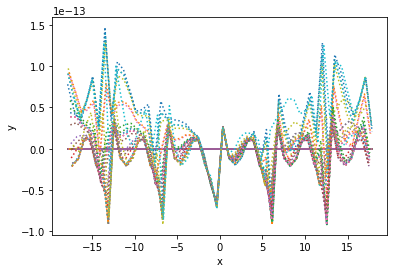

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.383066e-12 1.916947e-13
a1        1.602502e-12 2.410930e-13
a10       5.173349e-13 1.516420e-13
a2        1.417270e-12 1.850374e-13
a3        -8.657476e-13 1.635839e-13
a4        -1.504565e-12 2.040961e-13
a5        -1.524945e-12 2.060218e-13
a6        -1.005809e-12 1.631414e-13
a7        1.175262e-12 1.879969e-13
a8        1.238737e-12 1.854554e-13
a9        1.610930e-12 2.096749e-13
b1        -2.111400e-13 1.686134e-13
b10       3.899684e-13 1.469101e-13
b2        -2.174761e-12 2.406843e-13
b3        -1.596011e-12 1.918519e-13
b4        2.252820e-12 2.369938e-13
b5        -2.171078e-12 2.399553e-13
b6        1.454571e-12 1.954523e-13
b7        2.143019e-12 2.384614e-13
b8        4.740678e-13 1.484031e-13
b9        1.057128e-12 1.587060e-13
w         9.811217e-01 1.260640e-03
Status message         Optimization terminated successfully.
Number of iterations   45
Objective              <symfit.core.objectives.LeastSquares object at 

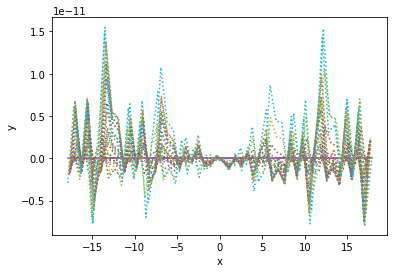

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -3.366752e-14 9.312154e-15
a1        -1.932880e-13 1.389791e-14
a10       3.308825e-14 1.372892e-14
a2        -8.341543e-14 1.335101e-14
a3        5.122292e-14 1.374191e-14
a4        2.777648e-14 1.389800e-14
a5        1.224519e-13 1.416359e-14
a6        6.466207e-14 1.365857e-14
a7        -8.244648e-14 1.346434e-14
a8        -2.053999e-13 1.202123e-14
a9        -2.425972e-13 1.376852e-14
b1        2.273670e-13 1.180781e-14
b10       1.227740e-13 1.273278e-14
b2        -5.716740e-14 1.384503e-14
b3        8.153007e-14 1.371983e-14
b4        8.285651e-14 1.322536e-14
b5        -5.205988e-14 1.316198e-14
b6        -4.827169e-14 1.371354e-14
b7        8.417605e-14 1.372698e-14
b8        -1.054910e-13 1.286368e-14
b9        -1.172536e-13 1.363234e-14
w         9.855936e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   52
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

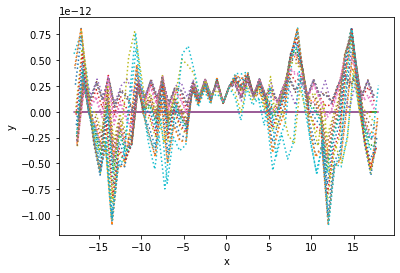

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.881849e-14 4.138009e-15
a1        7.150771e-14 6.120979e-15
a10       8.273563e-15 5.243584e-15
a2        7.762537e-14 5.215390e-15
a3        4.393514e-14 5.133769e-15
a4        -8.825262e-15 5.271820e-15
a5        -1.485696e-14 5.264380e-15
a6        5.735484e-14 5.100616e-15
a7        7.258521e-14 5.218828e-15
a8        3.956229e-14 5.324869e-15
a9        2.151468e-14 4.985726e-15
b1        -2.955899e-14 5.688502e-15
b10       -8.472856e-14 5.086395e-15
b2        -3.009585e-14 5.128586e-15
b3        4.574922e-14 5.134807e-15
b4        -3.527066e-14 4.888277e-15
b5        3.886064e-14 4.903689e-15
b6        -6.358531e-14 5.132908e-15
b7        8.029393e-17 5.114834e-15
b8        -3.858283e-14 5.386717e-15
b9        1.092549e-14 5.400977e-15
w         9.817012e-01 5.438202e-04
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 

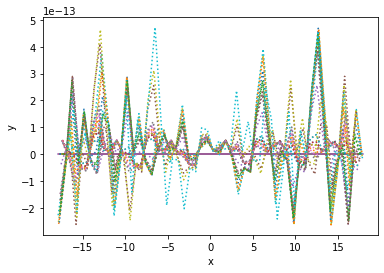

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -3.089885e-13 2.686875e-14
a1        -1.150874e-13 3.882177e-14
a10       -1.346406e-13 3.508021e-14
a2        1.430264e-13 3.380369e-14
a3        1.087632e-13 3.511323e-14
a4        5.118211e-14 3.624893e-14
a5        -1.211440e-15 3.626212e-14
a6        -1.429944e-13 3.483778e-14
a7        3.222491e-13 3.467386e-14
a8        -1.154881e-13 3.559736e-14
a9        9.922491e-14 3.362745e-14
b1        2.881003e-14 3.723824e-14
b10       -2.343224e-13 3.434024e-14
b2        -1.185155e-13 3.550320e-14
b3        1.284412e-13 3.496319e-14
b4        4.803848e-13 3.113607e-14
b5        -4.585515e-13 3.147417e-14
b6        1.587031e-13 3.527085e-14
b7        7.558745e-14 3.506563e-14
b8        -3.616230e-13 3.424569e-14
b9        -5.986980e-13 3.091011e-14
w         9.909340e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object at 0x7fee

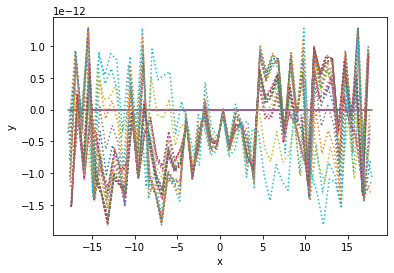

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -4.798398e-13 3.562277e-14
a1        3.512788e-13 5.595694e-14
a10       4.212938e-13 4.508507e-14
a2        -2.192815e-13 4.609508e-14
a3        3.883666e-14 4.776679e-14
a4        -1.759872e-13 4.980534e-14
a5        4.027064e-15 4.974472e-14
a6        -7.239453e-15 4.741387e-14
a7        -2.042437e-13 4.635239e-14
a8        -3.785088e-13 4.871648e-14
a9        -1.200975e-13 4.106227e-14
b1        3.204047e-14 5.113553e-14
b10       3.306426e-13 4.680522e-14
b2        2.152726e-13 4.805285e-14
b3        9.921971e-13 3.676545e-14
b4        -3.652656e-13 4.185126e-14
b5        5.773241e-13 4.278374e-14
b6        -5.675522e-13 3.167676e-14
b7        -8.283534e-14 4.722990e-14
b8        -7.077691e-14 4.696893e-14
b9        -1.687391e-13 4.687716e-14
w         9.857849e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   47
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

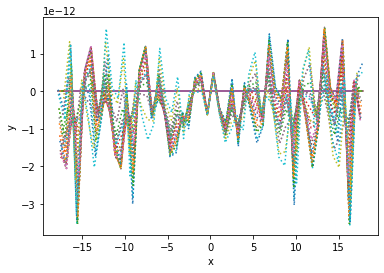

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        3.557226e-13 5.824995e-14
a1        8.153510e-13 8.604187e-14
a10       4.455711e-13 7.087636e-14
a2        3.423130e-13 6.965806e-14
a3        8.038541e-14 6.943784e-14
a4        -6.797362e-13 7.454963e-14
a5        -7.369510e-13 7.462117e-14
a6        1.322864e-14 6.910272e-14
a7        2.570741e-13 6.997548e-14
a8        3.466322e-13 7.293903e-14
a9        4.578696e-13 7.153038e-14
b1        7.526088e-13 8.172943e-14
b10       4.373742e-13 7.100105e-14
b2        1.075710e-12 7.512699e-14
b3        1.137835e-12 7.693658e-14
b4        8.582485e-13 7.037386e-14
b5        -1.002628e-12 6.955365e-14
b6        -1.370113e-12 7.692727e-14
b7        -1.297875e-12 7.459122e-14
b8        -6.979424e-13 7.004291e-14
b9        2.652382e-13 6.967614e-14
w         9.828623e-01 6.578968e-04
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x

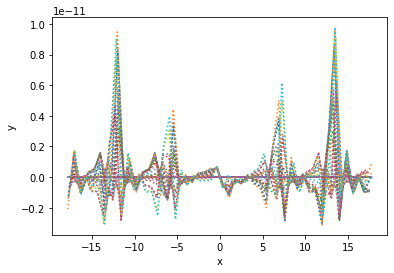

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -2.587482e-13 1.638647e-14
a1        -6.746407e-13 3.246106e-14
a10       -4.076684e-14 2.888624e-14
a2        4.925339e-14 3.165408e-14
a3        2.216499e-13 3.130131e-14
a4        3.145725e-13 3.193896e-14
a5        2.058179e-13 3.160981e-14
a6        2.741632e-13 3.174145e-14
a7        -9.529005e-14 3.194952e-14
a8        2.292336e-14 2.908830e-14
a9        -6.397715e-13 2.763355e-14
b1        4.537613e-14 3.161915e-14
b10       -2.343348e-13 3.196592e-14
b2        -3.582013e-14 3.238414e-14
b3        1.508812e-14 3.173039e-14
b4        1.121933e-14 3.067001e-14
b5        3.312715e-13 3.149146e-14
b6        2.128854e-13 3.211810e-14
b7        4.365906e-14 3.218942e-14
b8        -2.738760e-14 3.181086e-14
b9        7.919757e-15 3.211056e-14
w         9.976578e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   40
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeedf

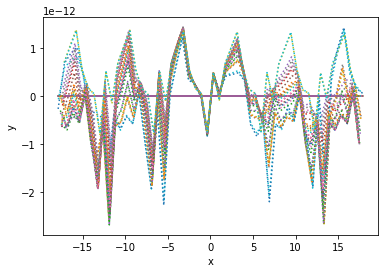

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        4.809606e-13 5.188112e-14
a1        1.435569e-13 7.366030e-14
a10       2.468188e-13 6.985727e-14
a2        -4.043470e-13 6.833313e-14
a3        3.260467e-15 7.117131e-14
a4        3.231786e-13 7.220061e-14
a5        3.122680e-13 7.195134e-14
a6        -1.678155e-13 7.100148e-14
a7        -7.368262e-13 6.976734e-14
a8        1.561724e-13 7.186754e-14
a9        -1.498390e-13 6.955891e-14
b1        4.735846e-13 7.171146e-14
b10       -2.540954e-13 7.114404e-14
b2        1.199912e-12 5.466787e-14
b3        7.314480e-13 6.502999e-14
b4        1.353801e-13 6.905345e-14
b5        -4.065542e-13 6.928792e-14
b6        -9.445975e-13 6.665662e-14
b7        -1.658168e-12 6.123809e-14
b8        1.885125e-13 7.022634e-14
b9        4.536613e-15 6.952977e-14
w         9.965861e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object at 0x7feeedf

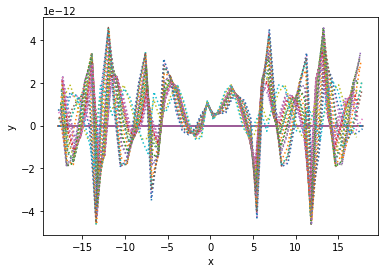

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.982645e-13 4.538728e-14
a1        -1.988809e-13 5.683996e-14
a10       -2.833775e-13 4.685130e-14
a2        -4.815147e-13 4.642111e-14
a3        -1.179270e-14 4.467172e-14
a4        1.853654e-13 4.698784e-14
a5        1.513825e-13 4.717513e-14
a6        1.516770e-15 4.455631e-14
a7        -4.511149e-13 4.651430e-14
a8        2.126557e-13 4.546908e-14
a9        6.364297e-13 5.517234e-14
b1        -1.028050e-13 5.604847e-14
b10       -6.554592e-13 4.809060e-14
b2        6.588306e-13 4.957801e-14
b3        3.484963e-13 4.628341e-14
b4        1.656606e-13 4.341892e-14
b5        -8.597358e-14 4.328522e-14
b6        -1.795231e-13 4.668118e-14
b7        -5.571990e-13 4.990402e-14
b8        -5.414749e-13 4.673411e-14
b9        1.615815e-13 4.194256e-14
w         9.711032e-01 6.895333e-04
Status message         Optimization terminated successfully.
Number of iterations   42
Objective              <symfit.core.objectives.LeastSquares object 

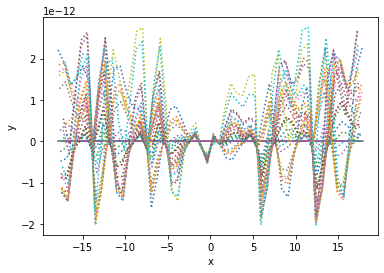

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot
/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:119: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(self.variance(param))



Parameter Value        Standard Deviation
a0        -7.661554e-14 2.446022e-14
a1        -6.294171e-14 3.598919e-14
a10       -3.515363e-13 2.812051e-14
a2        -2.457707e-13 2.797847e-14
a3        2.322805e-13 2.825575e-14
a4        -1.871492e-13 2.955202e-14
a5        -2.102061e-13 2.964462e-14
a6        1.801814e-13 2.776772e-14
a7        -2.115424e-13 2.828942e-14
a8        2.912936e-13 2.933957e-14
a9        -6.462761e-14 3.063681e-14
b1        -6.680864e-14 3.332744e-14
b10       2.940693e-13 2.797389e-14
b2        -2.275593e-13 2.842979e-14
b3        2.897764e-16 2.934568e-14
b4        -4.020178e-13 2.311767e-14
b5        4.109551e-13 2.310332e-14
b6        -5.736286e-14 2.966115e-14
b7        2.074576e-13 2.797508e-14
b8        3.280856e-13 2.676689e-14
b9        3.075126e-13 2.633538e-14
w         9.826102e-01 nan
Status message         Optimization terminated successfully.
Number of iterations   51
Objective              <symfit.core.objectives.LeastSquares object at 0x7fe

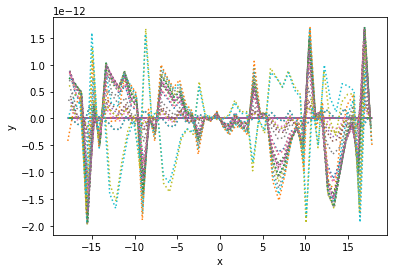

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        5.992759e-14 4.276047e-14
a1        3.010878e-13 6.323761e-14
a10       -2.018113e-13 5.141583e-14
a2        -7.588406e-13 5.994224e-14
a3        -7.421234e-13 5.739314e-14
a4        -7.728379e-13 6.039591e-14
a5        -6.592277e-13 6.115864e-14
a6        -5.680339e-13 5.801111e-14
a7        -8.239374e-13 5.940706e-14
a8        3.347779e-13 5.271154e-14
a9        1.942309e-13 5.090200e-14
b1        2.921050e-13 6.021067e-14
b10       8.386226e-13 5.521231e-14
b2        1.041826e-13 5.093874e-14
b3        1.445646e-13 5.119772e-14
b4        2.448774e-13 5.023692e-14
b5        -4.217138e-13 4.952911e-14
b6        -1.499786e-13 5.163932e-14
b7        2.500947e-14 5.060337e-14
b8        4.182627e-13 4.926283e-14
b9        1.468919e-13 5.023979e-14
w         9.828391e-01 7.307224e-04
Status message         Optimization terminated successfully.
Number of iterations   46
Objective              <symfit.core.objectives.LeastSquares object at

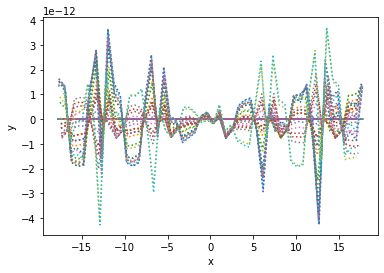

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.264451e-13 6.091274e-14
a1        8.153190e-13 8.843075e-14
a10       4.850406e-13 6.891871e-14
a2        6.122831e-13 6.810711e-14
a3        -8.061509e-15 6.724641e-14
a4        -4.184228e-13 7.152947e-14
a5        -3.473810e-13 7.194249e-14
a6        2.279607e-13 6.666677e-14
a7        3.999452e-13 6.862554e-14
a8        3.569707e-13 6.993585e-14
a9        3.565390e-13 7.483615e-14
b1        1.324585e-12 9.916811e-14
b10       5.209364e-13 7.167485e-14
b2        -4.834455e-13 6.812603e-14
b3        -9.965865e-13 7.247014e-14
b4        -4.267239e-13 6.465251e-14
b5        -2.669332e-13 6.448964e-14
b6        5.041869e-13 7.371380e-14
b7        -2.581147e-13 6.754161e-14
b8        -1.139575e-12 7.698070e-14
b9        -6.854320e-13 6.382282e-14
w         9.788937e-01 6.154917e-04
Status message         Optimization terminated successfully.
Number of iterations   43
Objective              <symfit.core.objectives.LeastSquares object a

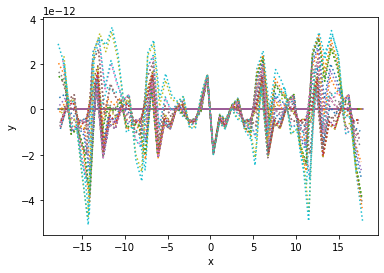

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        4.310024e-13 9.667533e-14
a1        -2.417121e-12 1.574053e-13
a10       -1.805082e-12 1.171342e-13
a2        6.753259e-13 1.049948e-13
a3        9.928366e-13 1.055457e-13
a4        -6.844247e-13 1.092560e-13
a5        -6.185988e-13 1.096101e-13
a6        9.659620e-13 1.048694e-13
a7        6.425488e-13 1.057161e-13
a8        -7.380872e-13 1.084403e-13
a9        4.351532e-13 1.129120e-13
b1        -4.459611e-13 1.342647e-13
b10       -8.253156e-13 1.073512e-13
b2        -4.446953e-13 1.037140e-13
b3        1.685446e-12 1.128546e-13
b4        9.727865e-13 1.008030e-13
b5        -8.204366e-13 1.006596e-13
b6        -1.401443e-12 1.129769e-13
b7        5.554674e-13 1.029268e-13
b8        -2.844428e-13 1.018602e-13
b9        -5.558680e-13 9.686158e-14
w         9.781862e-01 4.516754e-04
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object

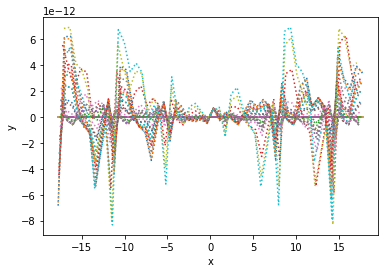

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        -3.181330e-13 3.509868e-14
a1        2.879596e-13 4.865352e-14
a10       3.168399e-13 3.930906e-14
a2        -2.415814e-13 3.979863e-14
a3        -5.118272e-13 4.323759e-14
a4        3.280503e-14 4.031059e-14
a5        9.776927e-15 4.048089e-14
a6        -5.563747e-13 4.260908e-14
a7        -2.513245e-13 4.015093e-14
a8        2.611542e-13 3.970621e-14
a9        -4.958139e-13 4.183459e-14
b1        1.276755e-13 4.325799e-14
b10       -6.019573e-14 3.829209e-14
b2        -6.076721e-13 4.627115e-14
b3        2.537053e-13 3.911949e-14
b4        1.435252e-14 3.706994e-14
b5        1.841083e-13 3.682104e-14
b6        -2.936696e-14 3.971219e-14
b7        7.680982e-13 4.529215e-14
b8        -2.721962e-14 3.832744e-14
b9        3.576317e-14 3.778541e-14
w         9.795104e-01 1.110680e-03
Status message         Optimization terminated successfully.
Number of iterations   41
Objective              <symfit.core.objectives.LeastSquares object a

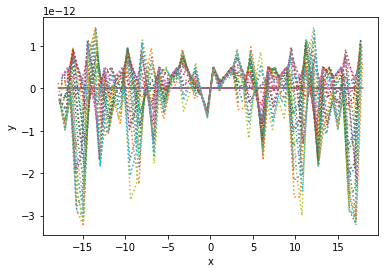

{y: a0 + a1*cos(w*x) + a10*cos(10*w*x) + a2*cos(2*w*x) + a3*cos(3*w*x) + a4*cos(4*w*x) + a5*cos(5*w*x) + a6*cos(6*w*x) + a7*cos(7*w*x) + a8*cos(8*w*x) + a9*cos(9*w*x) + b1*sin(w*x) + b10*sin(10*w*x) + b2*sin(2*w*x) + b3*sin(3*w*x) + b4*sin(4*w*x) + b5*sin(5*w*x) + b6*sin(6*w*x) + b7*sin(7*w*x) + b8*sin(8*w*x) + b9*sin(9*w*x)}


/usr/local/lib/python3.7/dist-packages/symfit/core/fit_results.py:282: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - SS_res/SS_tot



Parameter Value        Standard Deviation
a0        1.707297e-13 2.486413e-14
a1        9.633591e-14 3.486943e-14
a10       1.820084e-13 2.688219e-14
a2        -2.596997e-13 2.631105e-14
a3        -2.915949e-13 2.624434e-14
a4        -3.441106e-13 2.734468e-14
a5        -3.311393e-13 2.741512e-14
a6        -3.084305e-13 2.596015e-14
a7        -3.111255e-13 2.653705e-14
a8        -2.136121e-14 2.662185e-14
a9        1.593955e-13 3.059874e-14
b1        -2.893381e-13 3.302993e-14
b10       -1.394516e-13 2.590637e-14
b2        1.926841e-13 2.542319e-14
b3        -3.552105e-13 2.714997e-14
b4        -1.892907e-13 2.455377e-14
b5        2.917856e-13 2.427745e-14
b6        4.033290e-13 2.721393e-14
b7        -3.220938e-14 2.528256e-14
b8        2.749915e-13 2.606050e-14
b9        1.224900e-13 2.280880e-14
w         9.794086e-01 5.472152e-04
Status message         Optimization terminated successfully.
Number of iterations   44
Objective              <symfit.core.objectives.LeastSquares object

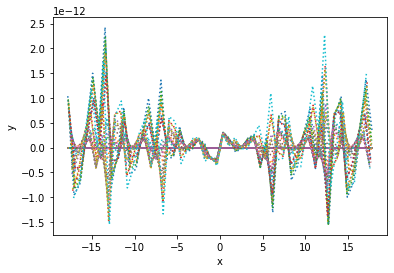

In [160]:
for i in range (0,100):
  x2, y2 = variables('x, y')
  w2, = parameters('w')
  model_dict2 = {y: fourier_series(x2, f=w2, n=10)} #n was calculated selecting the best one
  print(model_dict2)

  # Make step function data
  xdata2 = np.linspace(-d3[i], d3[i])
  ydata2 = np.zeros_like(xdata2)
  #ydata[xdata2 > 0] = 1
  # Define a Fit object for this model and data
  fit2 = Fit(model_dict2, x=xdata2, y=ydata2)
  fit_result2 = fit2.execute()
  print(fit_result2)

  # Plot the result
  plt.plot(xdata2, ydata2)
  plt.plot(xdata2, fit2.model(x=xdata2, **fit_result2.params).y, ls=':')
  plt.xlabel('x')
  plt.ylabel('y')
  plt.show()

# Conclusions 
The most challenging part was to implement the Fourier function to my code, I made used of the symfit library and the I started to play with the different models of the file until I realized that I need to change the values of 

 - xdata2 = np.linspace(-d3[i], d3[i])
 - ydata2 = np.zeros_like(xdata2)

to generate the plots for each dataset

# References
https://symfit.readthedocs.io/en/stable/module_docs.html

https://symfit.readthedocs.io/en/stable/search.html?q=-np.pi&check_keywords=yes&area=default 